# Capstone Project - The Battle of the Neighborhoods (Week 2)
### Applied Data Science Capstone by IBM/Coursera

## Table of contents
* [Introduction: Business Problem](#introduction)
* [Data](#data)
* [Methodology](#methodology)
* [Analysis](#analysis)
* [Results and Discussion](#results)
* [Conclusion](#conclusion)

# Introduction: Business Problem <a name="introduction"></a>

In this project we will try to find an optimal location for an **Indian restaurant**. Specifically, this report will be targeted to stakeholders interested in opening an Indian restaurant in **New York City (NYC)**.

Since there are lots of restaurants in NYC we will try to detect **locations that are not already crowded with restaurants**. We are also particularly interested in **areas with no Indian restaurants in vicinity**. We would hope that the place would also be frequently visited by Indians. We would also prefer locations **as close to city center as possible**, assuming that first three conditions are met.

We will methodologically analyze and filter a set of most promissing neighborhoods based on these criteria. Advantages of each area will then be clearly expressed so that best possible final location can be chosen by stakeholders.

# Data <a name="data"></a>

Based on definition of our problem, factors that will influence our decission are:
* number of existing restaurants in the neighborhood (any type of restaurant)
* number of and distance to Indian restaurants in the neighborhood, if any
* number of people staying or visiting the neighobours
* distance of neighborhood from city center

We decided to use regularly spaced grid of locations, centered around city center, to define our neighborhoods.

Following data sources will be needed to extract/generate the required information:
* New York City data that contains list Boroughs, Neighborhoods along with their latitude and longitude. (https://cocl.us/new_york_dataset & data.cityofnewyork.us)
* number of restaurants and their type and location in every neighborhood will be obtained using **Foursquare API**

# Methodology 

In this project we will analyze and recommend good locations in New York City to start an Indian Restaurant. These locations should have low restaurant density, particularly those with low number of Indian restaurants. We will limit our analysis to area ~1k.m around city center.

In first step we have collected the required **data: location and type (category) of every restaurant within 1km from each Neighborhood center**. We have also **identified Indian restaurants** (according to Foursquare categorization).

Second step in our analysis will be calculation and exploration of '**restaurant density**' across different areas of NYC.

In third and final step we will focus on most promising areas and within those create **clusters of locations that meet some basic requirements**. We will present map of all such locations but also create clusters (using **k-means clustering**) of those locations to identify general zones / neighborhoods / addresses which should be a starting point for final 'street level' exploration and search for optimal venue location by businessmen interested in setting up Indian restaurants.

1. We begin by collecting the New York city data from "https://cocl.us/new_york_dataset".
2. We will find all venues for each neighborhood using FourSquare API.
3. We will then filter out all Indian Restuarant venues.
4. Next using FourSquare API, we will find the Ratings, Tips, and Like count for all the Indian Resturants.
5. Next we will sort the data keeping Ratings as the constraint.
6. Finally, we will visualize the Ranking of neighborhoods using python's Folium library.

# Analysis 

## Environmental Setup 

In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import requests
from bs4 import BeautifulSoup
!pip install geocoder
import geocoder
import os
!pip install folium
import folium # map rendering library
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values
# Matplotlib and associated plotting modules
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
%matplotlib inline

     |████████████████████████████████| 102kB 9.6MB/s eta 0:00:01
     |████████████████████████████████| 102kB 9.3MB/s ta 0:00:011


## Usable Functions 

In [2]:
#Drive location function
def geo_location(address):
    # get geo location of address
    geolocator = Nominatim(user_agent="ny_explorer")
    location = geolocator.geocode(address)
    latitude = location.latitude
    longitude = location.longitude
    return latitude,longitude

In [34]:
#Fourquare API function

def get_venues(lat,lng):
    
    #set variables
    radius=1000
    LIMIT= 100
    CLIENT_ID = "LBHM4WOAZNMPP2HZMZ3W4LAITS2BAOQYHT1DLTMQR1ZPQ04V" # your Foursquare ID
    CLIENT_SECRET = "ELP0MDWUOHWJFTZ1H00WPWF4GPKSZAFT2IR1QRIPFUMIINVJ" # your Foursquare Secret
    VERSION = '20200401' # Foursquare API version
    
    #url to fetch data from foursquare api
    url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
    try:
        
        # get all the data
        results = requests.get(url).json()

        venue_data=results["response"]['groups'][0]['items']
        print(venue_data)
        
        venue_details=[]
        for row in venue_data:
            try:
                venue_id=row['venue']['id']
                venue_name=row['venue']['name']
                venue_category=row['venue']['categories'][0]['name']
                venue_details.append([venue_id,venue_name,venue_category])
            except KeyError:
                pass

        column_names=['ID','Name','Category']
        df = pd.DataFrame(venue_details,columns=column_names)
        return df
    except:
        pass

In [4]:
#New York City Information

def get_new_york_data():
    url='https://cocl.us/new_york_dataset'
    resp=requests.get(url).json()
    # all data is present in features label
    features=resp['features']
    
    # define the dataframe columns
    column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 
    # instantiate the dataframe
    new_york_data = pd.DataFrame(columns=column_names)
    
    for data in features:
        borough = data['properties']['borough'] 
        neighborhood_name = data['properties']['name']
        
        neighborhood_latlon = data['geometry']['coordinates']
        neighborhood_lat = neighborhood_latlon[1]
        neighborhood_lon = neighborhood_latlon[0]
    
        new_york_data = new_york_data.append({'Borough': borough,
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)
    
    return new_york_data

In [6]:
#New York City Population Information 

!pip install sodapy
from sodapy import Socrata

def get_nyc_pop_data():
    client = Socrata("data.cityofnewyork.us", None)

    # dictionaries by sodapy.
    results = client.get("swpk-hqdp")

    # Convert to pandas DataFrame
    results_df = pd.DataFrame.from_records(results)

    return results_df

In [35]:
# The following function retrieves the venues given the names and coordinates and stores it into dataframe.
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    #set variables
    radius=1000
    LIMIT= 100
    CLIENT_ID = "LBHM4WOAZNMPP2HZMZ3W4LAITS2BAOQYHT1DLTMQR1ZPQ04V" # your Foursquare ID
    CLIENT_SECRET = "ELP0MDWUOHWJFTZ1H00WPWF4GPKSZAFT2IR1QRIPFUMIINVJ" # your Foursquare Secret
    VERSION = '20200401' # Foursquare API version
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
        
        try:
            # make the GET request
            results = requests.get(url).json()["response"]['groups'][0]['items']

            # return only relevant information for each nearby venue
            venues_list.append([(
                name, 
                lat, 
                lng, 
                v['venue']['name'], 
                v['venue']['location']['lat'], 
                v['venue']['location']['lng'],  
                v['venue']['categories'][0]['name']) for v in results])
        except:
            pass
        
    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighbourhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    
    return(nearby_venues)

## Data Extraction 

### Extracting NY location data 

In [8]:
new_york_data=get_new_york_data()
print(new_york_data.shape)

(306, 4)


In [9]:
new_york_data.head()

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585


### Extracting NY population data  

In [10]:
nyc_pop_data = get_nyc_pop_data()
nyc_pop_data.head()

,borough,fips_county_code,nta_code,nta_name,population,year
0,Bronx,005,BX01,Claremont-Bathgate,28149,2000
1,Bronx,005,BX03,Eastchester-Edenwald-Baychester,35422,2000
2,Bronx,005,BX05,Bedford Park-Fordham North,55329,2000
3,Bronx,005,BX06,Belmont,25967,2000
4,Bronx,005,BX07,Bronxdale,34309,2000


### Extracting Indian Restaurant in NY

In [36]:
# prepare neighborhood list that contains indian resturants
column_names=['Borough', 'Neighborhood', 'ID','Name']
indian_rest_ny=pd.DataFrame(columns=column_names)
count=1
for row in new_york_data.values.tolist():
    Borough, Neighborhood, Latitude, Longitude=row
    venues = get_venues(Latitude,Longitude)
    try:
        indian_resturants=venues[venues['Category']=='Indian Restaurant']   
        print('(',count,'/',len(new_york_data),')','Indian Resturants in '+Neighborhood+', '+Borough+':'+str(len(indian_resturants)))
        for resturant_detail in indian_resturants.values.tolist():
            id, name , category=resturant_detail
            indian_rest_ny = indian_rest_ny.append({'Borough': Borough,
                                                    'Neighborhood': Neighborhood, 
                                                    'ID': id,
                                                    'Name' : name
                                                   }, ignore_index=True)
        count+=1
    except:
        continue

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c537892fd2ea593cb077a28', 'name': 'Lollipops Gelato', 'location': {'address': '4120 Baychester Ave', 'crossStreet': 'Edenwald & Bussing Ave', 'lat': 40.894123150205274, 'lng': -73.84589162362325, 'labeledLatLngs': [{'label': 'display', 'lat': 40.894123150205274, 'lng': -73.84589162362325}, {'label': 'entrance', 'lat': 40.89362, 'lng': -73.843737}], 'distance': 127, 'postalCode': '10466', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['4120 Baychester Ave (Edenwald & Bussing Ave)', 'Bronx, NY 10466', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1d0941735', 'name': 'Dessert Shop', 'pluralName': 'Dessert Shops', 'shortName': 'Desserts', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/dessert_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': [

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '524b6ca6498e92aa03e03ff4', 'name': 'Dumplin Shop', 'location': {'address': '1530 E 222nd St', 'lat': 40.876042191838856, 'lng': -73.83595004760689, 'labeledLatLngs': [{'label': 'display', 'lat': 40.876042191838856, 'lng': -73.83595004760689}, {'label': 'entrance', 'lat': 40.875906, 'lng': -73.836173}], 'distance': 542, 'postalCode': '10469', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1530 E 222nd St', 'Bronx, NY 10469', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d108941735', 'name': 'Dumpling Restaurant', 'pluralName': 'Dumpling Restaurants', 'shortName': 'Dumplings', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/dumplings_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-524b6ca6498e92aa03e03ff4-0'}, {'reas

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '515cc20ce4b0deb133b8e89b', 'name': 'Fish & Ting', 'location': {'address': '4063 Boston Rd', 'lat': 40.885656, 'lng': -73.829197, 'labeledLatLngs': [{'label': 'display', 'lat': 40.885656, 'lng': -73.829197}, {'label': 'entrance', 'lat': 40.885608, 'lng': -73.829175}], 'distance': 241, 'postalCode': '10466', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['4063 Boston Rd', 'Bronx, NY 10466', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d144941735', 'name': 'Caribbean Restaurant', 'pluralName': 'Caribbean Restaurants', 'shortName': 'Caribbean', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/caribbean_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-515cc20ce4b0deb133b8e89b-0'}, {'reasons': {'count': 0, 'items': [{'summ

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49e33171f964a5206a621fe3', 'name': 'Wave Hill', 'location': {'address': '675 W 252nd St', 'crossStreet': 'Independence Ave', 'lat': 40.900062189494726, 'lng': -73.9124461576627, 'labeledLatLngs': [{'label': 'display', 'lat': 40.900062189494726, 'lng': -73.9124461576627}, {'label': 'entrance', 'lat': 40.898986, 'lng': -73.912341}], 'distance': 769, 'postalCode': '10471', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['675 W 252nd St (Independence Ave)', 'Bronx, NY 10471', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d15a941735', 'name': 'Garden', 'pluralName': 'Gardens', 'shortName': 'Garden', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/garden_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '42685085'}

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c268383136d20a15a83e561', 'name': 'Riverdale Ave', 'location': {'lat': 40.890424929507866, 'lng': -73.91024841803598, 'labeledLatLngs': [{'label': 'display', 'lat': 40.890424929507866, 'lng': -73.91024841803598}], 'distance': 201, 'postalCode': '10463', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Bronx, NY 10463', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d164941735', 'name': 'Plaza', 'pluralName': 'Plazas', 'shortName': 'Plaza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/plaza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c268383136d20a15a83e561-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4af8b2c0f964a520460f22e3', 'name': 'Garden Gourmet Market', 'location': {'address': '5665 Broadway', 'crossStreet': 'btwn W 233rd & W 234th St', 'lat': 40.88135023917183, 'lng': -73.90338943716417, 'labeledLatLngs': [{'label': 'display', 'lat': 40.88135023917183, 'lng': -73.90338943716417}, {'label': 'entrance', 'lat': 40.881118, 'lng': -73.903441}], 'distance': 61, 'postalCode': '10463', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['5665 Broadway (btwn W 233rd & W 234th St)', 'Bronx, NY 10463', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1f5941735', 'name': 'Gourmet Shop', 'pluralName': 'Gourmet Shops', 'shortName': 'Gourmet', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_gourmet_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups':

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4429abf964a52037f225e3', 'name': "Arturo's", 'location': {'address': '5198 Broadway', 'crossStreet': 'at 225th St.', 'lat': 40.87441177110231, 'lng': -73.91027100981574, 'labeledLatLngs': [{'label': 'display', 'lat': 40.87441177110231, 'lng': -73.91027100981574}, {'label': 'entrance', 'lat': 40.874401, 'lng': -73.910339}], 'distance': 240, 'postalCode': '10463', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['5198 Broadway (at 225th St.)', 'New York, NY 10463', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '72548', 'url': 'https://www.seamless.com/menu/arturos-pi

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba50da6f964a52046d638e3', 'name': 'Katonah Pizza and Pasta', 'location': {'address': '4307 Katonah Ave', 'lat': 40.89878411126604, 'lng': -73.86745706580207, 'labeledLatLngs': [{'label': 'display', 'lat': 40.89878411126604, 'lng': -73.86745706580207}, {'label': 'entrance', 'lat': 40.898759, 'lng': -73.867558}], 'distance': 58, 'postalCode': '10470', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['4307 Katonah Ave', 'Bronx, NY 10470', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '245923', 'url': 'https://www.seamless.com/menu/katonah-pizza--pasta-4307-katonah-ave-bro

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b5b9ebbf964a5207d0b29e3', 'name': 'Williamsbridge Reservoir Oval', 'location': {'address': '3225 Reservoir Oval W', 'lat': 40.87703278924706, 'lng': -73.87733074138687, 'labeledLatLngs': [{'label': 'display', 'lat': 40.87703278924706, 'lng': -73.87733074138687}], 'distance': 174, 'postalCode': '10467', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3225 Reservoir Oval W', 'Bronx, NY 10467', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b5b9ebbf964a5207d0b29e3-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bbf1a10006dc9b6eb00fc3f', 'name': "Frank's Soup Bowl", 'location': {'address': '3580 Bronxwood Ave', 'crossStreet': 'Gunhill Road', 'lat': 40.877494, 'lng': -73.85914100000001, 'labeledLatLngs': [{'label': 'display', 'lat': 40.877494, 'lng': -73.85914100000001}, {'label': 'entrance', 'lat': 40.877492, 'lng': -73.859209}], 'distance': 419, 'postalCode': '10469', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3580 Bronxwood Ave (Gunhill Road)', 'Bronx, NY 10469', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1dd931735', 'name': 'Soup Place', 'pluralName': 'Soup Places', 'shortName': 'Soup', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/soup_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bbf1a10006dc9b6eb00fc3f-

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be2ecf6b02ec9b6a5064ec0', 'name': 'Caridad & Louie', 'location': {'address': '1660 E Gun Hill Rd', 'lat': 40.86584304086998, 'lng': -73.83770669702484, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86584304086998, 'lng': -73.83770669702484}, {'label': 'entrance', 'lat': 40.865636, 'lng': -73.837556}], 'distance': 196, 'postalCode': '10469', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1660 E Gun Hill Rd', 'Bronx, NY 10469', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d150941735', 'name': 'Spanish Restaurant', 'pluralName': 'Spanish Restaurants', 'shortName': 'Spanish', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/spanish_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '321560', 'url': 'https://www.seamless.com/menu/caridad--louies-restaurant

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '51cca5f5498e2220a7f4f0cf', 'name': 'Peach Wave', 'location': {'address': '2125 Williamsbridge Rd', 'crossStreet': 'Pelham Parkway', 'lat': 40.85605141607515, 'lng': -73.85570606675319, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85605141607515, 'lng': -73.85570606675319}, {'label': 'entrance', 'lat': 40.856095, 'lng': -73.855894}], 'distance': 171, 'postalCode': '10461', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2125 Williamsbridge Rd (Pelham Parkway)', 'Bronx, NY 10461', 'United States']}, 'categories': [{'id': '512e7cae91d4cbb4e5efe0af', 'name': 'Frozen Yogurt Shop', 'pluralName': 'Frozen Yogurt Shops', 'shortName': 'Yogurt', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/frozenyogurt_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4514ed4df964a520e5391fe3', 'name': "Artie's Steak and Seafood", 'location': {'address': '394 City Island Ave', 'lat': 40.849542144998146, 'lng': -73.78731730033616, 'labeledLatLngs': [{'label': 'display', 'lat': 40.849542144998146, 'lng': -73.78731730033616}, {'label': 'entrance', 'lat': 40.849596, 'lng': -73.787218}], 'distance': 264, 'postalCode': '10464', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['394 City Island Ave', 'Bronx, NY 10464', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4514ed4df964a520e5391

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e20d96152b1f82ffb98c3a5', 'name': 'E. Mosholu Parkway South and Bainbridge Ave', 'location': {'lat': 40.87224819764808, 'lng': -73.88228625969055, 'labeledLatLngs': [{'label': 'display', 'lat': 40.87224819764808, 'lng': -73.88228625969055}], 'distance': 355, 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['New York, NY', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e20d96152b1f82ffb98c3a5-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venu

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c2f8b1b7cc0c9b6a1eaeb9a', 'name': 'Accra Resturant', 'location': {'address': '2021-2039 Davidson Ave', 'lat': 40.85387109221504, 'lng': -73.90842103412992, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85387109221504, 'lng': -73.90842103412992}], 'distance': 266, 'postalCode': '10453', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2021-2039 Davidson Ave', 'Bronx, NY 10453', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c8941735', 'name': 'African Restaurant', 'pluralName': 'African Restaurants', 'shortName': 'African', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/african_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c2f8b1b7cc0c9b6a1eaeb9a-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e39863dae60f589a5dc0dcb', 'name': 'Yoly Restaurant', 'location': {'address': 'Featherbed Lane & Nelson Ave.', 'lat': 40.8460420585989, 'lng': -73.91971559956264, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8460420585989, 'lng': -73.91971559956264}], 'distance': 206, 'postalCode': '10453', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Featherbed Lane & Nelson Ave.', 'Bronx, NY 10453', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d150941735', 'name': 'Spanish Restaurant', 'pluralName': 'Spanish Restaurants', 'shortName': 'Spanish', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/spanish_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e39863dae60f589a5dc0dcb-0'}, {'reasons': {'count': 0, 'items': [{'summary'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5647571c498e97b3fdee10fd', 'name': 'Fresh Frutii', 'location': {'address': '2449 Creston Ave', 'lat': 40.861625, 'lng': -73.89894699999999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.861625, 'lng': -73.89894699999999}, {'label': 'entrance', 'lat': 40.861669, 'lng': -73.898843}], 'distance': 223, 'postalCode': '10468', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2449 Creston Ave', 'Bronx, NY 10468', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d112941735', 'name': 'Juice Bar', 'pluralName': 'Juice Bars', 'shortName': 'Juice Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/juicebar_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '347512', 'url': 'https://www.seamless.com/menu/fresh-frutii-2449-creston-ave-bronx/347512?affiliate=1131&utm_so

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d39a9bacc48224b57ae354f', 'name': 'North Star Cafe', 'location': {'address': '850 E Tremont Ave', 'crossStreet': 'Corner of Marmion', 'lat': 40.84333558876738, 'lng': -73.88698194733944, 'labeledLatLngs': [{'label': 'display', 'lat': 40.84333558876738, 'lng': -73.88698194733944}], 'distance': 77, 'postalCode': '10460', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['850 E Tremont Ave (Corner of Marmion)', 'Bronx, NY 10460', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '298371', 'url': 'https://www.seamless.com/menu/north-star-cafe-850-e-tremont-ave-bronx/298371?affiliate=1131&utm_s

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb2d8f214cfd13abf7c15ab', 'name': 'Tropicana Theatere & Lounge', 'location': {'address': '1060 Home St', 'crossStreet': 'Westchester Ave', 'lat': 40.83740441148761, 'lng': -73.87792219453874, 'labeledLatLngs': [{'label': 'display', 'lat': 40.83740441148761, 'lng': -73.87792219453874}], 'distance': 230, 'postalCode': '10459', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1060 Home St (Westchester Ave)', 'Bronx, NY 10459', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d121941735', 'name': 'Lounge', 'pluralName': 'Lounges', 'shortName': 'Lounge', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/default_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bb2d8f214cfd13abf7c15ab-0'}, {'reasons': {'count': 0, 'items':

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5578d1fc498efdba911d7b1b', 'name': 'High Bridge', 'location': {'address': 'Harlem River Dr. & W. 172nd St.', 'lat': 40.84204906609031, 'lng': -73.9270467509362, 'distance': 609, 'postalCode': '10452', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Harlem River Dr. & W. 172nd St.', 'New York, NY 10452', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1df941735', 'name': 'Bridge', 'pluralName': 'Bridges', 'shortName': 'Bridge', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/bridge_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-5578d1fc498efdba911d7b1b-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id':

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f0f4fe14fc6e3adf353a950', 'name': 'Blink Fitness', 'location': {'address': '744 Saint Anns Ave', 'crossStreet': "St. Ann's Avenue & E 156 St", 'lat': 40.819348335992856, 'lng': -73.91037296422388, 'labeledLatLngs': [{'label': 'display', 'lat': 40.819348335992856, 'lng': -73.91037296422388}, {'label': 'entrance', 'lat': 40.82024, 'lng': -73.910086}], 'distance': 92, 'postalCode': '10456', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ["744 Saint Anns Ave (St. Ann's Avenue & E 156 St)", 'Bronx, NY 10456', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d175941735', 'name': 'Gym / Fitness Center', 'pluralName': 'Gyms or Fitness Centers', 'shortName': 'Gym / Fitness', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/building/gym_', 'suffix': '.png'}, 'primary': True}], 'photos

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb28791715eef3b9f5e85bb', 'name': 'Pio Pio', 'location': {'address': '264 Cypress Ave', 'crossStreet': 'at E 139th St', 'lat': 40.80604732187535, 'lng': -73.91418540969559, 'labeledLatLngs': [{'label': 'display', 'lat': 40.80604732187535, 'lng': -73.91418540969559}, {'label': 'entrance', 'lat': 40.806015, 'lng': -73.914084}], 'distance': 162, 'postalCode': '10454', 'cc': 'US', 'neighborhood': 'Mott Haven', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['264 Cypress Ave (at E 139th St)', 'Bronx, NY 10454', 'United States']}, 'categories': [{'id': '4eb1bfa43b7b52c0e1adc2e8', 'name': 'Peruvian Restaurant', 'pluralName': 'Peruvian Restaurants', 'shortName': 'Peruvian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/peruvian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'g

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5151c128e4b026975853f870', 'name': 'The Bronx Brewery', 'location': {'address': '856 E 136th St', 'crossStreet': 'between Willow Ave and Walnut Ave', 'lat': 40.80177432001329, 'lng': -73.91029715538025, 'labeledLatLngs': [{'label': 'display', 'lat': 40.80177432001329, 'lng': -73.91029715538025}, {'label': 'entrance', 'lat': 40.801998, 'lng': -73.910504}], 'distance': 246, 'postalCode': '10454', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['856 E 136th St (between Willow Ave and Walnut Ave)', 'Bronx, NY 10454', 'United States']}, 'categories': [{'id': '50327c8591d4c4b30a586d5d', 'name': 'Brewery', 'pluralName': 'Breweries', 'shortName': 'Brewery', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/brewery_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2039435', 'u

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d893cf17139b1f73ed0b1d4', 'name': 'Margherita Pizza & Mexican Cuisine', 'location': {'address': '945 east 163 rd street', 'lat': 40.821000372481556, 'lng': -73.89627705627265, 'labeledLatLngs': [{'label': 'display', 'lat': 40.821000372481556, 'lng': -73.89627705627265}], 'distance': 658, 'postalCode': '10459', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['945 east 163 rd street', 'Bronx, NY 10459', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c1941735', 'name': 'Mexican Restaurant', 'pluralName': 'Mexican Restaurants', 'shortName': 'Mexican', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/mexican_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '297389', 'url': 'https://www.seamless.com/menu/margheritas-pizza-945-e-163rd-st-bronx/297389?affiliate=1

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '520e520a498e22ba57599f67', 'name': 'Hunts Point Juice Bar', 'location': {'address': '620 Manida St', 'crossStreet': 'Randall Avenue', 'lat': 40.812228000000005, 'lng': -73.887617, 'labeledLatLngs': [{'label': 'display', 'lat': 40.812228000000005, 'lng': -73.887617}, {'label': 'entrance', 'lat': 40.812177, 'lng': -73.887678}], 'distance': 456, 'postalCode': '10474', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['620 Manida St (Randall Avenue)', 'Bronx, NY 10474', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d112941735', 'name': 'Juice Bar', 'pluralName': 'Juice Bars', 'shortName': 'Juice Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/juicebar_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-520e520a498e22ba57

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d893cf17139b1f73ed0b1d4', 'name': 'Margherita Pizza & Mexican Cuisine', 'location': {'address': '945 east 163 rd street', 'lat': 40.821000372481556, 'lng': -73.89627705627265, 'labeledLatLngs': [{'label': 'display', 'lat': 40.821000372481556, 'lng': -73.89627705627265}], 'distance': 526, 'postalCode': '10459', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['945 east 163 rd street', 'Bronx, NY 10459', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c1941735', 'name': 'Mexican Restaurant', 'pluralName': 'Mexican Restaurants', 'shortName': 'Mexican', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/mexican_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '297389', 'url': 'https://www.seamless.com/menu/margheritas-pizza-945-e-163rd-st-bronx/297389?affiliate=1

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b674194f964a5202f442be3', 'name': "Jimbo's", 'location': {'address': '912 Soundview Ave', 'crossStreet': 'Noble Ave', 'lat': 40.82336160292545, 'lng': -73.86814504394364, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82336160292545, 'lng': -73.86814504394364}], 'distance': 330, 'postalCode': '10473', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['912 Soundview Ave (Noble Ave)', 'Bronx, NY 10473', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d143941735', 'name': 'Breakfast Spot', 'pluralName': 'Breakfast Spots', 'shortName': 'Breakfast', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/breakfast_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b674194f964a5202f442be3-0'}, {'reasons': {'count': 0, 'items': [{'su

( 28 / 306 ) Indian Resturants in Clason Point, Bronx:0
[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf471c198ac0f47190664a8', 'name': 'Muscle Maker Grill', 'location': {'address': '4041 E Tremont Ave', 'crossStreet': 'at Miles Ave', 'lat': 40.81939123374593, 'lng': -73.81729767562672, 'labeledLatLngs': [{'label': 'display', 'lat': 40.81939123374593, 'lng': -73.81729767562672}, {'label': 'entrance', 'lat': 40.819443, 'lng': -73.817268}], 'distance': 483, 'postalCode': '10465', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['4041 E Tremont Ave (at Miles Ave)', 'Bronx, NY 10465', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d14e941735', 'name': 'American Restaurant', 'pluralName': 'American Restaurants', 'shortName': 'American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/default_', 'suffix': '.png'}, 'pri

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c8509cfd4e2370470c67e88', 'name': 'Pelham Bay Park Outdoor Track', 'location': {'lat': 40.84868809414734, 'lng': -73.82228910251595, 'labeledLatLngs': [{'label': 'display', 'lat': 40.84868809414734, 'lng': -73.82228910251595}], 'distance': 517, 'postalCode': '10465', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Bronx, NY 10465', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d106941735', 'name': 'Track', 'pluralName': 'Tracks', 'shortName': 'Track', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/stadium_track_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c8509cfd4e2370470c67e88-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInt

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4929d2f964a520656826e3', 'name': 'Taqueria Tlaxcali', 'location': {'address': '2103 Starling Ave', 'crossStreet': 'Olmstead St & Odell St', 'lat': 40.83609833012624, 'lng': -73.85494781241097, 'labeledLatLngs': [{'label': 'display', 'lat': 40.83609833012624, 'lng': -73.85494781241097}], 'distance': 223, 'postalCode': '10462', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2103 Starling Ave (Olmstead St & Odell St)', 'Bronx, NY 10462', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c1941735', 'name': 'Mexican Restaurant', 'pluralName': 'Mexican Restaurants', 'shortName': 'Mexican', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/mexican_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b4929d2f964a520656826e3-0'},

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b720280f964a520d9692de3', 'name': 'Estrellita Poblana IV', 'location': {'address': '45 Westchester Sq', 'crossStreet': 'at Roberts Ave.', 'lat': 40.842072240941214, 'lng': -73.84404435344297, 'labeledLatLngs': [{'label': 'display', 'lat': 40.842072240941214, 'lng': -73.84404435344297}, {'label': 'entrance', 'lat': 40.84219, 'lng': -73.843819}], 'distance': 224, 'postalCode': '10461', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['45 Westchester Sq (at Roberts Ave.)', 'Bronx, NY 10461', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c1941735', 'name': 'Mexican Restaurant', 'pluralName': 'Mexican Restaurants', 'shortName': 'Mexican', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/mexican_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '284905', 'url': 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b82c608f964a52001e430e3', 'name': 'Morris Park Pizza', 'location': {'address': '656 Morris Park Ave', 'crossStreet': 'at Unionport Rd.', 'lat': 40.844961992094355, 'lng': -73.867605559151, 'labeledLatLngs': [{'label': 'display', 'lat': 40.844961992094355, 'lng': -73.867605559151}, {'label': 'entrance', 'lat': 40.8448, 'lng': -73.867458}], 'distance': 186, 'postalCode': '10462', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['656 Morris Park Ave (at Unionport Rd.)', 'Bronx, NY 10462', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ae0c38ef964a5203d8221e3', 'name': "Ann Clair's Salumeria", 'location': {'address': '1130 Morris Park Ave', 'crossStreet': 'Williamsbridge Road', 'lat': 40.85004616007053, 'lng': -73.8517963510315, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85004616007053, 'lng': -73.8517963510315}, {'label': 'entrance', 'lat': 40.849975, 'lng': -73.851736}], 'distance': 301, 'postalCode': '10461', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1130 Morris Park Ave (Williamsbridge Road)', 'Bronx, NY 10461', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d146941735', 'name': 'Deli / Bodega', 'pluralName': 'Delis / Bodegas', 'shortName': 'Deli / Bodega', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/deli_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2070415', '

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4acf80aef964a52025d420e3', 'name': "Tino's Delicatessen", 'location': {'address': '2410 Arthur Ave', 'crossStreet': 'E. 187 St.', 'lat': 40.85588217093613, 'lng': -73.88716612015719, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85588217093613, 'lng': -73.88716612015719}, {'label': 'entrance', 'lat': 40.855816, 'lng': -73.887189}], 'distance': 189, 'postalCode': '10458', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2410 Arthur Ave (E. 187 St.)', 'Bronx, NY 10458', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79cc46f964a520c5122fe3', 'name': 'Tibbett Diner', 'location': {'address': '3033 Tibbett Ave', 'crossStreet': 'btwn 230th & 231st', 'lat': 40.8804044222466, 'lng': -73.90893738006402, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8804044222466, 'lng': -73.90893738006402}, {'label': 'entrance', 'lat': 40.880388, 'lng': -73.90896}], 'distance': 703, 'postalCode': '10463', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3033 Tibbett Ave (btwn 230th & 231st)', 'Bronx, NY 10463', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d147941735', 'name': 'Diner', 'pluralName': 'Diners', 'shortName': 'Diner', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/diner_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b79cc46f964a520

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ce56d672b4e721e46b8342b', 'name': "Nona's Pizza", 'location': {'address': '6100 Riverdale Ave', 'crossStreet': 'W 261 St', 'lat': 40.910155696805184, 'lng': -73.90302574970092, 'labeledLatLngs': [{'label': 'display', 'lat': 40.910155696805184, 'lng': -73.90302574970092}], 'distance': 219, 'postalCode': '10471', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['6100 Riverdale Ave (W 261 St)', 'Bronx, NY 10471', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '622455', 'url': 'https://www.seamless.com/menu/nonas-pizza-6100-riverdale-ave-bronx/622455?affiliate=1131&utm_sour

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c249bffa852c9285f52e36c', 'name': 'Empire Bagels', 'location': {'address': '3101 Westchester Ave', 'lat': 40.8493916428526, 'lng': -73.83052713165733, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8493916428526, 'lng': -73.83052713165733}, {'label': 'entrance', 'lat': 40.849405, 'lng': -73.830597}], 'distance': 190, 'postalCode': '10461', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3101 Westchester Ave', 'Bronx, NY 10461', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d179941735', 'name': 'Bagel Shop', 'pluralName': 'Bagel Shops', 'shortName': 'Bagels', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/bagels_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c249bffa852c9285f52e36c-0'}, {'reasons': {'count': 0

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f2e27bee4b010c5f6982ad7', 'name': "Brewski's Bar & Grill", 'location': {'address': '3518 E Tremont Ave.', 'crossStreet': 'at Phillip Ave.', 'lat': 40.82664104244332, 'lng': -73.82248599450232, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82664104244332, 'lng': -73.82248599450232}], 'distance': 313, 'postalCode': '10465', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3518 E Tremont Ave. (at Phillip Ave.)', 'Bronx, NY 10465', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d116941735', 'name': 'Bar', 'pluralName': 'Bars', 'shortName': 'Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/pub_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2057425', 'url': 'https://www.seamless.com/menu/brewskis-bar-grill-3718-e-tremont-ave-new-york/2057425?aff

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf471c198ac0f47190664a8', 'name': 'Muscle Maker Grill', 'location': {'address': '4041 E Tremont Ave', 'crossStreet': 'at Miles Ave', 'lat': 40.81939123374593, 'lng': -73.81729767562672, 'labeledLatLngs': [{'label': 'display', 'lat': 40.81939123374593, 'lng': -73.81729767562672}, {'label': 'entrance', 'lat': 40.819443, 'lng': -73.817268}], 'distance': 407, 'postalCode': '10465', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['4041 E Tremont Ave (at Miles Ave)', 'Bronx, NY 10465', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d14e941735', 'name': 'American Restaurant', 'pluralName': 'American Restaurants', 'shortName': 'American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/default_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2034025', 'url': 'htt

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c7af4b0a8683704ba64154d', 'name': 'Franks Original Pizza Italia', 'location': {'address': '768 Castle Hill Ave', 'lat': 40.82286427195636, 'lng': -73.84890931755929, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82286427195636, 'lng': -73.84890931755929}, {'label': 'entrance', 'lat': 40.822782, 'lng': -73.848678}], 'distance': 434, 'postalCode': '10473', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['768 Castle Hill Ave', 'Bronx, NY 10473', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c7af4b0a8683704ba64154d-0'}, {'reason

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f32177b19836c91c7b4f4d8', 'name': 'Lash West Indian and American Cuisine', 'location': {'address': '800 Burke Ave', 'lat': 40.871159000000006, 'lng': -73.86305, 'labeledLatLngs': [{'label': 'display', 'lat': 40.871159000000006, 'lng': -73.86305}, {'label': 'entrance', 'lat': 40.871229, 'lng': -73.863167}], 'distance': 32, 'postalCode': '10467', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['800 Burke Ave', 'Bronx, NY 10467', 'United States']}, 'categories': [{'id': '4d4b7105d754a06374d81259', 'name': 'Food', 'pluralName': 'Food', 'shortName': 'Food', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/default_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4f32177b19836c91c7b4f4d8-0'}, {'reasons': {'count': 0, 'items': [{'summa

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9518076b35a143d5dc21dc', 'name': "Fratelli's", 'location': {'address': '2507 Eastchester Rd', 'lat': 40.86301897888721, 'lng': -73.84360740712835, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86301897888721, 'lng': -73.84360740712835}, {'label': 'entrance', 'lat': 40.863085, 'lng': -73.8436}], 'distance': 168, 'postalCode': '10469', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2507 Eastchester Rd', 'Bronx, NY 10469', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2040064', 'url': 'https://www.seamless.com/menu/fratelli-restaurant-2507-eastc

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4aac07c5f964a520bf5b20e3', 'name': 'Bronx Museum of the Arts', 'location': {'address': '1040 Grand Concourse', 'crossStreet': 'at E 165th St.', 'lat': 40.83130668787119, 'lng': -73.9199493992818, 'labeledLatLngs': [{'label': 'display', 'lat': 40.83130668787119, 'lng': -73.9199493992818}], 'distance': 494, 'postalCode': '10456', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1040 Grand Concourse (at E 165th St.)', 'Bronx, NY 10456', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d18f941735', 'name': 'Art Museum', 'pluralName': 'Art Museums', 'shortName': 'Art Museum', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/museum_art_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '33089475'}}, 'referralId': 'e

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d9a67b8422ea1cdc8f0e54c', 'name': 'Juices for Life', 'location': {'address': '1026 Castle Hill Ave', 'lat': 40.82826262417189, 'lng': -73.85015410207522, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82826262417189, 'lng': -73.85015410207522}, {'label': 'entrance', 'lat': 40.828205, 'lng': -73.849985}], 'distance': 171, 'postalCode': '10472', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1026 Castle Hill Ave', 'Bronx, NY 10472', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d112941735', 'name': 'Juice Bar', 'pluralName': 'Juice Bars', 'shortName': 'Juice Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/juicebar_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4d9a67b8422ea1cdc8f0e54c-0'}, {'reasons': {'co

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c10f6aece57c92804a682d2', 'name': "Jackie's West Indian Bakery", 'location': {'address': '1203 E 233rd St', 'crossStreet': 'Baychester Aveue', 'lat': 40.88928305984094, 'lng': -73.84330953453158, 'labeledLatLngs': [{'label': 'display', 'lat': 40.88928305984094, 'lng': -73.84330953453158}, {'label': 'entrance', 'lat': 40.889364, 'lng': -73.843455}], 'distance': 661, 'postalCode': '10466', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1203 E 233rd St (Baychester Aveue)', 'Bronx, NY 10466', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d144941735', 'name': 'Caribbean Restaurant', 'pluralName': 'Caribbean Restaurants', 'shortName': 'Caribbean', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/caribbean_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '21591

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b895827f964a5206c2d32e3', 'name': 'Pilo Arts Day Spa and Salon', 'location': {'address': '8412 3rd Ave', 'lat': 40.62474788273414, 'lng': -74.03059056940135, 'labeledLatLngs': [{'label': 'display', 'lat': 40.62474788273414, 'lng': -74.03059056940135}, {'label': 'entrance', 'lat': 40.624726, 'lng': -74.030697}], 'distance': 117, 'postalCode': '11209', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['8412 3rd Ave', 'Brooklyn, NY 11209', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ed941735', 'name': 'Spa', 'pluralName': 'Spas', 'shortName': 'Spa', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/spa_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b895827f964a5206c2d32e3-0'}, {'reasons': {'count': 0, 'items': [{

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e30a139483bb3fdc436a7e3', 'name': 'Villa Fiorita', 'location': {'address': '7720 18th Ave', 'lat': 40.611931, 'lng': -73.997854, 'labeledLatLngs': [{'label': 'display', 'lat': 40.611931, 'lng': -73.997854}, {'label': 'entrance', 'lat': 40.611851, 'lng': -73.997718}], 'distance': 248, 'postalCode': '11214', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['7720 18th Ave', 'Brooklyn, NY 11214', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e30a139483bb3fdc436a7e3-0'}, {'reasons': {'count': 0, 'items': [{'summar

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bde07d40ee3a59346ae2fb0', 'name': 'La Brasa Peruana', 'location': {'address': '4618 5th Ave', 'crossStreet': '47th St', 'lat': 40.6469637960188, 'lng': -74.0084431205736, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6469637960188, 'lng': -74.0084431205736}, {'label': 'entrance', 'lat': 40.647026, 'lng': -74.008508}], 'distance': 260, 'postalCode': '11220', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['4618 5th Ave (47th St)', 'Brooklyn, NY 11220', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1be941735', 'name': 'Latin American Restaurant', 'pluralName': 'Latin American Restaurants', 'shortName': 'Latin American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/latinamerican_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a9a86dcf964a520cc3120e3', 'name': 'goodyoga', 'location': {'address': '114 Greenpoint Ave', 'crossStreet': 'btwn Franklin Ave & Manhattan Ave', 'lat': 40.7300096443983, 'lng': -73.95616742816873, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7300096443983, 'lng': -73.95616742816873}], 'distance': 163, 'postalCode': '11222', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['114 Greenpoint Ave (btwn Franklin Ave & Manhattan Ave)', 'Brooklyn, NY 11222', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d102941735', 'name': 'Yoga Studio', 'pluralName': 'Yoga Studios', 'shortName': 'Yoga Studio', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/gym_yogastudio_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4a9a86dcf964

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ad8c329f964a520731421e3', 'name': "Joe's of Avenue U", 'location': {'address': '287 Avenue U', 'lat': 40.596970812269824, 'lng': -73.9736772701698, 'labeledLatLngs': [{'label': 'display', 'lat': 40.596970812269824, 'lng': -73.9736772701698}, {'label': 'entrance', 'lat': 40.597039, 'lng': -73.973681}], 'distance': 191, 'postalCode': '11223', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['287 Avenue U', 'Brooklyn, NY 11223', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4ad8c329f964a520731421e3-0'}, {'reasons

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '46bbef4af964a520d4491fe3', 'name': 'Taste of Russia', 'location': {'address': '219 Brighton Beach Ave', 'crossStreet': 'Brighton 1st St', 'lat': 40.57662179440902, 'lng': -73.96639525809995, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57662179440902, 'lng': -73.96639525809995}, {'label': 'entrance', 'lat': 40.576687, 'lng': -73.966521}], 'distance': 112, 'postalCode': '11235', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['219 Brighton Beach Ave (Brighton 1st St)', 'Brooklyn, NY 11235', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1f5941735', 'name': 'Gourmet Shop', 'pluralName': 'Gourmet Shops', 'shortName': 'Gourmet', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_gourmet_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4606214ef964a520c6441fe3', 'name': 'Roll N Roaster', 'location': {'address': '2901 Emmons Ave', 'crossStreet': 'at Nostrand Ave.', 'lat': 40.584143455001524, 'lng': -73.93955540497697, 'labeledLatLngs': [{'label': 'display', 'lat': 40.584143455001524, 'lng': -73.93955540497697}, {'label': 'entrance', 'lat': 40.584047, 'lng': -73.939611}], 'distance': 433, 'postalCode': '11235', 'cc': 'US', 'neighborhood': 'Sheepshead Bay', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2901 Emmons Ave (at Nostrand Ave.)', 'Brooklyn, NY 11235', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c5941735', 'name': 'Sandwich Place', 'pluralName': 'Sandwich Places', 'shortName': 'Sandwiches', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/deli_', 'suffix': '.png'}, 'primary': True}], 'photos': {'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4b9a1ff964a5209fa126e3', 'name': 'Nagoya Sushi', 'location': {'address': '1907 Kings Hwy', 'crossStreet': 'at E 19th St', 'lat': 40.610420177453136, 'lng': -73.95443181531823, 'labeledLatLngs': [{'label': 'display', 'lat': 40.610420177453136, 'lng': -73.95443181531823}, {'label': 'entrance', 'lat': 40.610484, 'lng': -73.954424}], 'distance': 513, 'postalCode': '11229', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1907 Kings Hwy (at E 19th St)', 'Brooklyn, NY 11229', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1d2941735', 'name': 'Sushi Restaurant', 'pluralName': 'Sushi Restaurants', 'shortName': 'Sushi', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/sushi_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '72346', 'url': 'https://www.seamless.c

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '52b1cc13498e28159d0fadb8', 'name': 'El Paso Mexican Grill', 'location': {'address': '387 Flatbush Ave', 'crossStreet': 'btwn East 16th & East 17th Sts', 'lat': 40.636081355334554, 'lng': -73.96207928816314, 'labeledLatLngs': [{'label': 'display', 'lat': 40.636081355334554, 'lng': -73.96207928816314}], 'distance': 311, 'postalCode': '11226', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['387 Flatbush Ave (btwn East 16th & East 17th Sts)', 'Brooklyn, NY 11226', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c1941735', 'name': 'Mexican Restaurant', 'pluralName': 'Mexican Restaurants', 'shortName': 'Mexican', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/mexican_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1339867', 'url': 'https://www.seamless.co

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c71917d9e706dcb9fa64862', 'name': 'Brower Park', 'location': {'address': '900 Prospect PL', 'lat': 40.67345269328077, 'lng': -73.94349347124385, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67345269328077, 'lng': -73.94349347124385}], 'distance': 292, 'postalCode': '11213', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['900 Prospect PL', 'Brooklyn, NY 11213', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e7941735', 'name': 'Playground', 'pluralName': 'Playgrounds', 'shortName': 'Playground', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/playground_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c71917d9e706dcb9fa64862-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e5d9b2db0fbc0acda43d89e', 'name': 'VIVID Caribbean American Bistro', 'location': {'address': '4617 Avenue D', 'crossStreet': 'between Schenectady & East 46th Street', 'lat': 40.642024833999244, 'lng': -73.93263601861081, 'labeledLatLngs': [{'label': 'display', 'lat': 40.642024833999244, 'lng': -73.93263601861081}], 'distance': 294, 'postalCode': '11203', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['4617 Avenue D (between Schenectady & East 46th Street)', 'Brooklyn, NY 11203', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d144941735', 'name': 'Caribbean Restaurant', 'pluralName': 'Caribbean Restaurants', 'shortName': 'Caribbean', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/caribbean_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1319270', 'ur

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55500209498e6a6680e2b147', 'name': 'Carnival Fresh Market', 'location': {'address': '130 Church Ave', 'crossStreet': 'Beverley Road', 'lat': 40.64319347990897, 'lng': -73.97846208034557, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64319347990897, 'lng': -73.97846208034557}, {'label': 'entrance', 'lat': 40.643044, 'lng': -73.978562}], 'distance': 188, 'postalCode': '11218', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['130 Church Ave (Beverley Road)', 'Brooklyn, NY 11218', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d118951735', 'name': 'Grocery Store', 'pluralName': 'Grocery Stores', 'shortName': 'Grocery Store', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_grocery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ec468af775b7dea874f43d6', 'name': 'Argyle Yarn Shop', 'location': {'address': '288 Prospect Park W', 'crossStreet': '18th Street', 'lat': 40.657870657246505, 'lng': -73.98277353571012, 'labeledLatLngs': [{'label': 'display', 'lat': 40.657870657246505, 'lng': -73.98277353571012}, {'label': 'entrance', 'lat': 40.657908, 'lng': -73.982838}], 'distance': 250, 'postalCode': '11215', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['288 Prospect Park W (18th Street)', 'Brooklyn, NY 11215', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d127951735', 'name': 'Arts & Crafts Store', 'pluralName': 'Arts & Crafts Stores', 'shortName': 'Arts & Crafts', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/artstore_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'grou

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a4d750e3fcee83d3f3ce36c', 'name': 'The Islands', 'location': {'address': '671 Washington Ave', 'lat': 40.67703587674722, 'lng': -73.96356321538423, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67703587674722, 'lng': -73.96356321538423}], 'distance': 111, 'postalCode': '11238', 'cc': 'US', 'neighborhood': 'Prospect Heights', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['671 Washington Ave', 'Brooklyn, NY 11238', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d144941735', 'name': 'Caribbean Restaurant', 'pluralName': 'Caribbean Restaurants', 'shortName': 'Caribbean', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/caribbean_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-5a4d750e3fcee83d3f3ce36c-0'}, {'reasons': {'count

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '506ef5e6e4b06f9dbb264036', 'name': 'Tropical Coffee Shop', 'location': {'address': '584 Rockaway Ave', 'crossStreet': 'Blake Avenue', 'lat': 40.66583076337358, 'lng': -73.9099843178323, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66583076337358, 'lng': -73.9099843178323}, {'label': 'entrance', 'lat': 40.665752, 'lng': -73.90987}], 'distance': 210, 'postalCode': '11212', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['584 Rockaway Ave (Blake Avenue)', 'Brooklyn, NY 11212', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d150941735', 'name': 'Spanish Restaurant', 'pluralName': 'Spanish Restaurants', 'shortName': 'Spanish', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/spanish_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '345306', 'url': 'https:

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5cf40f14d552c7002c6cc481', 'name': 'Kichin', 'location': {'address': '1264 Myrtle Ave', 'crossStreet': 'Cedar Street', 'lat': 40.69770571883561, 'lng': -73.92702341079712, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69770571883561, 'lng': -73.92702341079712}], 'distance': 155, 'postalCode': '11221', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1264 Myrtle Ave (Cedar Street)', 'Brooklyn, NY 11221', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d113941735', 'name': 'Korean Restaurant', 'pluralName': 'Korean Restaurants', 'shortName': 'Korean', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/korean_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1934608', 'url': 'https://www.seamless.com/menu/kichin-1264-myrtle-ave-brooklyn/1934608?affiliate=11

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '51c4f36a498ed84020c10d26', 'name': 'Bed-Vyne Brew', 'location': {'address': '370 Tompkins Ave', 'crossStreet': 'Putnam', 'lat': 40.684750595596164, 'lng': -73.94431932234454, 'labeledLatLngs': [{'label': 'display', 'lat': 40.684750595596164, 'lng': -73.94431932234454}, {'label': 'entrance', 'lat': 40.684808, 'lng': -73.944359}], 'distance': 349, 'postalCode': '11216', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['370 Tompkins Ave (Putnam)', 'Brooklyn, NY 11216', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d116941735', 'name': 'Bar', 'pluralName': 'Bars', 'shortName': 'Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/pub_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '80828782'}}, 'referralId': 'e-0

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a919ad7f964a520e81a20e3', 'name': 'Brooklyn Historical Society', 'location': {'address': '128 Pierrepont St', 'crossStreet': 'at Clinton St', 'lat': 40.69494199303208, 'lng': -73.9923327785124, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69494199303208, 'lng': -73.9923327785124}, {'label': 'entrance', 'lat': 40.694904, 'lng': -73.99236}], 'distance': 159, 'postalCode': '11201', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['128 Pierrepont St (at Clinton St)', 'Brooklyn, NY 11201', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d190941735', 'name': 'History Museum', 'pluralName': 'History Museums', 'shortName': 'History Museum', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/museum_history_', 'suffix': '.png'}, 'primary': True}], 'photos': {'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '43d102bff964a520fb2d1fe3', 'name': 'Cobble Hill Park', 'location': {'address': 'Clinton St', 'crossStreet': 'btwn Congress St & Verandah Pl', 'lat': 40.688148727061524, 'lng': -73.99575586235375, 'labeledLatLngs': [{'label': 'display', 'lat': 40.688148727061524, 'lng': -73.99575586235375}], 'distance': 238, 'postalCode': '11231', 'cc': 'US', 'neighborhood': 'Cobble Hill', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Clinton St (btwn Congress St & Verandah Pl)', 'Brooklyn, NY 11231', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e7941735', 'name': 'Playground', 'pluralName': 'Playgrounds', 'shortName': 'Playground', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/playground_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referra

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '58d933702f91cb026f478e38', 'name': 'East One Coffee Roasters', 'location': {'address': '384 Court St', 'crossStreet': 'at Carroll St', 'lat': 40.681128035266816, 'lng': -73.99652634325895, 'labeledLatLngs': [{'label': 'display', 'lat': 40.681128035266816, 'lng': -73.99652634325895}], 'distance': 171, 'postalCode': '11231', 'cc': 'US', 'neighborhood': 'Carroll Gardens', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['384 Court St (at Carroll St)', 'Brooklyn, NY 11231', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e0931735', 'name': 'Coffee Shop', 'pluralName': 'Coffee Shops', 'shortName': 'Coffee Shop', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/coffeeshop_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1153265', 'url': 'https://www.seamless.com/menu/east

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5d30eeca3fa42a0008dee0e5', 'name': 'Red Hook Tavern', 'location': {'address': '329 Van Brunt St', 'lat': 40.677836, 'lng': -74.012036, 'labeledLatLngs': [{'label': 'display', 'lat': 40.677836, 'lng': -74.012036}], 'distance': 186, 'postalCode': '11231', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['329 Van Brunt St', 'New York, NY 11231', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d116941735', 'name': 'Bar', 'pluralName': 'Bars', 'shortName': 'Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/pub_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2037228', 'url': 'https://www.seamless.com/menu/red-hook-tavern-329-van-brunt-st-brooklyn/2037228?affiliate=1131&utm_source=foursquare-affiliate-network&utm_medium=affiliate&utm_campaign=1131&utm_

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57aa52be498e78ef8a881ebb', 'name': 'Big Reuse', 'location': {'address': '65 9th St', 'lat': 40.67387827488131, 'lng': -73.99508175947157, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67387827488131, 'lng': -73.99508175947157}], 'distance': 54, 'postalCode': '11215', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['65 9th St', 'Brooklyn, NY 11215', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1f8941735', 'name': 'Furniture / Home Store', 'pluralName': 'Furniture / Home Stores', 'shortName': 'Furniture / Home', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/furniture_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-57aa52be498e78ef8a881ebb-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is pop

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '3fd66200f964a52076eb1ee3', 'name': 'Community Bookstore', 'location': {'address': '143 7th Ave', 'crossStreet': 'Carroll St', 'lat': 40.67277795840776, 'lng': -73.97663364033278, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67277795840776, 'lng': -73.97663364033278}, {'label': 'entrance', 'lat': 40.672709, 'lng': -73.976539}], 'distance': 61, 'postalCode': '11215', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['143 7th Ave (Carroll St)', 'Brooklyn, NY 11215', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d114951735', 'name': 'Bookstore', 'pluralName': 'Bookstores', 'shortName': 'Bookstore', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/bookstore_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-3fd66200f96

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc5fe25f360ef3b29f1da2d', 'name': "Original Mike's Pizza", 'location': {'address': '3337 Fulton St', 'lat': 40.68360015531762, 'lng': -73.8724819066971, 'labeledLatLngs': [{'label': 'display', 'lat': 40.68360015531762, 'lng': -73.8724819066971}, {'label': 'entrance', 'lat': 40.683683, 'lng': -73.872519}], 'distance': 374, 'postalCode': '11208', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3337 Fulton St', 'Brooklyn, NY 11208', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '286333', 'url': 'https://www.seamless.com/menu/mikes-pizza-3337-fulton-st-brooklyn/286333

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3c82a417f2ef3bcf1381f4', 'name': "Napoli's Pizza", 'location': {'address': '594 Crescent St', 'crossStreet': 'Corner of Sutter and  Crescent', 'lat': 40.67290189061204, 'lng': -73.87073587686076, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67290189061204, 'lng': -73.87073587686076}, {'label': 'entrance', 'lat': 40.673247, 'lng': -73.869608}], 'distance': 904, 'postalCode': '11208', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['594 Crescent St (Corner of Sutter and  Crescent)', 'Brooklyn, NY 11208', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '25107', 'u

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b083d08f964a520020723e3', 'name': 'Original Pizza', 'location': {'address': '9514 Avenue L', 'crossStreet': 'btwn E 95th & E 96th St', 'lat': 40.63782347477135, 'lng': -73.89631479978561, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63782347477135, 'lng': -73.89631479978561}, {'label': 'entrance', 'lat': 40.63782, 'lng': -73.896392}], 'distance': 549, 'postalCode': '11236', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['9514 Avenue L (btwn E 95th & E 96th St)', 'Brooklyn, NY 11236', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralI

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be6df68bcef2d7f7d8805e5', 'name': 'Jamaica Bay Riding Academy', 'location': {'address': 'Belt Pkwy', 'crossStreet': '7000 Shore Parkway', 'lat': 40.60778969727803, 'lng': -73.89741617925309, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60778969727803, 'lng': -73.89741617925309}], 'distance': 924, 'postalCode': '11234', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Belt Pkwy (7000 Shore Parkway)', 'Brooklyn, NY 11234', 'United States']}, 'categories': [{'id': '4eb1baf03b7b2c5b1d4306ca', 'name': 'Stables', 'pluralName': 'Stables', 'shortName': 'Stables', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/stable_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4be6df68bcef2d7f7d8805e5-0'}, {'reasons': {'count': 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb78f733db7b713aa29209a', 'name': 'Manhattan Beach', 'location': {'lat': 40.577369807675716, 'lng': -73.94553127479593, 'labeledLatLngs': [{'label': 'display', 'lat': 40.577369807675716, 'lng': -73.94553127479593}], 'distance': 179, 'postalCode': '11235', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Brooklyn, NY 11235', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e2941735', 'name': 'Beach', 'pluralName': 'Beaches', 'shortName': 'Beach', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/beach_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bb78f733db7b713aa29209a-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ca7ad60b7106dcb36ac6aa5', 'name': 'Abe Stark Ice Skating Rink', 'location': {'address': '1902 Surf Ave', 'lat': 40.573291392332266, 'lng': -73.98574233055115, 'labeledLatLngs': [{'label': 'display', 'lat': 40.573291392332266, 'lng': -73.98574233055115}, {'label': 'entrance', 'lat': 40.572673, 'lng': -73.985788}], 'distance': 272, 'postalCode': '11224', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1902 Surf Ave', 'Brooklyn, NY 11224', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d168941735', 'name': 'Skating Rink', 'pluralName': 'Skating Rinks', 'shortName': 'Skating Rink', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/skatingrink_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4ca7ad60b7106dcb36a

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e4c72d418a822288dd34fd7', 'name': 'Bay Parkway Water Front', 'location': {'lat': 40.595941083263355, 'lng': -74.00091684248035, 'labeledLatLngs': [{'label': 'display', 'lat': 40.595941083263355, 'lng': -74.00091684248035}], 'distance': 438, 'cc': 'US', 'neighborhood': 'Bath Beach', 'state': 'New York', 'country': 'United States', 'formattedAddress': ['New York', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e3941735', 'name': 'Surf Spot', 'pluralName': 'Surf Spots', 'shortName': 'Surf Spot', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/surfspot_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e4c72d418a822288dd34fd7-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReas

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba7c919f964a52026b339e3', 'name': 'Orchidea', 'location': {'address': '4815 12th Ave', 'lat': 40.636390000000006, 'lng': -73.993899, 'labeledLatLngs': [{'label': 'display', 'lat': 40.636390000000006, 'lng': -73.993899}, {'label': 'entrance', 'lat': 40.636427, 'lng': -73.994061}], 'distance': 462, 'postalCode': '11219', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['4815 12th Ave', 'Brooklyn, NY 11219', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d14e941735', 'name': 'American Restaurant', 'pluralName': 'American Restaurants', 'shortName': 'American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/default_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '73658019'}}, 'referralId': 'e-0-4ba7c919f964a52026b339e3

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba2e437f964a520d52038e3', 'name': 'Dyker Park Hot Bagels', 'location': {'address': '713 86th St', 'crossStreet': 'btwn 7th Ave & Dyker Pl', 'lat': 40.618768250991714, 'lng': -74.02165483966806, 'labeledLatLngs': [{'label': 'display', 'lat': 40.618768250991714, 'lng': -74.02165483966806}, {'label': 'entrance', 'lat': 40.61882, 'lng': -74.021504}], 'distance': 204, 'postalCode': '11228', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['713 86th St (btwn 7th Ave & Dyker Pl)', 'Brooklyn, NY 11228', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d179941735', 'name': 'Bagel Shop', 'pluralName': 'Bagel Shops', 'shortName': 'Bagels', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/bagels_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1536191', 'url': 'https:

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4de2ac08e4cd056f7449ed1f', 'name': 'Sweet Rosie', 'location': {'address': '3512 Avenue S', 'crossStreet': 'Between East 35th St. And East 36th St.', 'lat': 40.60950761879994, 'lng': -73.93173880087984, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60950761879994, 'lng': -73.93173880087984}, {'label': 'entrance', 'lat': 40.609392, 'lng': -73.931665}], 'distance': 42, 'postalCode': '11234', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3512 Avenue S (Between East 35th St. And East 36th St.)', 'Brooklyn, NY 11234', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c9941735', 'name': 'Ice Cream Shop', 'pluralName': 'Ice Cream Shops', 'shortName': 'Ice Cream', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/icecream_', 'suffix': '.png'}, 'primary': True}], 'photos

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '56b32020498ebc3a63a82b02', 'name': 'Cardiff Giant', 'location': {'address': '415 Myrtle Ave', 'crossStreet': 'Vanderbilt', 'lat': 40.69321522119974, 'lng': -73.96920306047333, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69321522119974, 'lng': -73.96920306047333}], 'distance': 114, 'postalCode': '11205', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['415 Myrtle Ave (Vanderbilt)', 'Brooklyn, NY 11205', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d116941735', 'name': 'Bar', 'pluralName': 'Bars', 'shortName': 'Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/pub_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '179641425'}}, 'referralId': 'e-0-56b32020498ebc3a63a82b02-0'}, {'reasons': {'count': 0, '

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a872319f964a520c90220e3', 'name': 'Mermaid Spa', 'location': {'address': '3703 Mermaid Ave', 'lat': 40.57496566573373, 'lng': -74.00324832085987, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57496566573373, 'lng': -74.00324832085987}, {'label': 'entrance', 'lat': 40.574911, 'lng': -74.003071}], 'distance': 421, 'postalCode': '11224', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3703 Mermaid Ave', 'Brooklyn, NY 11224', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ed941735', 'name': 'Spa', 'pluralName': 'Spas', 'shortName': 'Spa', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/spa_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4a872319f964a520c90220e3-0'}, {'reasons': {'count': 0, 'items': [{'summary

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5722dcad498e1dc59a10bca0', 'name': 'Alamo Drafthouse Cinema', 'location': {'address': '445 Albee Square West', 'crossStreet': 'Fulton St.', 'lat': 40.69101558292192, 'lng': -73.98368571874677, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69101558292192, 'lng': -73.98368571874677}], 'distance': 26, 'postalCode': '11201', 'cc': 'US', 'neighborhood': 'Downtown Brooklyn', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['445 Albee Square West (Fulton St.)', 'Brooklyn, NY 11201', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d17f941735', 'name': 'Movie Theater', 'pluralName': 'Movie Theaters', 'shortName': 'Movie Theater', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/movietheater_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'v

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d9f5a9efc4f721e7e5a9d5f', 'name': 'Rucola', 'location': {'address': '190 Dean St', 'crossStreet': 'at Bond St', 'lat': 40.685659406438404, 'lng': -73.98576926297605, 'labeledLatLngs': [{'label': 'display', 'lat': 40.685659406438404, 'lng': -73.98576926297605}, {'label': 'entrance', 'lat': 40.685628, 'lng': -73.985863}], 'distance': 170, 'postalCode': '11217', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['190 Dean St (at Bond St)', 'Brooklyn, NY 11217', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4d9f5a9e

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5389f295498e264f18c5d652', 'name': 'PLG Coffee House and Tavern', 'location': {'address': '499 Rogers Ave', 'crossStreet': 'Midwood St', 'lat': 40.66000670620193, 'lng': -73.95336193974975, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66000670620193, 'lng': -73.95336193974975}, {'label': 'entrance', 'lat': 40.660059, 'lng': -73.953292}], 'distance': 219, 'postalCode': '11225', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['499 Rogers Ave (Midwood St)', 'Brooklyn, NY 11225', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2082742', 'url': 'https://www.seamless.com/menu/plg-cof

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '58bad25c4bc2f1632aace318', 'name': 'Daily Press Coffee', 'location': {'address': '38 Somers St', 'crossStreet': 'Rockaway Ave', 'lat': 40.6784899444382, 'lng': -73.91090903870442, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6784899444382, 'lng': -73.91090903870442}], 'distance': 182, 'postalCode': '11233', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['38 Somers St (Rockaway Ave)', 'Brooklyn, NY 11233', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e0931735', 'name': 'Coffee Shop', 'pluralName': 'Coffee Shops', 'shortName': 'Coffee Shop', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/coffeeshop_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-58bad25c4bc2f1632aace318-0'}, {'reasons': {'count': 0, 'items

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '54a70248498e077a282174f5', 'name': "Dunkin'", 'location': {'address': '439 Crescent St', 'crossStreet': 'Liberty Avenue', 'lat': 40.67810537947875, 'lng': -73.8704221693115, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67810537947875, 'lng': -73.8704221693115}, {'label': 'entrance', 'lat': 40.677992, 'lng': -73.870446}], 'distance': 212, 'postalCode': '11208', 'cc': 'US', 'neighborhood': 'City Line', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['439 Crescent St (Liberty Avenue)', 'Brooklyn, NY 11208', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d148941735', 'name': 'Donut Shop', 'pluralName': 'Donut Shops', 'shortName': 'Donuts', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/donuts_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1160708', 'url': 'http

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '40be6a00f964a520c4001fe3', 'name': 'Di Fara Pizza', 'location': {'address': '1424 Avenue J', 'crossStreet': 'at E 15th St', 'lat': 40.625134711225336, 'lng': -73.96147853933067, 'labeledLatLngs': [{'label': 'display', 'lat': 40.625134711225336, 'lng': -73.96147853933067}], 'distance': 332, 'postalCode': '11230', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1424 Avenue J (at E 15th St)', 'Brooklyn, NY 11230', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1035645', 'url': 'https://www.seamless.com/menu/di-fara-pizza-1424-avenue-j-brooklyn/1035645?affiliate=1131&u

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d085ce3611ff04d92c31afb', 'name': 'Downtown Natural Market', 'location': {'address': '1701 Church Ave', 'lat': 40.64927097526767, 'lng': -73.96370682296741, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64927097526767, 'lng': -73.96370682296741}, {'label': 'entrance', 'lat': 40.649254, 'lng': -73.963836}], 'distance': 268, 'postalCode': '11226', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1701 Church Ave', 'Brooklyn, NY 11226', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d118951735', 'name': 'Grocery Store', 'pluralName': 'Grocery Stores', 'shortName': 'Grocery Store', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_grocery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4d085ce3611ff04d92c31afb-

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '587cf5f08d8e996e96281fa8', 'name': 'Fairway Market Georgetown', 'location': {'address': '2149 Ralph Avenue', 'lat': 40.62615001105922, 'lng': -73.9158483070298, 'labeledLatLngs': [{'label': 'display', 'lat': 40.62615001105922, 'lng': -73.9158483070298}, {'label': 'entrance', 'lat': 40.625834, 'lng': -73.915389}], 'distance': 257, 'postalCode': '11234', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2149 Ralph Avenue', 'Brooklyn, NY 11234', 'United States']}, 'categories': [{'id': '52f2ab2ebcbc57f1066b8b46', 'name': 'Supermarket', 'pluralName': 'Supermarkets', 'shortName': 'Supermarket', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_grocery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-587cf5f08d8e996e96281fa8-0'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55482611498e43534a71d903', 'name': 'The Topaz', 'location': {'address': '251 Bushwick Ave', 'crossStreet': 'Montrose', 'lat': 40.70732719757244, 'lng': -73.93975402946033, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70732719757244, 'lng': -73.93975402946033}, {'label': 'entrance', 'lat': 40.70732, 'lng': -73.939636}], 'distance': 150, 'postalCode': '11206', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['251 Bushwick Ave (Montrose)', 'Brooklyn, NY 11206', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d11e941735', 'name': 'Cocktail Bar', 'pluralName': 'Cocktail Bars', 'shortName': 'Cocktail', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/cocktails_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-554826

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '59a013947564f768b785adfb', 'name': 'Overthrow Boxing', 'location': {'address': '256 Grand St', 'lat': 40.71341935159598, 'lng': -73.95875922304612, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71341935159598, 'lng': -73.95875922304612}], 'distance': 156, 'postalCode': '11211', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['256 Grand St', 'New York, NY 11211', 'United States']}, 'categories': [{'id': '52f2ab2ebcbc57f1066b8b47', 'name': 'Boxing Gym', 'pluralName': 'Boxing Gyms', 'shortName': 'Boxing Gym', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/building/gym_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-59a013947564f768b785adfb-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'gen

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55135426498e9dee8f19cc5f', 'name': "L'Industrie Pizzeria", 'location': {'address': '254 S 2nd St', 'crossStreet': 'Havemeyer', 'lat': 40.7116752206617, 'lng': -73.95769662100513, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7116752206617, 'lng': -73.95769662100513}], 'distance': 94, 'postalCode': '11211', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['254 S 2nd St (Havemeyer)', 'Brooklyn, NY 11211', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-55135426498e9dee8f19cc5f-0'}, {'reasons': {'count': 0, 'items': [{'summary': 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a060d32f964a520b1721fe3', 'name': "Taci's Beyti Restaurant", 'location': {'address': '1953 Coney Island Ave', 'crossStreet': 'at Avenue P', 'lat': 40.60960801100409, 'lng': -73.96211811405868, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60960801100409, 'lng': -73.96211811405868}, {'label': 'entrance', 'lat': 40.609512, 'lng': -73.962099}], 'distance': 653, 'postalCode': '11223', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1953 Coney Island Ave (at Avenue P)', 'Brooklyn, NY 11223', 'United States']}, 'categories': [{'id': '4f04af1f2fb6e1c99f3db0bb', 'name': 'Turkish Restaurant', 'pluralName': 'Turkish Restaurants', 'shortName': 'Turkish', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/turkish_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1026954',

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '525c26bc11d277827d14468f', 'name': 'Campania Coal Fired Pizza', 'location': {'address': '9824 4th Ave', 'crossStreet': 'btwn 99th St & Marine Ave', 'lat': 40.613465980586724, 'lng': -74.0332371696127, 'labeledLatLngs': [{'label': 'display', 'lat': 40.613465980586724, 'lng': -74.0332371696127}, {'label': 'entrance', 'lat': 40.613558, 'lng': -74.033235}], 'distance': 179, 'postalCode': '11209', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['9824 4th Ave (btwn 99th St & Marine Ave)', 'Brooklyn, NY 11209', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b1896caf964a52069d423e3', 'name': 'Cheeky Sandwiches', 'location': {'address': '35 Orchard St', 'crossStreet': 'btwn Canal St & Hester St', 'lat': 40.715821, 'lng': -73.99183, 'labeledLatLngs': [{'label': 'display', 'lat': 40.715821, 'lng': -73.99183}, {'label': 'entrance', 'lat': 40.715754, 'lng': -73.991545}], 'distance': 207, 'postalCode': '10002', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['35 Orchard St (btwn Canal St & Hester St)', 'New York, NY 10002', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c5941735', 'name': 'Sandwich Place', 'pluralName': 'Sandwich Places', 'shortName': 'Sandwiches', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/deli_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '550544', 'url': 'https://www.seamless.com/men

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5547b2fb498e5a61fb5c80de', 'name': 'Green Juice Cafe', 'location': {'lat': 40.85189793238417, 'lng': -73.93482699423339, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85189793238417, 'lng': -73.93482699423339}], 'distance': 174, 'postalCode': '10033', 'cc': 'US', 'neighborhood': 'Fort George', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['New York, NY 10033', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-5547b2fb498e5a61fb5c80de-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInter

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ad9ef84f964a520111c21e3', 'name': 'PJ Wine', 'location': {'address': '4898 Broadway', 'crossStreet': '204', 'lat': 40.86725069863996, 'lng': -73.92234862213004, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86725069863996, 'lng': -73.92234862213004}, {'label': 'entrance', 'lat': 40.867139, 'lng': -73.922331}], 'distance': 107, 'postalCode': '10034', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['4898 Broadway (204)', 'New York, NY 10034', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d119951735', 'name': 'Wine Shop', 'pluralName': 'Wine Shops', 'shortName': 'Wine Shop', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_wineshop_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '470291598'}}, 'referralId':

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '572e70e4498e66d841e9c25e', 'name': 'R.O.K.C', 'location': {'address': '3452 Broadway', 'crossStreet': 'btwn W. 140 & W. 141 St', 'lat': 40.82365436586723, 'lng': -73.95250628936665, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82365436586723, 'lng': -73.95250628936665}, {'label': 'entrance', 'lat': 40.823588, 'lng': -73.952212}], 'distance': 237, 'postalCode': '10031', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3452 Broadway (btwn W. 140 & W. 141 St)', 'New York, NY 10031', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d11e941735', 'name': 'Cocktail Bar', 'pluralName': 'Cocktail Bars', 'shortName': 'Cocktail', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/cocktails_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 've

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50a64d65e4b0c753d6ab47a3', 'name': 'Oasis Juice Bar', 'location': {'address': '3163 Broadway', 'lat': 40.815016957500134, 'lng': -73.95887946970998, 'labeledLatLngs': [{'label': 'display', 'lat': 40.815016957500134, 'lng': -73.95887946970998}], 'distance': 247, 'postalCode': '10027', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3163 Broadway', 'New York, NY 10027', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d112941735', 'name': 'Juice Bar', 'pluralName': 'Juice Bars', 'shortName': 'Juice Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/juicebar_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '308220', 'url': 'https://www.seamless.com/menu/oasis-jimma-juice-bar-3163-broadway-new-york/308220?affiliate=1131&utm_source=foursquare-affiliate-netw

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '56ffcb8d498e9f8a61d39ff5', 'name': 'Harlem Cycle', 'location': {'address': '2350 Adam Clayton Powell Jr Blvd', 'crossStreet': 'b/w 137th and 138th', 'lat': 40.817201307497854, 'lng': -73.94259246278489, 'labeledLatLngs': [{'label': 'display', 'lat': 40.817201307497854, 'lng': -73.94259246278489}, {'label': 'entrance', 'lat': 40.817131, 'lng': -73.942679}], 'distance': 146, 'postalCode': '10030', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2350 Adam Clayton Powell Jr Blvd (b/w 137th and 138th)', 'New York, NY 10030', 'United States']}, 'categories': [{'id': '52f2ab2ebcbc57f1066b8b49', 'name': 'Cycle Studio', 'pluralName': 'Cycle Studios', 'shortName': 'Cycle Studio', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/bikeshop_', 'suffix': '.png'}, 'primary': True}], 'phot

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57aba4b9498e20d64404646c', 'name': 'East Harlem Bottling Co.', 'location': {'address': '1711 Lexington Ave', 'lat': 40.793024298345586, 'lng': -73.94572705216947, 'labeledLatLngs': [{'label': 'display', 'lat': 40.793024298345586, 'lng': -73.94572705216947}], 'distance': 156, 'postalCode': '10029', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1711 Lexington Ave', 'New York, NY 10029', 'United States']}, 'categories': [{'id': '56aa371ce4b08b9a8d57356c', 'name': 'Beer Bar', 'pluralName': 'Beer Bars', 'shortName': 'Beer Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/pub_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-57aba4b9498e20d64404646c-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popul

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a22d7f9f964a520977d1fe3', 'name': 'Sant Ambroeus', 'location': {'address': '1000 Madison Ave', 'crossStreet': 'btwn 77th & 78th St.', 'lat': 40.77532770471081, 'lng': -73.96281878358091, 'labeledLatLngs': [{'label': 'display', 'lat': 40.77532770471081, 'lng': -73.96281878358091}, {'label': 'entrance', 'lat': 40.775403, 'lng': -73.962961}], 'distance': 197, 'postalCode': '10075', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1000 Madison Ave (btwn 77th & 78th St.)', 'New York, NY 10075', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49ee4a7df964a52047681fe3', 'name': 'Carl Schurz Park', 'location': {'address': '599 E 86th St', 'crossStreet': 'at East End Ave', 'lat': 40.77511823969361, 'lng': -73.94376326618595, 'labeledLatLngs': [{'label': 'display', 'lat': 40.77511823969361, 'lng': -73.94376326618595}], 'distance': 296, 'postalCode': '10028', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['599 E 86th St (at East End Ave)', 'New York, NY 10028', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-49ee4a7df964a52047681fe3-0'}, {'reasons': {'count': 0, 'items': [{'sum

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5230a2787e48c8a77ab092d3', 'name': 'Whiskey & Wine Off 69', 'location': {'address': '1321 2nd Ave', 'crossStreet': 'btwn 69th and 70th St', 'lat': 40.76727170418045, 'lng': -73.95954398347956, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76727170418045, 'lng': -73.95954398347956}], 'distance': 109, 'postalCode': '10021', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1321 2nd Ave (btwn 69th and 70th St)', 'New York, NY 10021', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d186941735', 'name': 'Liquor Store', 'pluralName': 'Liquor Stores', 'shortName': 'Liquor Store', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_liquor_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-5230a2787e48c8a77ab092d3-0'}, {'r

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4db73c8a5da3b5fa68a6628b', 'name': 'Roosevelt Island Promenade', 'location': {'address': 'Roosevelt island', 'lat': 40.76087483014197, 'lng': -73.95243668606233, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76087483014197, 'lng': -73.95243668606233}], 'distance': 310, 'postalCode': '10044', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Roosevelt island', 'New York, NY 10044', 'United States']}, 'categories': [{'id': '4d4b7105d754a06377d81259', 'name': 'Outdoors & Recreation', 'pluralName': 'Outdoors & Recreation', 'shortName': 'Outdoors & Recreation', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/default_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4db73c8a5da3b5fa68a6628b-0'}, {'reasons': {'count': 0

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a5e05c3f964a520e8bd1fe3', 'name': 'AMC Loews 84th Street 6', 'location': {'address': '2310 Broadway', 'crossStreet': 'btwn W 83rd & W 84th St', 'lat': 40.78677027405666, 'lng': -73.97760838294472, 'labeledLatLngs': [{'label': 'display', 'lat': 40.78677027405666, 'lng': -73.97760838294472}, {'label': 'entrance', 'lat': 40.786796, 'lng': -73.977471}], 'distance': 109, 'postalCode': '10024', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2310 Broadway (btwn W 83rd & W 84th St)', 'New York, NY 10024', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d17f941735', 'name': 'Movie Theater', 'pluralName': 'Movie Theaters', 'shortName': 'Movie Theater', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/movietheater_', 'suffix': '.png'}, 'primary': True}], 'photo

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '48e480eef964a52022521fe3', 'name': 'The Metropolitan Opera (Metropolitan Opera)', 'location': {'address': '70 Lincoln Center Plz', 'crossStreet': 'at Columbus Ave', 'lat': 40.77274188001071, 'lng': -73.9844012260437, 'labeledLatLngs': [{'label': 'display', 'lat': 40.77274188001071, 'lng': -73.9844012260437}], 'distance': 117, 'postalCode': '10023', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['70 Lincoln Center Plz (at Columbus Ave)', 'New York, NY 10023', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d136941735', 'name': 'Opera House', 'pluralName': 'Opera Houses', 'shortName': 'Opera House', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/performingarts_operahouse_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 've

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c379ecf1e06d13a4e49763e', 'name': 'Playwrights Horizons', 'location': {'address': '416 W 42nd St', 'crossStreet': '9th Ave', 'lat': 40.758817619979915, 'lng': -73.99357382102023, 'labeledLatLngs': [{'label': 'display', 'lat': 40.758817619979915, 'lng': -73.99357382102023}], 'distance': 216, 'postalCode': '10036', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['416 W 42nd St (9th Ave)', 'New York, NY 10036', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d137941735', 'name': 'Theater', 'pluralName': 'Theaters', 'shortName': 'Theater', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/performingarts_theater_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c379ecf1e06d13a4e49763e-0'}, {'reasons': {'count

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '3fd66200f964a520d7f11ee3', 'name': 'Bryant Park', 'location': {'address': 'E 42nd St', 'crossStreet': 'btwn 5th & 6th Ave', 'lat': 40.753621, 'lng': -73.983265, 'labeledLatLngs': [{'label': 'display', 'lat': 40.753621, 'lng': -73.983265}], 'distance': 179, 'postalCode': '10018', 'cc': 'US', 'neighborhood': 'Midtown', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['E 42nd St (btwn 5th & 6th Ave)', 'New York, NY 10018', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '298339', 'url': 'https://www.seamless.com/menu/calle-dao-bryant-park-38-w-39th-st-new-york/298339?affiliate=1131&utm_sou

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5159cf96e4b000869a178bbc', 'name': 'Ippodo Tea Co.', 'location': {'address': '125 E 39th St', 'crossStreet': 'btwn Park & Lexington Ave', 'lat': 40.749757350648515, 'lng': -73.9777326596245, 'labeledLatLngs': [{'label': 'display', 'lat': 40.749757350648515, 'lng': -73.9777326596245}], 'distance': 169, 'postalCode': '10016', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['125 E 39th St (btwn Park & Lexington Ave)', 'New York, NY 10016', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1dc931735', 'name': 'Tea Room', 'pluralName': 'Tea Rooms', 'shortName': 'Tea Room', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/tearoom_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-5159cf96e4b000869a178bbc-0'}, {'reasons': {'cou

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5699bc8e498ed04928d4ee79', 'name': 'Milk & Hops Chelsea', 'location': {'address': '166 9th Ave', 'crossStreet': 'btwn W 20th & 21st St', 'lat': 40.74475130697248, 'lng': -74.00259535094713, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74475130697248, 'lng': -74.00259535094713}, {'label': 'entrance', 'lat': 40.744719, 'lng': -74.002411}], 'distance': 91, 'postalCode': '10011', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['166 9th Ave (btwn W 20th & 21st St)', 'New York, NY 10011', 'United States']}, 'categories': [{'id': '56aa371ce4b08b9a8d57356c', 'name': 'Beer Bar', 'pluralName': 'Beer Bars', 'shortName': 'Beer Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/pub_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId':

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50002274e4b0deb8db4eea3b', 'name': 'Chobani', 'location': {'address': '152 Prince St', 'crossStreet': 'at W Broadway', 'lat': 40.72581867292355, 'lng': -74.00098495024535, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72581867292355, 'lng': -74.00098495024535}, {'label': 'entrance', 'lat': 40.725798, 'lng': -74.001106}], 'distance': 153, 'postalCode': '10012', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['152 Prince St (at W Broadway)', 'New York, NY 10012', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c7941735', 'name': 'Snack Place', 'pluralName': 'Snack Places', 'shortName': 'Snacks', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/snacks_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-50002274e4b0deb

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cb34b64aef16dcb6287c754', 'name': 'Good Beer NYC', 'location': {'address': '422 E 9th St', 'crossStreet': 'btwn Avenue A & 1st Ave', 'lat': 40.727643, 'lng': -73.983835, 'labeledLatLngs': [{'label': 'display', 'lat': 40.727643, 'lng': -73.983835}, {'label': 'entrance', 'lat': 40.727653, 'lng': -73.98381}], 'distance': 137, 'postalCode': '10009', 'cc': 'US', 'neighborhood': 'East Village', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['422 E 9th St (btwn Avenue A & 1st Ave)', 'New York, NY 10009', 'United States']}, 'categories': [{'id': '5370f356bcbc57f1066c94c2', 'name': 'Beer Store', 'pluralName': 'Beer Stores', 'shortName': 'Beer Store', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/beergarden_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57e6eb33498e2033ea2cf36f', 'name': 'Spoke Art NYC', 'location': {'address': '210 Rivington St', 'lat': 40.71839474548904, 'lng': -73.98284352723249, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71839474548904, 'lng': -73.98284352723249}], 'distance': 177, 'postalCode': '10002', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['210 Rivington St', 'New York, NY 10002', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e2931735', 'name': 'Art Gallery', 'pluralName': 'Art Galleries', 'shortName': 'Art Gallery', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/artgallery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-57e6eb33498e2033ea2cf36f-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba0e528f964a5205c8537e3', 'name': 'Pier 26 - Hudson River Park', 'location': {'address': 'West St', 'crossStreet': 'at Beach St', 'lat': 40.72094711352765, 'lng': -74.0129479765892, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72094711352765, 'lng': -74.0129479765892}], 'distance': 201, 'postalCode': '10013', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['West St (at Beach St)', 'New York, NY 10013', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4ba0e528f964a5205c8537e3-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'Thi

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b96c70ff964a520dfe334e3', 'name': 'Hair Toto Group', 'location': {'address': '193 Centre St', 'crossStreet': 'Canal & Centre St', 'lat': 40.71862896859177, 'lng': -73.9995930107727, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71862896859177, 'lng': -73.9995930107727}, {'label': 'entrance', 'lat': 40.71873, 'lng': -73.999534}], 'distance': 207, 'postalCode': '10013', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['193 Centre St (Canal & Centre St)', 'New York, NY 10013', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110951735', 'name': 'Salon / Barbershop', 'pluralName': 'Salons / Barbershops', 'shortName': 'Salon / Barbershop', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/salon_barber_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'gr

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc11de1abf49521cf98c093', 'name': 'Dance With Me SoHo', 'location': {'address': '466 Broome St', 'crossStreet': 'Greene Street', 'lat': 40.72257786685151, 'lng': -74.00136338778867, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72257786685151, 'lng': -74.00136338778867}], 'distance': 74, 'postalCode': '10013', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['466 Broome St (Greene Street)', 'New York, NY 10013', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d134941735', 'name': 'Dance Studio', 'pluralName': 'Dance Studios', 'shortName': 'Dance Studio', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/performingarts_dancestudio_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bc11de1abf49521cf98c09

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a27289cf964a52062911fe3', 'name': "L'Artusi", 'location': {'address': '228 W 10th St', 'crossStreet': 'btwn Bleecker & Hudson St', 'lat': 40.733887817554255, 'lng': -74.00511448337453, 'labeledLatLngs': [{'label': 'display', 'lat': 40.733887817554255, 'lng': -74.00511448337453}, {'label': 'entrance', 'lat': 40.733857, 'lng': -74.005156}], 'distance': 108, 'postalCode': '10014', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['228 W 10th St (btwn Bleecker & Hudson St)', 'New York, NY 10014', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fbf8018e4b083733d12db5a', 'name': 'Saiguette', 'location': {'address': '935 Columbus Ave', 'crossStreet': 'at W 106th St', 'lat': 40.79920874028028, 'lng': -73.96277971431024, 'labeledLatLngs': [{'label': 'display', 'lat': 40.79920874028028, 'lng': -73.96277971431024}], 'distance': 246, 'postalCode': '10025', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['935 Columbus Ave (at W 106th St)', 'New York, NY 10025', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d14a941735', 'name': 'Vietnamese Restaurant', 'pluralName': 'Vietnamese Restaurants', 'shortName': 'Vietnamese', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/vietnamese_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4fbf8018e4b083733d12db5a-0'}, {'reasons

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b5905c4f964a520e27828e3', 'name': 'Book Culture', 'location': {'address': '2915 Broadway', 'crossStreet': 'at W 114th St', 'lat': 40.80662936114509, 'lng': -73.96493964169838, 'labeledLatLngs': [{'label': 'display', 'lat': 40.80662936114509, 'lng': -73.96493964169838}, {'label': 'entrance', 'lat': 40.806711, 'lng': -73.965172}], 'distance': 176, 'postalCode': '10025', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2915 Broadway (at W 114th St)', 'New York, NY 10025', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d114951735', 'name': 'Bookstore', 'pluralName': 'Bookstores', 'shortName': 'Bookstore', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/bookstore_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b5905c

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '545fd218498e729596469903', 'name': 'Malt & Mold', 'location': {'address': '362 2nd Ave', 'crossStreet': 'btwn 21st & 22nd St', 'lat': 40.736677, 'lng': -73.981472, 'labeledLatLngs': [{'label': 'display', 'lat': 40.736677, 'lng': -73.981472}], 'distance': 59, 'postalCode': '10010', 'cc': 'US', 'neighborhood': 'Gramercy Park', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['362 2nd Ave (btwn 21st & 22nd St)', 'New York, NY 10010', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1f5941735', 'name': 'Gourmet Shop', 'pluralName': 'Gourmet Shops', 'shortName': 'Gourmet', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_gourmet_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '101880092'}}, 'referralId': 'e-0-545fd218498e7295964

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1164576e5dc9b69506b02d', 'name': 'Battery Park City Esplanade', 'location': {'address': 'Battery Park City', 'crossStreet': 'From Chambers St to Battery Park', 'lat': 40.71162184551406, 'lng': -74.01790738105774, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71162184551406, 'lng': -74.01790738105774}], 'distance': 94, 'postalCode': '10280', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Battery Park City (From Chambers St to Battery Park)', 'New York, NY 10280', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c1164576e5dc9b695

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5ada32224f0e584592628c1f', 'name': 'Manhatta', 'location': {'address': '28 Liberty St', 'lat': 40.70765446542056, 'lng': -74.00913779853676, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70765446542056, 'lng': -74.00913779853676}], 'distance': 142, 'postalCode': '10005', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['28 Liberty St', 'New York, NY 10005', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d157941735', 'name': 'New American Restaurant', 'pluralName': 'New American Restaurants', 'shortName': 'New American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/newamerican_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-5ada32224f0e584592628c1f-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a9c0105f964a520b03520e3', 'name': 'Titan Foods Inc.', 'location': {'address': '25-56 31st St', 'crossStreet': 'btwn 28th Rd. & Newtown Ave.', 'lat': 40.76919777900986, 'lng': -73.9192530467441, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76919777900986, 'lng': -73.9192530467441}], 'distance': 312, 'postalCode': '11102', 'cc': 'US', 'city': 'Astoria', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['25-56 31st St (btwn 28th Rd. & Newtown Ave.)', 'Astoria, NY 11102', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1f5941735', 'name': 'Gourmet Shop', 'pluralName': 'Gourmet Shops', 'shortName': 'Gourmet', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_gourmet_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '68301435'}}, 'referralId': 'e

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '3fd66200f964a5204ef11ee3', 'name': 'SriPraPhai', 'location': {'address': '64-13 39th Ave', 'crossStreet': 'btwn 64th & 65th St', 'lat': 40.7463421117063, 'lng': -73.89924799709517, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7463421117063, 'lng': -73.89924799709517}], 'distance': 218, 'postalCode': '11377', 'cc': 'US', 'city': 'Woodside', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['64-13 39th Ave (btwn 64th & 65th St)', 'Woodside, NY 11377', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d149941735', 'name': 'Thai Restaurant', 'pluralName': 'Thai Restaurants', 'shortName': 'Thai', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/thai_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '412761194'}}, 'referralId': 'e-0-3fd66200f964a5204ef11e

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '573bb2ca498e6e5d815c3bc1', 'name': 'Oceanic Boil', 'location': {'address': '84-20 37th Ave', 'crossStreet': 'b/w 84 St. & 85 St.', 'lat': 40.749952326860104, 'lng': -73.88190264370934, 'labeledLatLngs': [{'label': 'display', 'lat': 40.749952326860104, 'lng': -73.88190264370934}], 'distance': 238, 'postalCode': '11372', 'cc': 'US', 'city': 'Queens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['84-20 37th Ave (b/w 84 St. & 85 St.)', 'Queens, NY 11372', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d17a941735', 'name': 'Cajun / Creole Restaurant', 'pluralName': 'Cajun / Creole Restaurants', 'shortName': 'Cajun / Creole', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cajun_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '691705', 'url': 'https://www.seamless.com/menu/oceanic-boil-8

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '52f693e6498ed9d2a3fbad75', 'name': 'Eim Khao Mun Kai Elmhurst อิ่ม ข้าวมันไก่เอ็มเฮิสท์', 'location': {'address': '8132 Broadway Elmhurst', 'lat': 40.74301419509326, 'lng': -73.8830565603355, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74301419509326, 'lng': -73.8830565603355}], 'distance': 164, 'postalCode': '11373', 'cc': 'US', 'city': 'Queens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['8132 Broadway Elmhurst', 'Queens, NY 11373', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d149941735', 'name': 'Thai Restaurant', 'pluralName': 'Thai Restaurants', 'shortName': 'Thai', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/thai_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-52f693e6498ed9d2a3fbad75-0'}, {'reasons': {'count': 0, 'items':

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4af23b33f964a520c9e621e3', 'name': "Lenny's Clam Bar", 'location': {'address': '16102 Crossbay Blvd', 'crossStreet': 'at 161st Ave', 'lat': 40.65574925807263, 'lng': -73.83900434409004, 'labeledLatLngs': [{'label': 'display', 'lat': 40.65574925807263, 'lng': -73.83900434409004}, {'label': 'entrance', 'lat': 40.655655, 'lng': -73.838723}], 'distance': 184, 'postalCode': '11414', 'cc': 'US', 'city': 'Howard Beach', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['16102 Crossbay Blvd (at 161st Ave)', 'Howard Beach, NY 11414', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ce941735', 'name': 'Seafood Restaurant', 'pluralName': 'Seafood Restaurants', 'shortName': 'Seafood', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/seafood_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '275997', '

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a46a4f6f964a52039a91fe3', 'name': 'The Lemon Ice King of Corona', 'location': {'address': '52-02 108th St', 'crossStreet': 'at Corona Ave', 'lat': 40.743190534274085, 'lng': -73.85499497513518, 'labeledLatLngs': [{'label': 'display', 'lat': 40.743190534274085, 'lng': -73.85499497513518}], 'distance': 178, 'postalCode': '11368', 'cc': 'US', 'city': 'Corona', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['52-02 108th St (at Corona Ave)', 'Corona, NY 11368', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c9941735', 'name': 'Ice Cream Shop', 'pluralName': 'Ice Cream Shops', 'shortName': 'Ice Cream', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/icecream_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4a46a4f6f964a52039a91fe3-0'}, {'reasons': {

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b7ff72ff964a520684730e3', 'name': 'Forest Hills Bagels', 'location': {'address': '10441 Queens Blvd', 'lat': 40.7236, 'lng': -73.84782, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7236, 'lng': -73.84782}], 'distance': 337, 'postalCode': '11375', 'cc': 'US', 'city': 'Forest Hills', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['10441 Queens Blvd', 'Forest Hills, NY 11375', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d179941735', 'name': 'Bagel Shop', 'pluralName': 'Bagel Shops', 'shortName': 'Bagels', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/bagels_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '74362', 'url': 'https://www.seamless.com/menu/forest-hills-bagels-104-41-queens-blvd-forest-hills/74362?affiliate=1131&utm_source=foursquare-affiliate-network&utm_medium=aff

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4adf9cacf964a520167c21e3', 'name': 'Tu Casa Restaurant', 'location': {'address': '11905 Metropolitan Ave', 'lat': 40.706112585751946, 'lng': -73.83158644780553, 'labeledLatLngs': [{'label': 'display', 'lat': 40.706112585751946, 'lng': -73.83158644780553}], 'distance': 181, 'postalCode': '11415', 'cc': 'US', 'city': 'Kew Gardens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['11905 Metropolitan Ave', 'Kew Gardens, NY 11415', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1cd941735', 'name': 'South American Restaurant', 'pluralName': 'South American Restaurants', 'shortName': 'South American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/argentinian_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '291852', 'url': 'https://www.seamless.com/menu/tu-casa-restaurant-11905-metropolita

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bcb5757b6c49c74e8fd9191', 'name': "Alfie's Pizza", 'location': {'address': '8608 117th St', 'crossStreet': 'at Myrtle Ave', 'lat': 40.69986036500267, 'lng': -73.83251858445236, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69986036500267, 'lng': -73.83251858445236}], 'distance': 220, 'postalCode': '11418', 'cc': 'US', 'city': 'Richmond Hill', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['8608 117th St (at Myrtle Ave)', 'Richmond Hill, NY 11418', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bcb5757b6c49c74e8fd9191-0'}, {'reasons': {'count': 0, 'items

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ae39cb6f964a520439721e3', 'name': 'Debasaki', 'location': {'address': '33-67 Farrington St', 'lat': 40.764851521130126, 'lng': -73.83176733519196, 'labeledLatLngs': [{'label': 'display', 'lat': 40.764851521130126, 'lng': -73.83176733519196}], 'distance': 44, 'postalCode': '11354', 'cc': 'US', 'city': 'Flushing', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['33-67 Farrington St', 'Flushing, NY 11354', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d113941735', 'name': 'Korean Restaurant', 'pluralName': 'Korean Restaurants', 'shortName': 'Korean', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/korean_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4ae39cb6f964a520439721e3-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popula

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49ff6b95f964a5201f701fe3', 'name': 'Dutch Kills', 'location': {'address': '27-24 Jackson Ave', 'crossStreet': 'btwn Queens & Dutch Kills St', 'lat': 40.74783043428339, 'lng': -73.94010843485533, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74783043428339, 'lng': -73.94010843485533}], 'distance': 276, 'postalCode': '11101', 'cc': 'US', 'city': 'Long Island City', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['27-24 Jackson Ave (btwn Queens & Dutch Kills St)', 'Long Island City, NY 11101', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d11e941735', 'name': 'Cocktail Bar', 'pluralName': 'Cocktail Bars', 'shortName': 'Cocktail', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/cocktails_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-49ff6

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b7ff78ff964a5207c4730e3', 'name': "Nita's European Bakery", 'location': {'address': '4010 Greenpoint Ave', 'crossStreet': '40th Street', 'lat': 40.73968122217404, 'lng': -73.92476940874033, 'labeledLatLngs': [{'label': 'display', 'lat': 40.73968122217404, 'lng': -73.92476940874033}], 'distance': 189, 'postalCode': '11104', 'cc': 'US', 'city': 'Sunnyside', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['4010 Greenpoint Ave (40th Street)', 'Sunnyside, NY 11104', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d16a941735', 'name': 'Bakery', 'pluralName': 'Bakeries', 'shortName': 'Bakery', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/bakery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b7ff78ff964a5207c4730e3-0'}, {'reasons': {'count': 0, 'ite

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d408328915a37040b38167f', 'name': 'Louis Armstrong Recreation Center/ELMCOR', 'location': {'address': '39-16 108th St', 'crossStreet': 'Northern Blvd.', 'lat': 40.75732397445696, 'lng': -73.86107325323997, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75732397445696, 'lng': -73.86107325323997}], 'distance': 904, 'postalCode': '11368', 'cc': 'US', 'city': 'Corona', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['39-16 108th St (Northern Blvd.)', 'Corona, NY 11368', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d175941735', 'name': 'Gym / Fitness Center', 'pluralName': 'Gyms or Fitness Centers', 'shortName': 'Gym / Fitness', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/building/gym_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4d408328915a37

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4add1b9af964a520196421e3', 'name': "Rosa's Pizza", 'location': {'address': '5526 69th St', 'crossStreet': 'Clinton Ave', 'lat': 40.72686299417401, 'lng': -73.89551730598838, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72686299417401, 'lng': -73.89551730598838}], 'distance': 170, 'postalCode': '11378', 'cc': 'US', 'city': 'Maspeth', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['5526 69th St (Clinton Ave)', 'Maspeth, NY 11378', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4add1b9af964a520196421e3-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'Th

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '51609091498eedc7cf34d817', 'name': 'Taquerias Kermes', 'location': {'address': '66-36 Fresh Pond Rd', 'crossStreet': 'at Woodbine St', 'lat': 40.70789873691417, 'lng': -73.89776182399763, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70789873691417, 'lng': -73.89776182399763}], 'distance': 313, 'postalCode': '11385', 'cc': 'US', 'city': 'Ridgewood', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['66-36 Fresh Pond Rd (at Woodbine St)', 'Ridgewood, NY 11385', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c1941735', 'name': 'Mexican Restaurant', 'pluralName': 'Mexican Restaurants', 'shortName': 'Mexican', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/mexican_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '287276', 'url': 'https://www.seamless.com/menu/taqueria-kermes-66-36-fre

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf59791004ed13a56e540a0', 'name': "Cook's Arts & Crafts Shoppe", 'location': {'address': '80-09 Myrtle Ave', 'crossStreet': '80th Street', 'lat': 40.70316969249906, 'lng': -73.86783671477868, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70316969249906, 'lng': -73.86783671477868}], 'distance': 249, 'postalCode': '11385', 'cc': 'US', 'city': 'Glendale', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['80-09 Myrtle Ave (80th Street)', 'Glendale, NY 11385', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d127951735', 'name': 'Arts & Crafts Store', 'pluralName': 'Arts & Crafts Stores', 'shortName': 'Arts & Crafts', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/artstore_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '40032572'}}, 'referralId':

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c50f9ae9d642d7f357fc6dc', 'name': 'Avellino Ristorante & Pizzeria', 'location': {'address': '9703 64th Ave', 'crossStreet': 'at Queens Blvd', 'lat': 40.72976798666398, 'lng': -73.86045074006529, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72976798666398, 'lng': -73.86045074006529}], 'distance': 238, 'postalCode': '11374', 'cc': 'US', 'city': 'Rego Park', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['9703 64th Ave (at Queens Blvd)', 'Rego Park, NY 11374', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '275614', 'url': 'https://www.seamless.com/menu/avellino-ristorante--pi

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d1e43a26e8c37047b3ee59f', 'name': 'Spa New Jin Nail Salon', 'location': {'address': '89th Street', 'crossStreet': 'Jamaica Avenue', 'lat': 40.69245012306085, 'lng': -73.8555293128256, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69245012306085, 'lng': -73.8555293128256}], 'distance': 359, 'postalCode': '11421', 'cc': 'US', 'city': 'Woodhaven', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['89th Street (Jamaica Avenue)', 'Woodhaven, NY 11421', 'United States']}, 'categories': [{'id': '4f04aa0c2fb6e1c99f3db0b8', 'name': 'Nail Salon', 'pluralName': 'Nail Salons', 'shortName': 'Nail Salon', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/nailsalon_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4d1e43a26e8c37047b3ee59f-0'}, {'reasons': {'count': 0, '

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3ef1fab61cb577be8bb2ab', 'name': 'Mia Halal Food', 'location': {'address': '105-07 Crossbay Blvd', 'crossStreet': 'LIBERTY AVE & 107TH AVE', 'lat': 40.68000268652495, 'lng': -73.84443760252918, 'labeledLatLngs': [{'label': 'display', 'lat': 40.68000268652495, 'lng': -73.84443760252918}], 'distance': 130, 'postalCode': '11417', 'cc': 'US', 'city': 'Ozone Park', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['105-07 Crossbay Blvd (LIBERTY AVE & 107TH AVE)', 'Ozone Park, NY 11417', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c4941735', 'name': 'Restaurant', 'pluralName': 'Restaurants', 'shortName': 'Restaurant', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/default_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '94487725'}}, 'referralId':

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5177fc9f498e807a87354dbe', 'name': "Biordi's Italian-American Deli", 'location': {'address': '12802 135th Ave', 'lat': 40.668712, 'lng': -73.811585, 'labeledLatLngs': [{'label': 'display', 'lat': 40.668712, 'lng': -73.811585}], 'distance': 146, 'postalCode': '11420', 'cc': 'US', 'city': 'South Ozone Park', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['12802 135th Ave', 'South Ozone Park, NY 11420', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d146941735', 'name': 'Deli / Bodega', 'pluralName': 'Delis / Bodegas', 'shortName': 'Deli / Bodega', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/deli_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '129771433'}}, 'referralId': 'e-0-5177fc9f498e807a87354dbe-0'}, {'reasons': {'count': 0, 'items': [{'s

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf86c605ec320a16ec788d3', 'name': 'La Cheesecake', 'location': {'address': '126-06 14th Ave', 'crossStreet': 'btwn 126th & 127th St', 'lat': 40.78517323544634, 'lng': -73.8418485146766, 'labeledLatLngs': [{'label': 'display', 'lat': 40.78517323544634, 'lng': -73.8418485146766}], 'distance': 105, 'postalCode': '11356', 'cc': 'US', 'city': 'College Point', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['126-06 14th Ave (btwn 126th & 127th St)', 'College Point, NY 11356', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1d0941735', 'name': 'Dessert Shop', 'pluralName': 'Dessert Shops', 'shortName': 'Desserts', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/dessert_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bf86c605ec320a16ec788d3-0'}, {'reas

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d14c607401db60caefadaa4', 'name': 'Varsi Salumeria', 'location': {'address': '15-72 149th St', 'crossStreet': 'at 16th Rd', 'lat': 40.78514060603927, 'lng': -73.81664624694854, 'labeledLatLngs': [{'label': 'display', 'lat': 40.78514060603927, 'lng': -73.81664624694854}], 'distance': 475, 'postalCode': '11357', 'cc': 'US', 'city': 'Whitestone', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['15-72 149th St (at 16th Rd)', 'Whitestone, NY 11357', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d146941735', 'name': 'Deli / Bodega', 'pluralName': 'Delis / Bodegas', 'shortName': 'Deli / Bodega', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/deli_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4d14c607401db60caefadaa4-0'}, {'reasons': {'count': 0, 'i

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '566e263c498e6356a9f22248', 'name': 'The French Workshop', 'location': {'address': '3839 Bell Blvd', 'crossStreet': 'at 39th Ave', 'lat': 40.76540402414712, 'lng': -73.7718613465587, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76540402414712, 'lng': -73.7718613465587}], 'distance': 215, 'postalCode': '11361', 'cc': 'US', 'city': 'Bayside', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3839 Bell Blvd (at 39th Ave)', 'Bayside, NY 11361', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d16a941735', 'name': 'Bakery', 'pluralName': 'Bakeries', 'shortName': 'Bakery', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/bakery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-566e263c498e6356a9f22248-0'}, {'reasons': {'count': 0, 'items': [{'summary': '

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b96ab2af964a520bfdc34e3', 'name': "Durso's Pasta & Ravioli Company", 'location': {'address': '189-01 Crocheron Ave', 'crossStreet': 'at Utopia Pkwy', 'lat': 40.7633382071267, 'lng': -73.7930568493998, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7633382071267, 'lng': -73.7930568493998}], 'distance': 209, 'postalCode': '11358', 'cc': 'US', 'city': 'Flushing', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['189-01 Crocheron Ave (at Utopia Pkwy)', 'Flushing, NY 11358', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '997423', 'url': 'https://www.seamless.com/menu/dursos-pasta-1

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c4786070f5aa59361527e76', 'name': 'Greek Islands', 'location': {'address': '25317 Northern Blvd', 'crossStreet': 'Little Neck Pkwy', 'lat': 40.771139619264936, 'lng': -73.73518318176157, 'labeledLatLngs': [{'label': 'display', 'lat': 40.771139619264936, 'lng': -73.73518318176157}], 'distance': 315, 'postalCode': '11362', 'cc': 'US', 'city': 'Little Neck', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['25317 Northern Blvd (Little Neck Pkwy)', 'Little Neck, NY 11362', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d10e941735', 'name': 'Greek Restaurant', 'pluralName': 'Greek Restaurants', 'shortName': 'Greek', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/greek_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '103633487'}}, 'referralId': 'e-0-4

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49f39d66f964a520c06a1fe3', 'name': 'Douglaston Delicatessen', 'location': {'address': '4423 Douglaston Pkwy', 'crossStreet': 'at Northern Blvd/25A', 'lat': 40.76577849701523, 'lng': -73.74480698673769, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76577849701523, 'lng': -73.74480698673769}], 'distance': 228, 'postalCode': '11363', 'cc': 'US', 'city': 'Douglaston', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['4423 Douglaston Pkwy (at Northern Blvd/25A)', 'Douglaston, NY 11363', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d146941735', 'name': 'Deli / Bodega', 'pluralName': 'Delis / Bodegas', 'shortName': 'Deli / Bodega', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/deli_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-49f39d66f964a520c

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb7b06998c7ef3b02333002', 'name': "Ralph's Famous Italian Ices", 'location': {'address': '264-21 Union Tpke', 'crossStreet': 'at 265th St.', 'lat': 40.74914704204528, 'lng': -73.70820093993929, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74914704204528, 'lng': -73.70820093993929}], 'distance': 614, 'postalCode': '11004', 'cc': 'US', 'neighborhood': 'Glen Oaks', 'city': 'Glen Oaks', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['264-21 Union Tpke (at 265th St.)', 'Glen Oaks, NY 11004', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c9941735', 'name': 'Ice Cream Shop', 'pluralName': 'Ice Cream Shops', 'shortName': 'Ice Cream', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/icecream_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bb7b06

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55c3de8a498ead7075ac3732', 'name': "Fat Ernie's Cheesesteak Co.", 'location': {'address': '249-24 Jericho Tpke', 'crossStreet': '249th street', 'lat': 40.72616636391163, 'lng': -73.71740130571249, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72616636391163, 'lng': -73.71740130571249}], 'distance': 353, 'postalCode': '11001', 'cc': 'US', 'city': 'Floral Park', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['249-24 Jericho Tpke (249th street)', 'Floral Park, NY 11001', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d14e941735', 'name': 'American Restaurant', 'pluralName': 'American Restaurants', 'shortName': 'American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/default_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1447856', 'url': 'https://www.seamless.com/menu/fat-ernies

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bfae007bc8695218c017b6b', 'name': "Max and Mina's", 'location': {'address': '71-26 Main St', 'crossStreet': 'at 71st Rd.', 'lat': 40.72717045616057, 'lng': -73.82234631862603, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72717045616057, 'lng': -73.82234631862603}], 'distance': 526, 'postalCode': '11367', 'cc': 'US', 'city': 'Flushing', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['71-26 Main St (at 71st Rd.)', 'Flushing, NY 11367', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c9941735', 'name': 'Ice Cream Shop', 'pluralName': 'Ice Cream Shops', 'shortName': 'Ice Cream', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/icecream_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2159941', 'url': 'https://www.seamless.com/menu/max-and-minas-71-26-main-st-queens/2159941?affiliat

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f9af161e4b03d83eba7bee5', 'name': 'Fresh Meadows Natural', 'location': {'address': '6974 188th St', 'crossStreet': '73rd ave', 'lat': 40.733394099973125, 'lng': -73.78366224909708, 'labeledLatLngs': [{'label': 'display', 'lat': 40.733394099973125, 'lng': -73.78366224909708}], 'distance': 137, 'postalCode': '11365', 'cc': 'US', 'city': 'Fresh Meadows', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['6974 188th St (73rd ave)', 'Fresh Meadows, NY 11365', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d118951735', 'name': 'Grocery Store', 'pluralName': 'Grocery Stores', 'shortName': 'Grocery Store', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_grocery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4f9af161e4b03d83eba7bee5-0'}, {'reasons':

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf55fe7e5eba593f3ad2090', 'name': "John's Pizza", 'location': {'address': '83-40 Parsons Blvd', 'crossStreet': 'at Hoover Ave', 'lat': 40.71459886097731, 'lng': -73.80759119544372, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71459886097731, 'lng': -73.80759119544372}], 'distance': 537, 'postalCode': '11432', 'cc': 'US', 'city': 'Jamaica', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['83-40 Parsons Blvd (at Hoover Ave)', 'Jamaica, NY 11432', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bf55fe7e5eba593f3ad2090-0'}, {'reasons': {'count': 0, 'items': 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '56153d98498ea3c98dd59e71', 'name': "Don Nico's", 'location': {'address': '90-08 161st St', 'crossStreet': 'Btwn Jamaica & 90', 'lat': 40.70513359256214, 'lng': -73.79925760949355, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70513359256214, 'lng': -73.79925760949355}], 'distance': 205, 'postalCode': '11432', 'cc': 'US', 'city': 'Jamaica', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['90-08 161st St (Btwn Jamaica & 90)', 'Jamaica, NY 11432', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c1941735', 'name': 'Mexican Restaurant', 'pluralName': 'Mexican Restaurants', 'shortName': 'Mexican', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/mexican_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '383432', 'url': 'https://www.seamless.com/menu/don-nico-90-08-161st-st-jamaica/383432?

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b997b84f964a520f87d35e3', 'name': "Gino's Pizzeria", 'location': {'address': '6132 Springfield Blvd', 'lat': 40.74844544086946, 'lng': -73.75649772102554, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74844544086946, 'lng': -73.75649772102554}], 'distance': 340, 'postalCode': '11364', 'cc': 'US', 'city': 'Oakland Gardens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['6132 Springfield Blvd', 'Oakland Gardens, NY 11364', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b997b84f964a520f87d35e3-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3e2a1f0e0d0f47452b157f', 'name': 'Kyodai Karate Do', 'location': {'address': '21948 Jamaica Ave', 'lat': 40.71880300000001, 'lng': -73.73452449999999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71880300000001, 'lng': -73.73452449999999}], 'distance': 353, 'postalCode': '11428', 'cc': 'US', 'city': 'Queens Village', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['21948 Jamaica Ave', 'Queens Village, NY 11428', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d101941735', 'name': 'Martial Arts Dojo', 'pluralName': 'Martial Arts Dojos', 'shortName': 'Martial Arts', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/gym_martialarts_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '66947903'}}, 'referralId': 'e-0-4c3e2a1f0e0d0f47452b157f-0'}, {'r

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd39f8dcaff9521526fd5f0', 'name': "Elena's 43", 'location': {'address': '8948 Francis Lewis Blvd', 'crossStreet': '90th ave', 'lat': 40.71839156766392, 'lng': -73.75760730278846, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71839156766392, 'lng': -73.75760730278846}], 'distance': 807, 'postalCode': '11427', 'cc': 'US', 'city': 'Hollis', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['8948 Francis Lewis Blvd (90th ave)', 'Hollis, NY 11427', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1be941735', 'name': 'Latin American Restaurant', 'pluralName': 'Latin American Restaurants', 'shortName': 'Latin American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/latinamerican_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bd39f8dcaff9521526fd5f

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a1d83059746171f3af39409', 'name': 'The Nourish Spot', 'location': {'address': '10705 Guy R Brewer Blvd', 'lat': 40.6979658080215, 'lng': -73.7922672429966, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6979658080215, 'lng': -73.7922672429966}], 'distance': 194, 'postalCode': '11433', 'cc': 'US', 'city': 'Jamaica', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['10705 Guy R Brewer Blvd', 'Jamaica, NY 11433', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1d3941735', 'name': 'Vegetarian / Vegan Restaurant', 'pluralName': 'Vegetarian / Vegan Restaurants', 'shortName': 'Vegetarian / Vegan', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/vegetarian_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1021290', 'url': 'https://www.seamless.com/menu/the-nourish-spot-10705-guy-r-brewer-bl

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ca8f719d971b1f77e0b1ae1', 'name': 'The Smokehouse', 'location': {'address': '189-33 Linden Blvd', 'lat': 40.69206164216117, 'lng': -73.76123448080502, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69206164216117, 'lng': -73.76123448080502}], 'distance': 342, 'postalCode': '11412', 'cc': 'US', 'city': 'Saint Albans', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['189-33 Linden Blvd', 'Saint Albans, NY 11412', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d144941735', 'name': 'Caribbean Restaurant', 'pluralName': 'Caribbean Restaurants', 'shortName': 'Caribbean', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/caribbean_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4ca8f719d971b1f77e0b1ae1-0'}, {'reasons': {'count': 0, 'items': [{'summary

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '530e849b11d2f0fb80d6d649', 'name': 'Ideal Food Basket', 'location': {'address': '169-85 137th Ave', 'lat': 40.67359761736595, 'lng': -73.77153546999746, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67359761736595, 'lng': -73.77153546999746}], 'distance': 200, 'postalCode': '11434', 'cc': 'US', 'city': 'Queens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['169-85 137th Ave', 'Queens, NY 11434', 'United States']}, 'categories': [{'id': '50be8ee891d4fa8dcc7199a7', 'name': 'Market', 'pluralName': 'Markets', 'shortName': 'Market', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/market_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-530e849b11d2f0fb80d6d649-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3e597380bc20a12df3aa58', 'name': 'Springfield Park', 'location': {'address': '184th St & 147th Ave', 'crossStreet': '149 Av, Springfield Blvd, 145 Rd, 148 St', 'lat': 40.66593177436769, 'lng': -73.7580643871646, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66593177436769, 'lng': -73.7580643871646}], 'distance': 201, 'postalCode': '11434', 'cc': 'US', 'city': 'Queens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['184th St & 147th Ave (149 Av, Springfield Blvd, 145 Rd, 148 St)', 'Queens, NY 11434', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c3e597380bc

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d3c79878edf3704a294b0a5', 'name': "Johnny's Discount Liquors", 'location': {'address': '22122 Linden Blvd', 'lat': 40.69458018526394, 'lng': -73.73857550206552, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69458018526394, 'lng': -73.73857550206552}], 'distance': 343, 'postalCode': '11411', 'cc': 'US', 'city': 'Cambria Heights', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['22122 Linden Blvd', 'Cambria Heights, NY 11411', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d186941735', 'name': 'Liquor Store', 'pluralName': 'Liquor Stores', 'shortName': 'Liquor Store', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_liquor_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4d3c79878edf3704a294b0a5-0'}, {'reasons': {'count': 0, 'items': [{'su

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5859ed4fe386e31130cc8359', 'name': '24 Hour Fitness', 'location': {'address': '750 W Sunrise Hwy', 'lat': 40.66300465064508, 'lng': -73.72692751527075, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66300465064508, 'lng': -73.72692751527075}], 'distance': 788, 'postalCode': '11581', 'cc': 'US', 'city': 'Valley Stream', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['750 W Sunrise Hwy', 'Valley Stream, NY 11581', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d175941735', 'name': 'Gym / Fitness Center', 'pluralName': 'Gyms or Fitness Centers', 'shortName': 'Gym / Fitness', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/building/gym_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-5859ed4fe386e31130cc8359-0'}, {'reasons': {'count': 0, 'items': [{'su

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e4e41e8bd4101d0d7a620e0', 'name': 'Magic Wok', 'location': {'address': '1145 Beach Channel Dr', 'lat': 40.60644446509181, 'lng': -73.75619567563194, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60644446509181, 'lng': -73.75619567563194}, {'label': 'entrance', 'lat': 40.605169, 'lng': -73.755566}], 'distance': 382, 'postalCode': '11691', 'cc': 'US', 'city': 'Far Rockaway', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1145 Beach Channel Dr', 'Far Rockaway, NY 11691', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d145941735', 'name': 'Chinese Restaurant', 'pluralName': 'Chinese Restaurants', 'shortName': 'Chinese', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/asian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e4e41e8bd4101d0d7a620e

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50478e88e4b09930b554bef9', 'name': "Buster's Marine Service", 'location': {'address': '19-11 Cross Bay Blvd', 'lat': 40.599103, 'lng': -73.82097399999999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.599103, 'lng': -73.82097399999999}], 'distance': 443, 'postalCode': '11693', 'cc': 'US', 'city': 'Broad Channel', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['19-11 Cross Bay Blvd', 'Broad Channel, NY 11693', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1f2941735', 'name': 'Sporting Goods Shop', 'pluralName': 'Sporting Goods Shops', 'shortName': 'Sporting Goods', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/sports_outdoors_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-50478e88e4b09930b554bef9-0'}, {'reasons': {'count': 0, 'items': [

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b92907ef964a520c00434e3', 'name': "Kennedy's", 'location': {'address': '406 Bayside', 'lat': 40.56135958017456, 'lng': -73.92093182111212, 'labeledLatLngs': [{'label': 'display', 'lat': 40.56135958017456, 'lng': -73.92093182111212}], 'distance': 586, 'postalCode': '11697', 'cc': 'US', 'city': 'Breezy Point', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['406 Bayside', 'Breezy Point, NY 11697', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d14e941735', 'name': 'American Restaurant', 'pluralName': 'American Restaurants', 'shortName': 'American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/default_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b92907ef964a520c00434e3-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be04c33358fef3b2156648a', 'name': "Tony's Beechhurst Deli", 'location': {'address': '11-18 154th St', 'crossStreet': 'btwn 11th & 12th Ave', 'lat': 40.7918425053925, 'lng': -73.80731243026597, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7918425053925, 'lng': -73.80731243026597}], 'distance': 269, 'postalCode': '11357', 'cc': 'US', 'city': 'Beechhurst', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['11-18 154th St (btwn 11th & 12th Ave)', 'Beechhurst, NY 11357', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d146941735', 'name': 'Deli / Bodega', 'pluralName': 'Delis / Bodegas', 'shortName': 'Deli / Bodega', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/deli_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4be04c33358fef3b2156648a-0'}, {'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '563c11e8cd1059cb26ede621', 'name': 'Stop & Shop', 'location': {'address': '21315 26th Ave', 'lat': 40.78014335191167, 'lng': -73.7778952717781, 'labeledLatLngs': [{'label': 'display', 'lat': 40.78014335191167, 'lng': -73.7778952717781}], 'distance': 314, 'postalCode': '11360', 'cc': 'US', 'city': 'Bayside', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['21315 26th Ave', 'Bayside, NY 11360', 'United States']}, 'categories': [{'id': '52f2ab2ebcbc57f1066b8b46', 'name': 'Supermarket', 'pluralName': 'Supermarkets', 'shortName': 'Supermarket', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_grocery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-563c11e8cd1059cb26ede621-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5237a66e498e454973717806', 'name': 'Edgemere Farm', 'location': {'crossStreet': '45th St and Beach Channel Dr', 'lat': 40.59500391618632, 'lng': -73.77679358542882, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59500391618632, 'lng': -73.77679358542882}], 'distance': 90, 'cc': 'US', 'city': 'Queens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['45th St and Beach Channel Dr', 'Queens, NY', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d15b941735', 'name': 'Farm', 'pluralName': 'Farms', 'shortName': 'Farm', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/farm_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-5237a66e498e454973717806-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reas

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dc74607d164eb9ca01ceb17', 'name': 'Rockaway Beach - 60th Street', 'location': {'address': 'Beach 60th Street', 'crossStreet': 'Shorefront', 'lat': 40.5893277990744, 'lng': -73.78914416625615, 'labeledLatLngs': [{'label': 'display', 'lat': 40.5893277990744, 'lng': -73.78914416625615}], 'distance': 241, 'postalCode': '11692', 'cc': 'US', 'city': 'Queens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Beach 60th Street (Shorefront)', 'Queens, NY 11692', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e2941735', 'name': 'Beach', 'pluralName': 'Beaches', 'shortName': 'Beach', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/beach_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4dc74607d164eb9ca01ceb17-0'}, {'reasons': {'count': 0, 'items

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fbb59c9e4b009d97df47e5a', 'name': 'Rockaway Beach - 102nd St', 'location': {'address': 'at Beach 102nd St', 'lat': 40.58285852091539, 'lng': -73.82224889537461, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58285852091539, 'lng': -73.82224889537461}], 'distance': 11, 'postalCode': '11694', 'cc': 'US', 'city': 'Rockaway Park', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['at Beach 102nd St', 'Rockaway Park, NY 11694', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e2941735', 'name': 'Beach', 'pluralName': 'Beaches', 'shortName': 'Beach', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/beach_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4fbb59c9e4b009d97df47e5a-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dcdbe86e4cd130e1655f475', 'name': 'The Rockaways', 'location': {'lat': 40.57625018376531, 'lng': -73.84939834217174, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57625018376531, 'lng': -73.84939834217174}], 'distance': 833, 'postalCode': '11694', 'cc': 'US', 'city': 'Rockaway Park', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Rockaway Park, NY 11694', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e2941735', 'name': 'Beach', 'pluralName': 'Beaches', 'shortName': 'Beach', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/beach_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4dcdbe86e4cd130e1655f475-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionRea

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b830e44f964a520ebf430e3', 'name': 'Hahm Ji Bach - 함지박', 'location': {'address': '40-11 149th Pl', 'lat': 40.763021787852146, 'lng': -73.81504155699612, 'labeledLatLngs': [{'label': 'display', 'lat': 40.763021787852146, 'lng': -73.81504155699612}], 'distance': 228, 'postalCode': '11354', 'cc': 'US', 'city': 'Flushing', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['40-11 149th Pl', 'Flushing, NY 11354', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d113941735', 'name': 'Korean Restaurant', 'pluralName': 'Korean Restaurants', 'shortName': 'Korean', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/korean_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2106781', 'url': 'https://www.seamless.com/menu/hahm-ji-bach-40-11-149th-pl-flushing/2106781?affiliate=1131&utm_source=foursquare-affi

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ad7dde4f964a520ae0f21e3', 'name': 'Singas Famous Pizza', 'location': {'address': '260-12 Hillside Ave', 'lat': 40.737652521270086, 'lng': -73.70751159046831, 'labeledLatLngs': [{'label': 'display', 'lat': 40.737652521270086, 'lng': -73.70751159046831}], 'distance': 429, 'postalCode': '11004', 'cc': 'US', 'city': 'Floral Park', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['260-12 Hillside Ave', 'Floral Park, NY 11004', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '326466', 'url': 'https://www.seamless.com/menu/singas-famous-pizza-26021-hillside-ave-glen-oaks/326466?affiliate=1131&utm_source=fo

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49f6ee4bf964a520626c1fe3', 'name': "Gaby's Pizza", 'location': {'address': '20423 Hillside Ave', 'lat': 40.72097315528061, 'lng': -73.76056736122116, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72097315528061, 'lng': -73.76056736122116}], 'distance': 554, 'postalCode': '11423', 'cc': 'US', 'city': 'Jamaica', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['20423 Hillside Ave', 'Jamaica, NY 11423', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '489388094'}}, 'referralId': 'e-0-49f6ee4bf964a520626c1fe3-0'}, {'reasons': {'count': 0, 'items': [{'summary': '

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf3a0142d629521deff5f58', 'name': "Benny's Pizza Restaurant", 'location': {'address': '17563 Hillside Ave', 'lat': 40.71234983249341, 'lng': -73.78562210360025, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71234983249341, 'lng': -73.78562210360025}], 'distance': 514, 'postalCode': '11432', 'cc': 'US', 'city': 'Jamaica', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['17563 Hillside Ave', 'Jamaica, NY 11432', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bf3a0142d629521deff5f58-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular',

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50030d01e4b042c51d0b3285', 'name': 'Kung Fu Xiao Long Bao', 'location': {'address': '59-16 Main St', 'crossStreet': 'btwn 59th & 60th Ave', 'lat': 40.743379942633446, 'lng': -73.82574089492095, 'labeledLatLngs': [{'label': 'display', 'lat': 40.743379942633446, 'lng': -73.82574089492095}], 'distance': 132, 'postalCode': '11355', 'cc': 'US', 'city': 'Flushing', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['59-16 Main St (btwn 59th & 60th Ave)', 'Flushing, NY 11355', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d108941735', 'name': 'Dumpling Restaurant', 'pluralName': 'Dumpling Restaurants', 'shortName': 'Dumplings', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/dumplings_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-50030d01e4b042c51d0b328

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b154febf964a5207caf23e3', 'name': 'Carnesecca Arena', 'location': {'address': "St. John's University", 'lat': 40.72402914913341, 'lng': -73.79445765744263, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72402914913341, 'lng': -73.79445765744263}], 'distance': 266, 'postalCode': '11439', 'cc': 'US', 'neighborhood': 'Northeastern Queens', 'city': 'Queens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ["St. John's University", 'Queens, NY 11439', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ba941735', 'name': 'College Basketball Court', 'pluralName': 'College Basketball Courts', 'shortName': 'Basketball', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/stadium_basketball_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b154fe

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4583e7d7f964a5208b3f1fe3', 'name': 'Los Portales', 'location': {'address': '25-08 Broadway', 'crossStreet': 'Crescent', 'lat': 40.76326709322027, 'lng': -73.92807735752173, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76326709322027, 'lng': -73.92807735752173}], 'distance': 342, 'postalCode': '11106', 'cc': 'US', 'city': 'Astoria', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['25-08 Broadway (Crescent)', 'Astoria, NY 11106', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d151941735', 'name': 'Taco Place', 'pluralName': 'Taco Places', 'shortName': 'Tacos', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/taco_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '77728', 'url': 'https://www.seamless.com/menu/los-portales-25-08-broadway-ave-long-island-city/77728?affiliate=1131&utm_sou

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b9ae1e3f964a52030df35e3', 'name': 'Kawaii', 'location': {'address': '82-19 153rd Ave', 'lat': 40.66646331832032, 'lng': -73.85173452198957, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66646331832032, 'lng': -73.85173452198957}], 'distance': 334, 'postalCode': '11414', 'cc': 'US', 'city': 'Howard Beach', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['82-19 153rd Ave', 'Howard Beach, NY 11414', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d111941735', 'name': 'Japanese Restaurant', 'pluralName': 'Japanese Restaurants', 'shortName': 'Japanese', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/japanese_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '73488', 'url': 'https://www.seamless.com/menu/kawaii-sushi-82-19-153rd-ave-howard-beach/73488?affiliate=1131&utm_source=foursquare

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fde48afe4b0b4dd29a80328', 'name': "Henrica's Restaurant And Lounge", 'location': {'address': '138-89 Francis Lewis Blvd', 'lat': 40.666813, 'lng': -73.73652, 'labeledLatLngs': [{'label': 'display', 'lat': 40.666813, 'lng': -73.73652}], 'distance': 337, 'postalCode': '11422', 'cc': 'US', 'city': 'Rosedale', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['138-89 Francis Lewis Blvd', 'Rosedale, NY 11422', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d144941735', 'name': 'Caribbean Restaurant', 'pluralName': 'Caribbean Restaurants', 'shortName': 'Caribbean', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/caribbean_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '689109', 'url': 'https://www.seamless.com/menu/henricas-restaurant-13889-francis-lewis-blvd-rosedale/689109?affiliate=1131&

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e525392aeb7560ca4ab1fef', 'name': 'Pier 1 Imports', 'location': {'address': '61-35 Junction Blvd Ste A5', 'lat': 40.73246393059588, 'lng': -73.86335310681534, 'labeledLatLngs': [{'label': 'display', 'lat': 40.73246393059588, 'lng': -73.86335310681534}], 'distance': 407, 'postalCode': '11374', 'cc': 'US', 'city': 'Rego Park', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['61-35 Junction Blvd Ste A5', 'Rego Park, NY 11374', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1f8941735', 'name': 'Furniture / Home Store', 'pluralName': 'Furniture / Home Stores', 'shortName': 'Furniture / Home', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/furniture_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e525392aeb7560ca4ab1fef-0'}, {'reasons': {'count': 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dcdbe86e4cd130e1655f475', 'name': 'The Rockaways', 'location': {'lat': 40.57625018376531, 'lng': -73.84939834217174, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57625018376531, 'lng': -73.84939834217174}], 'distance': 390, 'postalCode': '11694', 'cc': 'US', 'city': 'Rockaway Park', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Rockaway Park, NY 11694', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e2941735', 'name': 'Beach', 'pluralName': 'Beaches', 'shortName': 'Beach', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/beach_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4dcdbe86e4cd130e1655f475-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionRea

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dee59e152b13dda25f627df', 'name': 'Rockaway Beach  - 120th Street', 'location': {'address': 'Beach 120th St', 'crossStreet': 'at Rockaway Beach Blvd', 'lat': 40.57832218338113, 'lng': -73.84038723028452, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57832218338113, 'lng': -73.84038723028452}], 'distance': 244, 'postalCode': '11694', 'cc': 'US', 'city': 'Rockaway', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Beach 120th St (at Rockaway Beach Blvd)', 'Rockaway, NY 11694', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e2941735', 'name': 'Beach', 'pluralName': 'Beaches', 'shortName': 'Beach', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/beach_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4dee59e152b13dda25f627df-0'}, {'rea

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '576edb14498e125c56070307', 'name': 'Rockaway Brewing Co.', 'location': {'address': '415 Beach 72nd St', 'crossStreet': 'Amstel Blvd', 'lat': 40.59306900566265, 'lng': -73.80085203416041, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59306900566265, 'lng': -73.80085203416041}], 'distance': 627, 'postalCode': '11692', 'cc': 'US', 'city': 'Far Rockaway', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['415 Beach 72nd St (Amstel Blvd)', 'Far Rockaway, NY 11692', 'United States']}, 'categories': [{'id': '50327c8591d4c4b30a586d5d', 'name': 'Brewery', 'pluralName': 'Breweries', 'shortName': 'Brewery', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/brewery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-576edb14498e125c56070307-0'}, {'reasons': {'count': 0, 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d6d4658e7ab224bf7847bf7', 'name': 'Patmar Bakery', 'location': {'address': '223-10 S Conduit Ave', 'lat': 40.66543649271254, 'lng': -73.75443503591416, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66543649271254, 'lng': -73.75443503591416}], 'distance': 645, 'postalCode': '11413', 'cc': 'US', 'city': 'Jamaica', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['223-10 S Conduit Ave', 'Jamaica, NY 11413', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d16a941735', 'name': 'Bakery', 'pluralName': 'Bakeries', 'shortName': 'Bakery', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/bakery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4d6d4658e7ab224bf7847bf7-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'gene

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bdcdd7c462b2d7fd0b7113c', 'name': 'Cara Mia Restaurant', 'location': {'address': '22020 Hillside Ave', 'crossStreet': 'Braddock Ave', 'lat': 40.7304073165559, 'lng': -73.74318102324933, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7304073165559, 'lng': -73.74318102324933}], 'distance': 463, 'postalCode': '11427', 'cc': 'US', 'city': 'Jamaica', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['22020 Hillside Ave (Braddock Ave)', 'Jamaica, NY 11427', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2197058', 'url': 'https://www.seamless.com/menu/cara-mia-restaurant-22020-hillsid

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bae54e7f964a520d1a33be3', 'name': 'Louis Armstrong House Museum', 'location': {'address': '34-56 107th St', 'crossStreet': 'btwn 34th & 37th Ave', 'lat': 40.75462065974465, 'lng': -73.86137158678545, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75462065974465, 'lng': -73.86137158678545}], 'distance': 330, 'postalCode': '11368', 'cc': 'US', 'city': 'Corona', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['34-56 107th St (btwn 34th & 37th Ave)', 'Corona, NY 11368', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d181941735', 'name': 'Museum', 'pluralName': 'Museums', 'shortName': 'Museum', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/museum_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bae54e7f964a520d1a33be3-0'}, {'reason

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '45ac11b0f964a5205b411fe3', 'name': "Nick's Pizza", 'location': {'address': '108-26 Ascan Ave', 'crossStreet': 'at Austin St', 'lat': 40.718179971534305, 'lng': -73.84069151979246, 'labeledLatLngs': [{'label': 'display', 'lat': 40.718179971534305, 'lng': -73.84069151979246}], 'distance': 398, 'postalCode': '11375', 'cc': 'US', 'city': 'Forest Hills', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['108-26 Ascan Ave (at Austin St)', 'Forest Hills, NY 11375', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '96659872'}}, 'referralId': 'e-0-45ac11b0f964a5205b411fe3-

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a214841f964a520cd7c1fe3', 'name': 'Beso', 'location': {'address': '11 Schuyler St', 'crossStreet': 'btwn Richmond Terrace & Stuyvesant Pl', 'lat': 40.64330638739738, 'lng': -74.07650808873225, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64330638739738, 'lng': -74.07650808873225}, {'label': 'entrance', 'lat': 40.643278, 'lng': -74.07686}], 'distance': 304, 'postalCode': '10301', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['11 Schuyler St (btwn Richmond Terrace & Stuyvesant Pl)', 'Staten Island, NY 10301', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1db931735', 'name': 'Tapas Restaurant', 'pluralName': 'Tapas Restaurants', 'shortName': 'Tapas', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/tapas_', 'suffix': '.png'}, 'primary': True}], 'delivery

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b786c10f964a52011cd2ee3', 'name': 'New Asha', 'location': {'address': '322 Victory Blvd', 'crossStreet': 'at Cebra Ave', 'lat': 40.634206521441136, 'lng': -74.08534079790115, 'labeledLatLngs': [{'label': 'display', 'lat': 40.634206521441136, 'lng': -74.08534079790115}, {'label': 'entrance', 'lat': 40.634212, 'lng': -74.085383}], 'distance': 727, 'postalCode': '10301', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['322 Victory Blvd (at Cebra Ave)', 'Staten Island, NY 10301', 'United States']}, 'categories': [{'id': '5413605de4b0ae91d18581a9', 'name': 'Sri Lankan Restaurant', 'pluralName': 'Sri Lankan Restaurants', 'shortName': 'Sri Lankan', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/default_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '548c5c6e498ea6aa0e8bcfdf', 'name': "Defonte's Sandwich Shop", 'location': {'address': '95 Water St', 'crossStreet': 'Canal Street', 'lat': 40.627202000000004, 'lng': -74.07725699999999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.627202000000004, 'lng': -74.07725699999999}, {'label': 'entrance', 'lat': 40.627118, 'lng': -74.077246}], 'distance': 62, 'postalCode': '10304', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['95 Water St (Canal Street)', 'Staten Island, NY 10304', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c5941735', 'name': 'Sandwich Place', 'pluralName': 'Sandwich Places', 'shortName': 'Sandwiches', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/deli_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'refe

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cc4aa99c844721ed7b7ea01', 'name': 'Bayou', 'location': {'address': '1072 Bay St', 'crossStreet': 'btwn Chesnut & St Marys Ave', 'lat': 40.61685347754964, 'lng': -74.06816056849019, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61685347754964, 'lng': -74.06816056849019}, {'label': 'entrance', 'lat': 40.61684, 'lng': -74.068304}], 'distance': 221, 'postalCode': '10305', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1072 Bay St (btwn Chesnut & St Marys Ave)', 'Staten Island, NY 10305', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d17a941735', 'name': 'Cajun / Creole Restaurant', 'pluralName': 'Cajun / Creole Restaurants', 'shortName': 'Cajun / Creole', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cajun_', 'suffix': '.png'}, 'primary': True}], 'delive

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b5b58dbf964a52088f628e3', 'name': 'Panini Grill', 'location': {'address': '538 Forest Ave', 'crossStreet': 'at Davis Ave', 'lat': 40.63013746773481, 'lng': -74.10815562240508, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63013746773481, 'lng': -74.10815562240508}], 'distance': 210, 'postalCode': '10310', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['538 Forest Ave (at Davis Ave)', 'Staten Island, NY 10310', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '292228', 'url': 'https://www.seamless.com/menu/panini-grill-538-forest-ave-staten-

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c33c61c213c2d7f9088375d', 'name': 'Silver Lake Park Dog Run', 'location': {'lat': 40.626392513789774, 'lng': -74.09162580188871, 'labeledLatLngs': [{'label': 'display', 'lat': 40.626392513789774, 'lng': -74.09162580188871}], 'distance': 444, 'postalCode': '10301', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Staten Island, NY 10301', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e5941735', 'name': 'Dog Run', 'pluralName': 'Dog Runs', 'shortName': 'Dog Run', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/dogrun_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c33c61c213c2d7f9088375d-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'g

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ff36fa6e4b083d14aa1da76', 'name': 'Richmond County Country Club Golf course', 'location': {'lat': 40.589665803923246, 'lng': -74.11077948720818, 'labeledLatLngs': [{'label': 'display', 'lat': 40.589665803923246, 'lng': -74.11077948720818}], 'distance': 825, 'postalCode': '10304', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Staten Island, NY 10304', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e6941735', 'name': 'Golf Course', 'pluralName': 'Golf Courses', 'shortName': 'Golf Course', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/golfcourse_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4ff36fa6e4b083d14aa1da76-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'ty

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd30b57046076b024017571', 'name': "CakeChef's Cookie Jar", 'location': {'address': '1226 Forest Ave', 'lat': 40.626322723917404, 'lng': -74.13070247066734, 'labeledLatLngs': [{'label': 'display', 'lat': 40.626322723917404, 'lng': -74.13070247066734}, {'label': 'entrance', 'lat': 40.626272, 'lng': -74.130601}], 'distance': 824, 'postalCode': '10310', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1226 Forest Ave', 'Staten Island, NY 10310', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1d0941735', 'name': 'Dessert Shop', 'pluralName': 'Dessert Shops', 'shortName': 'Desserts', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/dessert_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1188498', 'url': 'https://www.seamless.com/menu/cake-chefs-cookie-

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e0a664d7d8bd08065f88df2', 'name': 'Rinconcito Paisa', 'location': {'address': '1976 Forest Ave', 'crossStreet': 'at Van Name Ave', 'lat': 40.6257873120808, 'lng': -74.15503321906957, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6257873120808, 'lng': -74.15503321906957}], 'distance': 860, 'postalCode': '10303', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1976 Forest Ave (at Van Name Ave)', 'Staten Island, NY 10303', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1be941735', 'name': 'Latin American Restaurant', 'pluralName': 'Latin American Restaurants', 'shortName': 'Latin American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/latinamerican_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e0a664

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cf983e6c6cca35d787a8032', 'name': 'K-Sea Transportation, Inc.', 'location': {'address': '3245 Richmond Ter', 'crossStreet': 'South Ave', 'lat': 40.640791, 'lng': -74.166338, 'labeledLatLngs': [{'label': 'display', 'lat': 40.640791, 'lng': -74.166338}], 'distance': 712, 'postalCode': '10303', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3245 Richmond Ter (South Ave)', 'Staten Island, NY 10303', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d12d951735', 'name': 'Boat or Ferry', 'pluralName': 'Boats or Ferries', 'shortName': 'Boat / Ferry', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/travel/boat_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4cf983e6c6cca35d787a8032-0'}, {'reasons': {'count': 0, 'items': [{

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3807436284fcf739a14c12', 'name': "Trader Joe's", 'location': {'address': '2385 Richmond Ave', 'crossStreet': 'at Nome Ave', 'lat': 40.58999715702977, 'lng': -74.16571466938142, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58999715702977, 'lng': -74.16571466938142}], 'distance': 477, 'postalCode': '10314', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2385 Richmond Ave (at Nome Ave)', 'Staten Island, NY 10314', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d118951735', 'name': 'Grocery Store', 'pluralName': 'Grocery Stores', 'shortName': 'Grocery Store', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_grocery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e3807436284fcf739a14c12-0'}, {'reason

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e4cc369bd413c4cc66bf90c', 'name': 'El Pollo II Restaurant', 'location': {'address': '4168 Victory Blvd', 'lat': 40.590629, 'lng': -74.191982, 'labeledLatLngs': [{'label': 'display', 'lat': 40.590629, 'lng': -74.191982}], 'distance': 491, 'postalCode': '10314', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['4168 Victory Blvd', 'Staten Island, NY 10314', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d150941735', 'name': 'Spanish Restaurant', 'pluralName': 'Spanish Restaurants', 'shortName': 'Spanish', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/spanish_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1264821', 'url': 'https://www.seamless.com/menu/el-pollo-restaurant-ll-4168-victory-blvd-staten-island/1264821?affiliate=1131&utm_source=foursqu

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b343839f964a5203a2625e3', 'name': 'La Strada', 'location': {'address': '139 New Dorp Ln', 'lat': 40.573742673776685, 'lng': -74.11562734222126, 'labeledLatLngs': [{'label': 'display', 'lat': 40.573742673776685, 'lng': -74.11562734222126}, {'label': 'entrance', 'lat': 40.573752, 'lng': -74.115688}], 'distance': 148, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['139 New Dorp Ln', 'Staten Island, NY 10306', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b343839f964a5203a2625e3-0'},

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba95707f964a5203a203ae3', 'name': 'Empire East', 'location': {'address': '2740 Hylan Blvd', 'crossStreet': 'Hylan Blvd & Tysens Ln', 'lat': 40.56504284636723, 'lng': -74.11429384830024, 'labeledLatLngs': [{'label': 'display', 'lat': 40.56504284636723, 'lng': -74.11429384830024}, {'label': 'entrance', 'lat': 40.564596, 'lng': -74.113663}], 'distance': 956, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2740 Hylan Blvd (Hylan Blvd & Tysens Ln)', 'Staten Island, NY 10306', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d142941735', 'name': 'Asian Restaurant', 'pluralName': 'Asian Restaurants', 'shortName': 'Asian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/asian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'group

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '517dbe77e4b0eef580c875a3', 'name': "Piccolino's italian Restaurant", 'location': {'address': '3935 Amboy Rd', 'lat': 40.55153846012257, 'lng': -74.1497458477389, 'labeledLatLngs': [{'label': 'display', 'lat': 40.55153846012257, 'lng': -74.1497458477389}], 'distance': 231, 'postalCode': '10308', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3935 Amboy Rd', 'Staten Island, NY 10308', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-517dbe77e4b0eef580c875a3-0'}, {'reasons': {'count': 0, 'items': [{'summary':

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '541b5438498ef6d4a62798c8', 'name': 'Campania Coal Fired Pizza', 'location': {'address': '3900 Richmond Ave', 'crossStreet': 'Amboy Road', 'lat': 40.54320615990769, 'lng': -74.16403266834551, 'labeledLatLngs': [{'label': 'display', 'lat': 40.54320615990769, 'lng': -74.16403266834551}, {'label': 'entrance', 'lat': 40.542894, 'lng': -74.164011}], 'distance': 111, 'postalCode': '10312', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3900 Richmond Ave (Amboy Road)', 'Staten Island, NY 10312', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'refer

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d02d39da2685481dc2baebd', 'name': 'Play Sports Bar', 'location': {'address': '2 Sneden Ave', 'crossStreet': 'at Annadale Rd', 'lat': 40.54041781367623, 'lng': -74.17719621448708, 'labeledLatLngs': [{'label': 'display', 'lat': 40.54041781367623, 'lng': -74.17719621448708}, {'label': 'entrance', 'lat': 40.540449, 'lng': -74.17719}], 'distance': 280, 'postalCode': '10312', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2 Sneden Ave (at Annadale Rd)', 'Staten Island, NY 10312', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d11d941735', 'name': 'Sports Bar', 'pluralName': 'Sports Bars', 'shortName': 'Sports Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/sportsbar_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePa

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5363006e498ef2e3a60cf515', 'name': 'Misaki Sushi', 'location': {'address': '645 Rossville Ave', 'crossStreet': 'Woodrow Rd.', 'lat': 40.542515431898444, 'lng': -74.20738828365053, 'labeledLatLngs': [{'label': 'display', 'lat': 40.542515431898444, 'lng': -74.20738828365053}], 'distance': 191, 'postalCode': '10309', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['645 Rossville Ave (Woodrow Rd.)', 'Staten Island, NY 10309', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1d2941735', 'name': 'Sushi Restaurant', 'pluralName': 'Sushi Restaurants', 'shortName': 'Sushi', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/sushi_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-5363006e498ef2e3a60cf515-0'}, {'reasons': {'co

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4a36faf964a520157f26e3', 'name': 'Conference House Park', 'location': {'address': '7455 Hylan Blvd', 'lat': 40.502662275718386, 'lng': -74.251779643044, 'labeledLatLngs': [{'label': 'display', 'lat': 40.502662275718386, 'lng': -74.251779643044}, {'label': 'entrance', 'lat': 40.503131, 'lng': -74.253221}], 'distance': 531, 'postalCode': '10307', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['7455 Hylan Blvd', 'Staten Island, NY 10307', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b4a36faf964a520157f26e3-0'}, {'reasons': {'c

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '539cb924498e0d932e7c77c2', 'name': 'Craft House', 'location': {'address': '60 Van Duzer St', 'lat': 40.63643148263336, 'lng': -74.07734149059516, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63643148263336, 'lng': -74.07734149059516}], 'distance': 288, 'postalCode': '10301', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['60 Van Duzer St', 'Staten Island, NY 10301', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d155941735', 'name': 'Gastropub', 'pluralName': 'Gastropubs', 'shortName': 'Gastropub', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/gastropub_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-539cb924498e0d932e7c77c2-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 't

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b2574e7f964a5203d7224e3', 'name': "Marie's Gourmet", 'location': {'address': '977 Victory Blvd', 'lat': 40.62035253312561, 'lng': -74.09914016466676, 'labeledLatLngs': [{'label': 'display', 'lat': 40.62035253312561, 'lng': -74.09914016466676}, {'label': 'entrance', 'lat': 40.620291, 'lng': -74.099195}], 'distance': 273, 'postalCode': '10301', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['977 Victory Blvd', 'Staten Island, NY 10301', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d16c941735', 'name': 'Burger Joint', 'pluralName': 'Burger Joints', 'shortName': 'Burgers', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/burger_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b2574e7f964a5203d7224e3-0'}, {'reas

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '54b80841498efb30ffab8cc8', 'name': 'Olive Tree Marketplace', 'location': {'address': '1490 Clove Rd', 'crossStreet': 'at Tioga St', 'lat': 40.6121687360441, 'lng': -74.09955209676421, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6121687360441, 'lng': -74.09955209676421}], 'distance': 215, 'postalCode': '10301', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1490 Clove Rd (at Tioga St)', 'Staten Island, NY 10301', 'United States']}, 'categories': [{'id': '50be8ee891d4fa8dcc7199a7', 'name': 'Market', 'pluralName': 'Markets', 'shortName': 'Market', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/market_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2218035', 'url': 'https://www.seamless.com/menu/olive-tree-marketplace-1490-clove-rd-staten-island/2218

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ccc11e772106dcb66ba9899', 'name': 'Cafe Madeline', 'location': {'address': '1603 Cortelyou Rd', 'crossStreet': 'at E 16th St', 'lat': 40.641689196076115, 'lng': -73.96334877360515, 'labeledLatLngs': [{'label': 'display', 'lat': 40.641689196076115, 'lng': -73.96334877360515}, {'label': 'entrance', 'lat': 40.641813, 'lng': -73.963388}], 'distance': 296, 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1603 Cortelyou Rd (at E 16th St)', 'Brooklyn, NY', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e0931735', 'name': 'Coffee Shop', 'pluralName': 'Coffee Shops', 'shortName': 'Coffee Shop', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/coffeeshop_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2112287', 'url': 'https://www.seamless.com/menu/cafe-madeli

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '54bd5c0e498ec3ed3dc75679', 'name': "Izzy's Brooklyn Smokehouse", 'location': {'address': '397 Troy Ave', 'lat': 40.66486881489594, 'lng': -73.9370233571384, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66486881489594, 'lng': -73.9370233571384}, {'label': 'entrance', 'lat': 40.66487, 'lng': -73.936927}], 'distance': 436, 'postalCode': '11213', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['397 Troy Ave', 'Brooklyn, NY 11213', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1df931735', 'name': 'BBQ Joint', 'pluralName': 'BBQ Joints', 'shortName': 'BBQ', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/bbqalt_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-54bd5c0e498ec3ed3dc75679-0'}, {'reasons': {'count': 0, '

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cc5a0bb4935bfb77ddfd0d8', 'name': 'Popeyes Louisiana Kitchen', 'location': {'address': '736 Linden Blvd', 'crossStreet': 'Utica Ave', 'lat': 40.653587414034426, 'lng': -73.93070805396981, 'labeledLatLngs': [{'label': 'display', 'lat': 40.653587414034426, 'lng': -73.93070805396981}], 'distance': 391, 'postalCode': '11203', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['736 Linden Blvd (Utica Ave)', 'Brooklyn, NY 11203', 'United States']}, 'categories': [{'id': '4d4ae6fc7a7b7dea34424761', 'name': 'Fried Chicken Joint', 'pluralName': 'Fried Chicken Joints', 'shortName': 'Fried Chicken', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/friedchicken_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1202626', 'url': 'https://www.seamless.com/menu/popeyes-736-linden-b

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b65f266f964a520530a2be3', 'name': 'El Pollo Restaurant', 'location': {'address': '560 Richmond Rd', 'crossStreet': 'betw Ellington and Mary', 'lat': 40.61299088918097, 'lng': -74.08730779144459, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61299088918097, 'lng': -74.08730779144459}, {'label': 'entrance', 'lat': 40.612994, 'lng': -74.087319}], 'distance': 737, 'postalCode': '10304', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['560 Richmond Rd (betw Ellington and Mary)', 'Staten Island, NY 10304', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d150941735', 'name': 'Spanish Restaurant', 'pluralName': 'Spanish Restaurants', 'shortName': 'Spanish', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/spanish_', 'suffix': '.png'}, 'primary': True}], 'delivery':

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c278c1b5c5ca59392f247fe', 'name': 'Westerleigh Park', 'location': {'address': '262 Maine Ave', 'lat': 40.61968301176931, 'lng': -74.13459087717827, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61968301176931, 'lng': -74.13459087717827}], 'distance': 204, 'postalCode': '10314', 'cc': 'US', 'neighborhood': 'Westerleigh', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['262 Maine Ave', 'Staten Island, NY 10314', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e1931735', 'name': 'Arcade', 'pluralName': 'Arcades', 'shortName': 'Arcade', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/arcade_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c278c1b5c5ca59392f247fe-0'}, {'reasons': {'count': 0, 'items': [{'su

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b2add1ff964a52017b124e3', 'name': 'Comic Book Jones', 'location': {'address': '2220 Forest Ave', 'lat': 40.62654730903478, 'lng': -74.16338426876926, 'labeledLatLngs': [{'label': 'display', 'lat': 40.62654730903478, 'lng': -74.16338426876926}, {'label': 'entrance', 'lat': 40.626282, 'lng': -74.163429}], 'distance': 987, 'postalCode': '10303', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2220 Forest Ave', 'Staten Island, NY 10303', 'United States']}, 'categories': [{'id': '52f2ab2ebcbc57f1066b8b18', 'name': 'Comic Shop', 'pluralName': 'Comic Shops', 'shortName': 'Comic Shop', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/comic_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '98680516'}}, 'referralId': 'e-0-4b2ad

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c0806a4009a0f473473e5bf', 'name': 'Via Ponte Pizzeria', 'location': {'address': '147 McClean Ave', 'lat': 40.598046000000004, 'lng': -74.06708, 'labeledLatLngs': [{'label': 'display', 'lat': 40.598046000000004, 'lng': -74.06708}, {'label': 'entrance', 'lat': 40.597971, 'lng': -74.067024}], 'distance': 192, 'postalCode': '10305', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['147 McClean Ave', 'Staten Island, NY 10305', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '546220', 'url': 'https://www.seamless.com/menu/via-ponte-pizzeria-147-mcclean-ave-staten-islan

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bad3dcbf964a520173d3be3', 'name': 'Fuji Sushi', 'location': {'address': '1115 Hylan Blvd', 'lat': 40.59876390268094, 'lng': -74.07973271882625, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59876390268094, 'lng': -74.07973271882625}, {'label': 'entrance', 'lat': 40.598697, 'lng': -74.079768}], 'distance': 264, 'postalCode': '10305', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1115 Hylan Blvd', 'Staten Island, NY 10305', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d111941735', 'name': 'Japanese Restaurant', 'pluralName': 'Japanese Restaurants', 'shortName': 'Japanese', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/japanese_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bad3dcbf964a520173d3be3-0

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6c648bf964a5205d362ce3', 'name': 'Royal Crown Bakery', 'location': {'address': '1350 Hylan Blvd', 'crossStreet': 'at Quintard St', 'lat': 40.59564749922971, 'lng': -74.08576326774498, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59564749922971, 'lng': -74.08576326774498}, {'label': 'entrance', 'lat': 40.595606, 'lng': -74.085729}], 'distance': 166, 'postalCode': '10305', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1350 Hylan Blvd (at Quintard St)', 'Staten Island, NY 10305', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d16a941735', 'name': 'Bakery', 'pluralName': 'Bakeries', 'shortName': 'Bakery', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/bakery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb3eb3d9af3b71390c28b28', 'name': "Lee's Tavern", 'location': {'address': '60 Hancock St', 'crossStreet': 'Garretson Ave', 'lat': 40.58897772415113, 'lng': -74.09551967256701, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58897772415113, 'lng': -74.09551967256701}, {'label': 'entrance', 'lat': 40.588798, 'lng': -74.095249}], 'distance': 81, 'postalCode': '10305', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['60 Hancock St (Garretson Ave)', 'Staten Island, NY 10305', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bb

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c826ebdd8086dcb1e3e7652', 'name': 'Midland Beach Board Walk', 'location': {'address': 'Midland Beach', 'lat': 40.57258913247899, 'lng': -74.08780253119807, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57258913247899, 'lng': -74.08780253119807}], 'distance': 491, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Midland Beach', 'Staten Island, NY 10306', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e2941735', 'name': 'Beach', 'pluralName': 'Beaches', 'shortName': 'Beach', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/beach_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c826ebdd8086dcb1e3e7652-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc111a6abf49521fe7dc093', 'name': "Ralph's Famous Italian Ices", 'location': {'address': '2361 Hylan Blvd', 'crossStreet': 'at Otis Ave', 'lat': 40.573672676194874, 'lng': -74.10696098032903, 'labeledLatLngs': [{'label': 'display', 'lat': 40.573672676194874, 'lng': -74.10696098032903}], 'distance': 298, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2361 Hylan Blvd (at Otis Ave)', 'Staten Island, NY 10306', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1d0941735', 'name': 'Dessert Shop', 'pluralName': 'Dessert Shops', 'shortName': 'Desserts', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/dessert_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1961205', 'url': 'https://www.seamless.com/menu/ralphs-italian-ices-2351-hyl

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e283f8bb0fba988bb69a49a', 'name': 'Harvest Cafe', 'location': {'address': '694 New Dorp Ln', 'lat': 40.565888, 'lng': -74.101095, 'labeledLatLngs': [{'label': 'display', 'lat': 40.565888, 'lng': -74.101095}, {'label': 'entrance', 'lat': 40.565955, 'lng': -74.101036}], 'distance': 328, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['694 New Dorp Ln', 'Staten Island, NY 10306', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d147941735', 'name': 'Diner', 'pluralName': 'Diners', 'shortName': 'Diner', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/diner_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e283f8bb0fba988bb69a49a-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4db465dccda1c57c825ac8cb', 'name': "Dunkin'", 'location': {'address': '150-B Greaves Lane, Evergreen Plaza', 'lat': 40.55425054499505, 'lng': -74.14316317790986, 'labeledLatLngs': [{'label': 'display', 'lat': 40.55425054499505, 'lng': -74.14316317790986}, {'label': 'entrance', 'lat': 40.553926, 'lng': -74.142943}], 'distance': 339, 'postalCode': '10308', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['150-B Greaves Lane, Evergreen Plaza', 'Staten Island, NY 10308', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d148941735', 'name': 'Donut Shop', 'pluralName': 'Donut Shops', 'shortName': 'Donuts', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/donuts_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4db465dccda

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bdb0b8163c5c9b6870b2668', 'name': "Ralph's Italian Ices", 'location': {'address': '890 Huguenot Ave', 'lat': 40.53259959325011, 'lng': -74.19212241746462, 'labeledLatLngs': [{'label': 'display', 'lat': 40.53259959325011, 'lng': -74.19212241746462}, {'label': 'entrance', 'lat': 40.532564, 'lng': -74.19224}], 'distance': 83, 'postalCode': '10312', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['890 Huguenot Ave', 'Staten Island, NY 10312', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c9941735', 'name': 'Ice Cream Shop', 'pluralName': 'Ice Cream Shops', 'shortName': 'Ice Cream', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/icecream_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1962000', 'url': 'https://www.seamless.com/menu/ralphs-italian-

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc65ec3b387d13adcd4c1e8', 'name': "Ralph's Ices", 'location': {'address': '6272 Amboy Rd', 'lat': 40.52396579948754, 'lng': -74.21501488824632, 'labeledLatLngs': [{'label': 'display', 'lat': 40.52396579948754, 'lng': -74.21501488824632}, {'label': 'entrance', 'lat': 40.523937, 'lng': -74.214985}], 'distance': 415, 'postalCode': '10309', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['6272 Amboy Rd', 'Staten Island, NY 10309', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c9941735', 'name': 'Ice Cream Shop', 'pluralName': 'Ice Cream Shops', 'shortName': 'Ice Cream', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/icecream_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1961003', 'url': 'https://www.seamless.com/menu/ralphs-italian-ices-6272-am

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e09facf6284d9ee92e66b5d', 'name': 'Mount Loretto', 'location': {'lat': 40.51016474479832, 'lng': -74.21929963252435, 'labeledLatLngs': [{'label': 'display', 'lat': 40.51016474479832, 'lng': -74.21929963252435}], 'distance': 975, 'cc': 'US', 'state': 'New York', 'country': 'United States', 'formattedAddress': ['New York', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e2941735', 'name': 'Beach', 'pluralName': 'Beaches', 'shortName': 'Beach', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/beach_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e09facf6284d9ee92e66b5d-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57d2ccdf498efd624a78a5ca', 'nam

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ec524cde5fa74ea533efa5d', 'name': 'Heartland Bagels - Rossville Ave', 'location': {'address': '1024 Rossville Ave', 'lat': 40.55156653160681, 'lng': -74.21225727269687, 'labeledLatLngs': [{'label': 'display', 'lat': 40.55156653160681, 'lng': -74.21225727269687}], 'distance': 379, 'postalCode': '10309', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1024 Rossville Ave', 'Staten Island, NY 10309', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d179941735', 'name': 'Bagel Shop', 'pluralName': 'Bagel Shops', 'shortName': 'Bagels', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/bagels_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '152380011'}}, 'referralId': 'e-0-4ec524cde5fa74ea533efa5d-0'}, {'reasons': {'co

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb4c4c8613fb713e62594e6', 'name': 'Villa Monte Pizzeria & Restaurant', 'location': {'address': '240 Arden Ave', 'lat': 40.552555412237844, 'lng': -74.18621192742891, 'labeledLatLngs': [{'label': 'display', 'lat': 40.552555412237844, 'lng': -74.18621192742891}], 'distance': 365, 'postalCode': '10312', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['240 Arden Ave', 'Staten Island, NY 10312', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bb4c4c8613fb713e62594e6-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd3a50acaff9521817cd5f0', 'name': "Ralph's Ices", 'location': {'address': '3245 Richmond Ave', 'lat': 40.5598048917645, 'lng': -74.16927327526194, 'labeledLatLngs': [{'label': 'display', 'lat': 40.5598048917645, 'lng': -74.16927327526194}, {'label': 'entrance', 'lat': 40.559416, 'lng': -74.169309}], 'distance': 518, 'postalCode': '10312', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3245 Richmond Ave', 'Staten Island, NY 10312', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c9941735', 'name': 'Ice Cream Shop', 'pluralName': 'Ice Cream Shops', 'shortName': 'Ice Cream', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/icecream_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bd3a50acaff9521817cd5f0-0'}, {

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3807436284fcf739a14c12', 'name': "Trader Joe's", 'location': {'address': '2385 Richmond Ave', 'crossStreet': 'at Nome Ave', 'lat': 40.58999715702977, 'lng': -74.16571466938142, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58999715702977, 'lng': -74.16571466938142}], 'distance': 573, 'postalCode': '10314', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2385 Richmond Ave (at Nome Ave)', 'Staten Island, NY 10314', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d118951735', 'name': 'Grocery Store', 'pluralName': 'Grocery Stores', 'shortName': 'Grocery Store', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_grocery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e3807436284fcf739a14c12-0'}, {'reason

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb7cd827421a593c715c140', 'name': 'West Shore Inn Steakhouse', 'location': {'address': '3955 Victory Blvd', 'crossStreet': 'at Leroy St', 'lat': 40.59414002159549, 'lng': -74.18673466874999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59414002159549, 'lng': -74.18673466874999}, {'label': 'entrance', 'lat': 40.594196, 'lng': -74.186624}], 'distance': 247, 'postalCode': '10314', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3955 Victory Blvd (at Leroy St)', 'Staten Island, NY 10314', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1cc941735', 'name': 'Steakhouse', 'pluralName': 'Steakhouses', 'shortName': 'Steakhouse', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/steakhouse_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '553bf9aa498e17d6b0080785', 'name': 'Indoor Extreme Sports', 'location': {'lat': 40.603198, 'lng': -74.190694, 'labeledLatLngs': [{'label': 'display', 'lat': 40.603198, 'lng': -74.190694}, {'label': 'entrance', 'lat': 40.603049, 'lng': -74.19098}], 'distance': 408, 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Staten Island, NY', 'United States']}, 'categories': [{'id': '52e81612bcbc57f1066b7a26', 'name': 'Recreation Center', 'pluralName': 'Recreation Centers', 'shortName': 'Recreation Center', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/sports_outdoors_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-553bf9aa498e17d6b0080785-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'gen

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5777f6eb498ecac8cfb24a82', 'name': 'Tropical Smoothie Cafe', 'location': {'address': '1650 Richmond Ave', 'crossStreet': 'Victory Blvd', 'lat': 40.60831476687017, 'lng': -74.16282693777111, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60831476687017, 'lng': -74.16282693777111}], 'distance': 321, 'postalCode': '10314', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1650 Richmond Ave (Victory Blvd)', 'Staten Island, NY 10314', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '348708', 'url': 'https://www.seamless.com/menu/tropical-smoothie-cafe-1650-richmond-ave-staten-islan

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4aeca8edf964a52002ca21e3', 'name': 'Kitchen Arts & Letters', 'location': {'address': '1435 Lexington Ave', 'crossStreet': 'at E 93rd St', 'lat': 40.784225883561795, 'lng': -73.95213507194228, 'labeledLatLngs': [{'label': 'display', 'lat': 40.784225883561795, 'lng': -73.95213507194228}, {'label': 'entrance', 'lat': 40.784273, 'lng': -73.951943}], 'distance': 196, 'postalCode': '10128', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1435 Lexington Ave (at E 93rd St)', 'New York, NY 10128', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d114951735', 'name': 'Bookstore', 'pluralName': 'Bookstores', 'shortName': 'Bookstore', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/bookstore_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venueP

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49b6e8d2f964a52016531fe3', 'name': 'Russ & Daughters', 'location': {'address': '179 E Houston St', 'crossStreet': 'btwn Allen & Orchard St', 'lat': 40.722753419544574, 'lng': -73.98822372207833, 'labeledLatLngs': [{'label': 'display', 'lat': 40.722753419544574, 'lng': -73.98822372207833}], 'distance': 59, 'postalCode': '10002', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['179 E Houston St (btwn Allen & Orchard St)', 'New York, NY 10002', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1f5941735', 'name': 'Gourmet Shop', 'pluralName': 'Gourmet Shops', 'shortName': 'Gourmet', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_gourmet_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '77298563'}}, 'referralId': '

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f627061e4b05c1d57815977', 'name': 'Atera', 'location': {'address': '77 Worth St', 'crossStreet': 'btwn Broadway & Church St', 'lat': 40.71675176130724, 'lng': -74.00571150855457, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71675176130724, 'lng': -74.00571150855457}], 'distance': 171, 'postalCode': '10013', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['77 Worth St (btwn Broadway & Church St)', 'New York, NY 10013', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c2941735', 'name': 'Molecular Gastronomy Restaurant', 'pluralName': 'Molecular Gastronomy Restaurants', 'shortName': 'Molecular Gastronomy', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/moleculargastronomy_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5435bc4a498ebb616b9342e2', 'name': 'Lush', 'location': {'address': '44 W 34th St', 'lat': 40.74928083533018, 'lng': -73.98710757493973, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74928083533018, 'lng': -73.98710757493973}, {'label': 'entrance', 'lat': 40.749328, 'lng': -73.98704}], 'distance': 160, 'postalCode': '10001', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['44 W 34th St', 'New York, NY 10001', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d10c951735', 'name': 'Cosmetics Shop', 'pluralName': 'Cosmetics Shops', 'shortName': 'Cosmetics', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/beauty_cosmetic_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '344103149'}}, 'referralId': 'e-0-5435bc4a498ebb61

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bdc7a0803be20a1c3a6849b', 'name': 'Historic Richmond Town', 'location': {'address': '441 Clarke Ave', 'lat': 40.572803296642405, 'lng': -74.13342974452375, 'labeledLatLngs': [{'label': 'display', 'lat': 40.572803296642405, 'lng': -74.13342974452375}], 'distance': 359, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['441 Clarke Ave', 'Staten Island, NY 10306', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d190941735', 'name': 'History Museum', 'pluralName': 'History Museums', 'shortName': 'History Museum', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/museum_history_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bdc7a0803be20a1c3a6849b-0'}, {'reasons': {'count': 0, 'it

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '544d2e21498e7d4b1be42916', 'name': "J's on the Bay", 'location': {'address': '1189 Bay St', 'crossStreet': 'Hylan Blvd.', 'lat': 40.614228831719466, 'lng': -74.06627117792073, 'labeledLatLngs': [{'label': 'display', 'lat': 40.614228831719466, 'lng': -74.06627117792073}], 'distance': 503, 'postalCode': '10305', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1189 Bay St (Hylan Blvd.)', 'Staten Island, NY 10305', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d143941735', 'name': 'Breakfast Spot', 'pluralName': 'Breakfast Spots', 'shortName': 'Breakfast', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/breakfast_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-544d2e21498e7d4b1be42916-0'}, {'reasons': {'count': 

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cc4aa99c844721ed7b7ea01', 'name': 'Bayou', 'location': {'address': '1072 Bay St', 'crossStreet': 'btwn Chesnut & St Marys Ave', 'lat': 40.61685347754964, 'lng': -74.06816056849019, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61685347754964, 'lng': -74.06816056849019}, {'label': 'entrance', 'lat': 40.61684, 'lng': -74.068304}], 'distance': 458, 'postalCode': '10305', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1072 Bay St (btwn Chesnut & St Marys Ave)', 'Staten Island, NY 10305', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d17a941735', 'name': 'Cajun / Creole Restaurant', 'pluralName': 'Cajun / Creole Restaurants', 'shortName': 'Cajun / Creole', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cajun_', 'suffix': '.png'}, 'primary': True}], 'delive

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '536eb74e498e9a6b05cc9939', 'name': "Inca's Grill Peruvian Cuisine", 'location': {'address': '126 Lincoln Ave', 'lat': 40.603163, 'lng': -74.083309, 'labeledLatLngs': [{'label': 'display', 'lat': 40.603163, 'lng': -74.083309}], 'distance': 157, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['126 Lincoln Ave', 'Staten Island, NY 10306', 'United States']}, 'categories': [{'id': '4eb1bfa43b7b52c0e1adc2e8', 'name': 'Peruvian Restaurant', 'pluralName': 'Peruvian Restaurants', 'shortName': 'Peruvian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/peruvian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-536eb74e498e9a6b05cc9939-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular'

( 250 / 306 ) Indian Resturants in Emerson Hill, Staten Island:0
[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fb7e3c2e4b0c241c3f83b88', 'name': 'Beans & Leaves', 'location': {'address': '422 Forest Ave', 'crossStreet': 'btwn Sharon & Metropolitan Ave', 'lat': 40.63071761434358, 'lng': -74.10337597131729, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63071761434358, 'lng': -74.10337597131729}], 'distance': 708, 'postalCode': '10301', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['422 Forest Ave (btwn Sharon & Metropolitan Ave)', 'Staten Island, NY 10301', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e0931735', 'name': 'Coffee Shop', 'pluralName': 'Coffee Shops', 'shortName': 'Coffee Shop', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/coffeeshop_', 'suffix': '.png'}, 'primary': True}], 'deliv

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d0408ab8620224b93a8a640', 'name': 'Don Julio', 'location': {'address': '50 Marshall St', 'lat': 40.64544448328255, 'lng': -74.18908526667799, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64544448328255, 'lng': -74.18908526667799}], 'distance': 817, 'postalCode': '07206', 'cc': 'US', 'city': 'Elizabeth', 'state': 'NJ', 'country': 'United States', 'formattedAddress': ['50 Marshall St', 'Elizabeth, NJ 07206', 'United States']}, 'categories': [{'id': '4eb1bfa43b7b52c0e1adc2e8', 'name': 'Peruvian Restaurant', 'pluralName': 'Peruvian Restaurants', 'shortName': 'Peruvian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/peruvian_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1326768', 'url': 'https://www.grubhub.com/restaurant/don-julio-restaurant--chifa-men-wha-50-marshall-street-elizabeth/1326768?affiliate

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f10a790e4b03856ef7f708a', 'name': 'A & C Coffee Shop', 'location': {'address': '9002 Avenue B', 'lat': 40.649499736050785, 'lng': -73.91616656083008, 'labeledLatLngs': [{'label': 'display', 'lat': 40.649499736050785, 'lng': -73.91616656083008}, {'label': 'entrance', 'lat': 40.649564, 'lng': -73.916036}], 'distance': 294, 'postalCode': '11236', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['9002 Avenue B', 'Brooklyn, NY 11236', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d143941735', 'name': 'Breakfast Spot', 'pluralName': 'Breakfast Spots', 'shortName': 'Breakfast', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/breakfast_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4f10a790e4b03856ef7f708a-0'}, {'reasons

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f763fd1e4b0294fd3093809', 'name': 'Arts East New York', 'location': {'address': '851 Hegeman Ave', 'crossStreet': 'Williams St', 'lat': 40.664725, 'lng': -73.880892, 'labeledLatLngs': [{'label': 'display', 'lat': 40.664725, 'lng': -73.880892}, {'label': 'entrance', 'lat': 40.664686, 'lng': -73.880856}], 'distance': 419, 'postalCode': '11208', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['851 Hegeman Ave (Williams St)', 'Brooklyn, NY 11208', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e2931735', 'name': 'Art Gallery', 'pluralName': 'Art Galleries', 'shortName': 'Art Gallery', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/artgallery_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4f763fd1e4b0

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b083d08f964a520020723e3', 'name': 'Original Pizza', 'location': {'address': '9514 Avenue L', 'crossStreet': 'btwn E 95th & E 96th St', 'lat': 40.63782347477135, 'lng': -73.89631479978561, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63782347477135, 'lng': -73.89631479978561}, {'label': 'entrance', 'lat': 40.63782, 'lng': -73.896392}], 'distance': 884, 'postalCode': '11236', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['9514 Avenue L (btwn E 95th & E 96th St)', 'Brooklyn, NY 11236', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralI

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b660358f964a520560e2be3', 'name': 'Mill Basin Kosher Deli', 'location': {'address': '5823 Avenue T', 'crossStreet': 'E 59th St', 'lat': 40.6156428997584, 'lng': -73.91811660417666, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6156428997584, 'lng': -73.91811660417666}, {'label': 'entrance', 'lat': 40.615715, 'lng': -73.91803}], 'distance': 253, 'postalCode': '11234', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['5823 Avenue T (E 59th St)', 'Brooklyn, NY 11234', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d146941735', 'name': 'Deli / Bodega', 'pluralName': 'Delis / Bodegas', 'shortName': 'Deli / Bodega', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/deli_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c0eeb0415c2ef3bad541b08', 'name': 'Genesis #1', 'location': {'address': '16223 Hillside Ave', 'crossStreet': '163 Street', 'lat': 40.70882746797804, 'lng': -73.79931750660066, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70882746797804, 'lng': -73.79931750660066}], 'distance': 379, 'postalCode': '11432', 'cc': 'US', 'city': 'Jamaica', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['16223 Hillside Ave (163 Street)', 'Jamaica, NY 11432', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d144941735', 'name': 'Caribbean Restaurant', 'pluralName': 'Caribbean Restaurants', 'shortName': 'Caribbean', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/caribbean_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c0eeb0415c2ef3bad541b08-0'}, {'reasons': {'co

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3d08b97c1ee21e80738d71', 'name': 'Tienda Vieja', 'location': {'address': '6562 Fresh Meadow Ln', 'crossStreet': 'at 67th Ave.', 'lat': 40.734717349752614, 'lng': -73.79471735595634, 'labeledLatLngs': [{'label': 'display', 'lat': 40.734717349752614, 'lng': -73.79471735595634}], 'distance': 216, 'postalCode': '11365', 'cc': 'US', 'city': 'Fresh Meadows', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['6562 Fresh Meadow Ln (at 67th Ave.)', 'Fresh Meadows, NY 11365', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1cd941735', 'name': 'South American Restaurant', 'pluralName': 'South American Restaurants', 'shortName': 'South American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/argentinian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c3d0

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1fde22eac020a1f4bd4bc2', 'name': "Fillmore's Tavern", 'location': {'address': '166-02 65th Ave', 'crossStreet': 'at 166th St', 'lat': 40.73655169484346, 'lng': -73.80280137227783, 'labeledLatLngs': [{'label': 'display', 'lat': 40.73655169484346, 'lng': -73.80280137227783}], 'distance': 250, 'postalCode': '11365', 'cc': 'US', 'city': 'Fresh Meadows', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['166-02 65th Ave (at 166th St)', 'Fresh Meadows, NY 11365', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d116941735', 'name': 'Bar', 'pluralName': 'Bars', 'shortName': 'Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/pub_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2113183', 'url': 'https://www.seamless.com/menu/fillmores-tavern-166-2-65th-ave-fresh-meadows-flushing/2113183

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1d56b2fcf8c9b693a6ab0b', 'name': 'Carlos R. Lillo Park', 'location': {'lat': 40.77015371351307, 'lng': -73.89337973460309, 'labeledLatLngs': [{'label': 'display', 'lat': 40.77015371351307, 'lng': -73.89337973460309}], 'distance': 111, 'postalCode': '11370', 'cc': 'US', 'city': 'East Elmhurst', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['East Elmhurst, NY 11370', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d164941735', 'name': 'Plaza', 'pluralName': 'Plazas', 'shortName': 'Plaza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/plaza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c1d56b2fcf8c9b693a6ab0b-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteract

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5632f45c498ef690c483ecda', 'name': 'Retro Fitness', 'location': {'address': '3524 3rd Ave', 'lat': 40.831190278136276, 'lng': -73.9053954815626, 'labeledLatLngs': [{'label': 'display', 'lat': 40.831190278136276, 'lng': -73.9053954815626}], 'distance': 354, 'postalCode': '10456', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3524 3rd Ave', 'Bronx, NY 10456', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d176941735', 'name': 'Gym', 'pluralName': 'Gyms', 'shortName': 'Gym', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/building/gym_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-5632f45c498ef690c483ecda-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalIn

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5956be26123a195de6701c2b', 'name': 'Porto Salvo', 'location': {'address': '424 E 161st St', 'lat': 40.823887357573966, 'lng': -73.91291020190582, 'labeledLatLngs': [{'label': 'display', 'lat': 40.823887357573966, 'lng': -73.91291020190582}], 'distance': 266, 'postalCode': '10451', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['424 E 161st St', 'New York, NY 10451', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d110941735', 'name': 'Italian Restaurant', 'pluralName': 'Italian Restaurants', 'shortName': 'Italian', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/italian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-5956be26123a195de6701c2b-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b37baf498e550d3a76f065', 'name': 'Blink Fitness', 'location': {'address': '1490 Macombs Rd', 'crossStreet': '172 Street', 'lat': 40.8427296432417, 'lng': -73.91766041116853, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8427296432417, 'lng': -73.91766041116853}], 'distance': 153, 'postalCode': '10452', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1490 Macombs Rd (172 Street)', 'Bronx, NY 10452', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d176941735', 'name': 'Gym', 'pluralName': 'Gyms', 'shortName': 'Gym', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/building/gym_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-55b37baf498e550d3a76f065-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popula

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f4cfd09e4b081be1cb96303', 'name': '7-Eleven', 'location': {'address': '1845 Webster Ave', 'lat': 40.8466789069671, 'lng': -73.9020359516143, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8466789069671, 'lng': -73.9020359516143}, {'label': 'entrance', 'lat': 40.84665, 'lng': -73.901984}], 'distance': 579, 'postalCode': '10457', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1845 Webster Ave', 'Bronx, NY 10457', 'United States']}, 'categories': [{'id': '4d954b0ea243a5684a65b473', 'name': 'Convenience Store', 'pluralName': 'Convenience Stores', 'shortName': 'Convenience Store', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/conveniencestore_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4f4cfd09e4b081be1cb96303-0'}, {'r

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4adf1930f964a5208a7721e3', 'name': 'Equinox East 61st Street', 'location': {'address': '330 E 61st St', 'crossStreet': 'btwn 1st & 2nd Ave', 'lat': 40.761151, 'lng': -73.961958, 'labeledLatLngs': [{'label': 'display', 'lat': 40.761151, 'lng': -73.961958}], 'distance': 165, 'postalCode': '10065', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['330 E 61st St (btwn 1st & 2nd Ave)', 'New York, NY 10065', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d176941735', 'name': 'Gym', 'pluralName': 'Gyms', 'shortName': 'Gym', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/building/gym_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4adf1930f964a5208a7721e3-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4adb1458f964a520572421e3', 'name': 'The Yoga Room', 'location': {'address': '10-14 47th Rd.', 'crossStreet': 'at Vernon Blvd', 'lat': 40.7444905, 'lng': -73.9528148, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7444905, 'lng': -73.9528148}], 'distance': 149, 'postalCode': '11101', 'cc': 'US', 'neighborhood': 'Long Island City, Queens, NY', 'city': 'Queens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['10-14 47th Rd. (at Vernon Blvd)', 'Long Island City, NY 11101', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d102941735', 'name': 'Yoga Studio', 'pluralName': 'Yoga Studios', 'shortName': 'Yoga Studio', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/gym_yogastudio_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4adb1458f964a520572421e3-

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49dd262cf964a520eb5f1fe3', 'name': 'Japan Society', 'location': {'address': '333 E 47th St', 'crossStreet': 'btwn 1st & 2nd Ave', 'lat': 40.75228712583575, 'lng': -73.96843100516413, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75228712583575, 'lng': -73.96843100516413}], 'distance': 66, 'postalCode': '10017', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['333 E 47th St (btwn 1st & 2nd Ave)', 'New York, NY 10017', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d181941735', 'name': 'Museum', 'pluralName': 'Museums', 'shortName': 'Museum', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/museum_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '405308746'}}, 'referralId': 'e-0-49dd262cf964a520eb5f1f

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bed4f58e3562d7f8fc9fef8', 'name': 'Tudor City Park South', 'location': {'address': 'Tudor City Pl', 'crossStreet': 'btwn E 41st and E 42nd St', 'lat': 40.74876578594654, 'lng': -73.97077529524509, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74876578594654, 'lng': -73.97077529524509}], 'distance': 209, 'postalCode': '10017', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Tudor City Pl (btwn E 41st and E 42nd St)', 'New York, NY 10017', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bed4f58e3562d7f8fc9fef8-0'}, {'reasons': {'c

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a7b69a3f964a520edea1fe3', 'name': 'Stuyvesant Cove Park', 'location': {'address': '20th St and FDR', 'crossStreet': 'at E 20th St', 'lat': 40.73251294059505, 'lng': -73.97387623786926, 'labeledLatLngs': [{'label': 'display', 'lat': 40.73251294059505, 'lng': -73.97387623786926}], 'distance': 169, 'postalCode': '10009', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['20th St and FDR (at E 20th St)', 'New York, NY 10009', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4a7b69a3f964a520edea1fe3-0'}, {'reasons': {'count': 0, 'items': [{'s

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a5d186ff964a5202bbd1fe3', 'name': 'Fishs Eddy', 'location': {'address': '889 Broadway', 'crossStreet': 'btwn E 19th & E 20th St', 'lat': 40.738605357398285, 'lng': -73.99001680796049, 'labeledLatLngs': [{'label': 'display', 'lat': 40.738605357398285, 'lng': -73.99001680796049}, {'label': 'entrance', 'lat': 40.738705, 'lng': -73.990025}], 'distance': 142, 'postalCode': '10003', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['889 Broadway (btwn E 19th & E 20th St)', 'New York, NY 10003', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1f8941735', 'name': 'Furniture / Home Store', 'pluralName': 'Furniture / Home Stores', 'shortName': 'Furniture / Home', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/furniture_', 'suffix': '.png'}, 'primary': True}], 'photos': {'co

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '567a40b1498ef19172a0b3cf', 'name': 'The Alcove', 'location': {'address': '41-11 49th St', 'crossStreet': 'Skillman', 'lat': 40.74592873256032, 'lng': -73.91526311066848, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74592873256032, 'lng': -73.91526311066848}], 'distance': 249, 'cc': 'US', 'neighborhood': 'Sunnyside', 'city': 'Sunnyside', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['41-11 49th St (Skillman)', 'Sunnyside, NY', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d14e941735', 'name': 'American Restaurant', 'pluralName': 'American Restaurants', 'shortName': 'American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/default_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-567a40b1498ef19172a0b3cf-0'}, {'reasons': {'count': 0, 'items

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b80663df964a520c66e30e3', 'name': 'Bantry Bay Publick House', 'location': {'address': '3301 Greenpoint Ave', 'lat': 40.73566934760189, 'lng': -73.93478031695868, 'labeledLatLngs': [{'label': 'display', 'lat': 40.73566934760189, 'lng': -73.93478031695868}], 'distance': 264, 'postalCode': '11101', 'cc': 'US', 'city': 'Long Island City', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3301 Greenpoint Ave', 'Long Island City, NY 11101', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d116941735', 'name': 'Bar', 'pluralName': 'Bars', 'shortName': 'Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/pub_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2040106', 'url': 'https://www.seamless.com/menu/bantry-bay-publick-house-33-01-greenpoint-ave-long-island-city/2040106?affiliate=1131

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '430d0a00f964a5203e271fe3', 'name': 'Brooklyn Bridge Park', 'location': {'address': 'Main St', 'crossStreet': 'Plymouth St', 'lat': 40.702282, 'lng': -73.996456, 'labeledLatLngs': [{'label': 'display', 'lat': 40.702282, 'lng': -73.996456}], 'distance': 137, 'postalCode': '11201', 'cc': 'US', 'neighborhood': 'DUMBO, Brooklyn, NY', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Main St (Plymouth St)', 'Brooklyn, NY 11201', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-430d0a00f964a5203e271fe3-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'T

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49d3773df964a520fb5b1fe3', 'name': 'Vinegar Hill House', 'location': {'address': '72 Hudson Ave', 'crossStreet': 'at Water St', 'lat': 40.702686, 'lng': -73.98126, 'labeledLatLngs': [{'label': 'display', 'lat': 40.702686, 'lng': -73.98126}, {'label': 'entrance', 'lat': 40.702756, 'lng': -73.981221}], 'distance': 71, 'postalCode': '11201', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['72 Hudson Ave (at Water St)', 'Brooklyn, NY 11201', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d14e941735', 'name': 'American Restaurant', 'pluralName': 'American Restaurants', 'shortName': 'American', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/default_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '68316935'}}, 'referralI

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a2c73e62955132ae55bebfe', 'name': 'Tamra Teahouse', 'location': {'address': '1524 Bergen St', 'crossStreet': 'Schenectady Ave', 'lat': 40.675009, 'lng': -73.932875, 'labeledLatLngs': [{'label': 'display', 'lat': 40.675009, 'lng': -73.932875}, {'label': 'entrance', 'lat': 40.675076, 'lng': -73.932869}], 'distance': 197, 'postalCode': '11213', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1524 Bergen St (Schenectady Ave)', 'Brooklyn, NY 11213', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '473783404'}}, 'referralId': 'e-0-5a2c73e62955132ae5

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '56e27b4c498e8a43514119af', 'name': 'Bonao Bar & Grill', 'location': {'address': '123 Jamaica Avenue', 'crossStreet': 'Vermont St', 'lat': 40.67872653735028, 'lng': -73.89584869358512, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67872653735028, 'lng': -73.89584869358512}], 'distance': 637, 'postalCode': '11207', 'cc': 'US', 'neighborhood': 'Cypress', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['123 Jamaica Avenue (Vermont St)', 'Brooklyn, NY 11207', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d116941735', 'name': 'Bar', 'pluralName': 'Bars', 'shortName': 'Bar', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/pub_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '2027265', 'url': 'https://www.seamless.com/menu/bonao-bar-and-grill-123-jamaica-ave-new-y

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fd4ff3ce4b0bd432923a7c7', 'name': 'Pebble Beach', 'location': {'address': 'Brooklyn Bridge Park Greenway', 'lat': 40.70432918778119, 'lng': -73.99026520089504, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70432918778119, 'lng': -73.99026520089504}], 'distance': 180, 'postalCode': '11201', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Brooklyn Bridge Park Greenway', 'Brooklyn, NY 11201', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e2941735', 'name': 'Beach', 'pluralName': 'Beaches', 'shortName': 'Beach', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/beach_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4fd4ff3ce4b0bd432923a7c7-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot i

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b9fc163f964a520af3b37e3', 'name': 'A & C Superette', 'location': {'address': '884 Manor Rd', 'lat': 40.60508717320879, 'lng': -74.12100822308966, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60508717320879, 'lng': -74.12100822308966}], 'distance': 366, 'postalCode': '10314', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['884 Manor Rd', 'Staten Island, NY 10314', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d146941735', 'name': 'Deli / Bodega', 'pluralName': 'Delis / Bodegas', 'shortName': 'Deli / Bodega', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/deli_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b9fc163f964a520af3b37e3-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popula

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c2be1848abca5930bf00020', 'name': "Mezcal's", 'location': {'address': '20 Bradley Ave', 'crossStreet': 'btwn Victory Blvd & Purdy Ave', 'lat': 40.6119404510698, 'lng': -74.13243237166338, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6119404510698, 'lng': -74.13243237166338}, {'label': 'entrance', 'lat': 40.611809, 'lng': -74.132569}], 'distance': 917, 'postalCode': '10314', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['20 Bradley Ave (btwn Victory Blvd & Purdy Ave)', 'Staten Island, NY 10314', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1c1941735', 'name': 'Mexican Restaurant', 'pluralName': 'Mexican Restaurants', 'shortName': 'Mexican', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/mexican_', 'suffix': '.png'}, 'primary': True}], 'photos': {'co

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd9f342c79cc928f2c57ce9', 'name': 'Bloomingdale Park', 'location': {'address': '693 Ramona Ave', 'crossStreet': 'Lenevar Ave.', 'lat': 40.53780077437913, 'lng': -74.20917675476879, 'labeledLatLngs': [{'label': 'display', 'lat': 40.53780077437913, 'lng': -74.20917675476879}], 'distance': 816, 'postalCode': '10309', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['693 Ramona Ave (Lenevar Ave.)', 'Staten Island, NY 10309', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bd9f342c79cc928f2c57ce9-0'}, {'reasons': {'count': 0, 'items':

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c74046f3adda143e66c03af', 'name': 'High Rock Park', 'location': {'lat': 40.584024141848545, 'lng': -74.12483040872588, 'labeledLatLngs': [{'label': 'display', 'lat': 40.584024141848545, 'lng': -74.12483040872588}], 'distance': 583, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Staten Island, NY 10306', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c74046f3adda143e66c03af-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReaso

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e5fabcb1838017c1c3e4246', 'name': 'Roxbury, NY', 'location': {'lat': 40.56678816086579, 'lng': -73.89171460511535, 'labeledLatLngs': [{'label': 'display', 'lat': 40.56678816086579, 'lng': -73.89171460511535}], 'distance': 74, 'postalCode': '11697', 'cc': 'US', 'city': 'Roxbury', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Roxbury, NY 11697', 'United States']}, 'categories': [{'id': '4f2a25ac4b909258e854f55f', 'name': 'Neighborhood', 'pluralName': 'Neighborhoods', 'shortName': 'Neighborhood', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/neighborhood_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e5fabcb1838017c1c3e4246-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalIn

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ee525416c25be963118a615', 'name': 'Kung Fu Tea (功夫茶)', 'location': {'address': '1422 Avenue U', 'crossStreet': 'btwn E 14th St. & E 15th St.', 'lat': 40.598626, 'lng': -73.956542, 'labeledLatLngs': [{'label': 'display', 'lat': 40.598626, 'lng': -73.956542}, {'label': 'entrance', 'lat': 40.598702, 'lng': -73.956538}], 'distance': 223, 'postalCode': '11229', 'cc': 'US', 'neighborhood': 'Homecrest', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1422 Avenue U (btwn E 14th St. & E 15th St.)', 'Brooklyn, NY 11229', 'United States']}, 'categories': [{'id': '52e81612bcbc57f1066b7a0c', 'name': 'Bubble Tea Shop', 'pluralName': 'Bubble Tea Shops', 'shortName': 'Bubble Tea', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/bubble_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, '

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb65aab2ea195215a8aab2f', 'name': 'Juniper Valley Park Playground South', 'location': {'address': 'Juniper Blvd South', 'crossStreet': '74th street', 'lat': 40.7185041980999, 'lng': -73.88265227890128, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7185041980999, 'lng': -73.88265227890128}], 'distance': 265, 'postalCode': '11379', 'cc': 'US', 'city': 'Middle Village', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Juniper Blvd South (74th street)', 'Middle Village, NY 11379', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e7941735', 'name': 'Playground', 'pluralName': 'Playgrounds', 'shortName': 'Playground', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/playground_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bb65aab2ea195

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c8e5b9058668cfab85fd1ec', 'name': "Domenico's Pizzeria", 'location': {'address': '5828 Amboy Rd', 'crossStreet': 'Seguine Ave', 'lat': 40.52597613753762, 'lng': -74.20157601498643, 'labeledLatLngs': [{'label': 'display', 'lat': 40.52597613753762, 'lng': -74.20157601498643}], 'distance': 32, 'postalCode': '10309', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['5828 Amboy Rd (Seguine Ave)', 'Staten Island, NY 10309', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4c8e5b9058668cfab85fd1ec-0'}, {'reasons': {'count': 0, 'item

( 287 / 306 ) Indian Resturants in Lighthouse Hill, Staten Island:0
[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b967a25f964a520a6ce34e3', 'name': 'Tottenville Hot Bagels & Deli', 'location': {'address': 'Page Ave', 'lat': 40.516582119700814, 'lng': -74.23294859905353, 'labeledLatLngs': [{'label': 'display', 'lat': 40.516582119700814, 'lng': -74.23294859905353}], 'distance': 436, 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Page Ave', 'Staten Island, NY', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d146941735', 'name': 'Deli / Bodega', 'pluralName': 'Delis / Bodegas', 'shortName': 'Deli / Bodega', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/deli_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '1431109', 'url': 'https://www.seamless.com/menu/tottenville-bagels-6959-amboy-rd-staten-

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc735bd14d795213be366e9', 'name': 'Francis Lewis Park', 'location': {'address': '3rd Ave', 'crossStreet': 'at 147th St', 'lat': 40.796259556710226, 'lng': -73.82455217702463, 'labeledLatLngs': [{'label': 'display', 'lat': 40.796259556710226, 'lng': -73.82455217702463}], 'distance': 654, 'postalCode': '11357', 'cc': 'US', 'city': 'Queens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['3rd Ave (at 147th St)', 'Queens, NY 11357', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4bc735bd14d795213be366e9-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cddebf7aba88cfa802b3ed7', 'name': 'Highland Park', 'location': {'lat': 40.682002318507095, 'lng': -73.88917283223061, 'labeledLatLngs': [{'label': 'display', 'lat': 40.682002318507095, 'lng': -73.88917283223061}], 'distance': 99, 'postalCode': '11208', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Brooklyn, NY 11208', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'name': 'Park', 'pluralName': 'Parks', 'shortName': 'Park', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/park_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4cddebf7aba88cfa802b3ed7-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venu

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c252444905a0f47fdfd6060', 'name': 'Pronto Pizza', 'location': {'address': '2928 Avenue R', 'lat': 40.60732679131113, 'lng': -73.94304067273121, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60732679131113, 'lng': -73.94304067273121}, {'label': 'entrance', 'lat': 40.607305, 'lng': -73.943008}], 'distance': 508, 'postalCode': '11229', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2928 Avenue R', 'Brooklyn, NY 11229', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'delivery': {'id': '88864', 'url': 'https://www.seamless.com/menu/pronto-pizza-2928-ave-r-brooklyn/88864?affiliate=113

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc78c0d0050b71372e8b83b', 'name': "John & Joe's Pizzeria", 'location': {'address': '749 Lydig Ave', 'crossStreet': 'at Holland Ave', 'lat': 40.854519600273534, 'lng': -73.86582375035509, 'labeledLatLngs': [{'label': 'display', 'lat': 40.854519600273534, 'lng': -73.86582375035509}, {'label': 'entrance', 'lat': 40.854544, 'lng': -73.86592}], 'distance': 398, 'postalCode': '10462', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['749 Lydig Ave (at Holland Ave)', 'Bronx, NY 10462', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1ca941735', 'name': 'Pizza Place', 'pluralName': 'Pizza Places', 'shortName': 'Pizza', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '97644

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c76e7da947ca1cd26c14537', 'name': 'Sal & Doms Bakery', 'location': {'address': '1108 Allerton Ave', 'crossStreet': 'Laconia Ave', 'lat': 40.865376850385296, 'lng': -73.85523627405723, 'labeledLatLngs': [{'label': 'display', 'lat': 40.865376850385296, 'lng': -73.85523627405723}, {'label': 'entrance', 'lat': 40.865289, 'lng': -73.855169}], 'distance': 346, 'postalCode': '10469', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1108 Allerton Ave (Laconia Ave)', 'Bronx, NY 10469', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1d0941735', 'name': 'Dessert Shop', 'pluralName': 'Dessert Shops', 'shortName': 'Desserts', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/dessert_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b71c776f964a520fb5b2de3', 'name': 'Perista', 'location': {'address': '101 W Kingsbridge Rd', 'crossStreet': 'University Avenue', 'lat': 40.86830262630493, 'lng': -73.90134872356543, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86830262630493, 'lng': -73.90134872356543}], 'distance': 233, 'postalCode': '10468', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['101 W Kingsbridge Rd (University Avenue)', 'Bronx, NY 10468', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e0931735', 'name': 'Coffee Shop', 'pluralName': 'Coffee Shops', 'shortName': 'Coffee Shop', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/coffeeshop_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b71c776f964a520fb5b2de3-0'}, {'reasons': {'count'

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b53503bf964a520d29627e3', 'name': 'Exquisite Delight', 'location': {'address': '2847 Church Ave', 'crossStreet': 'at Nostrand Ave', 'lat': 40.64909065673373, 'lng': -73.94924266662322, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64909065673373, 'lng': -73.94924266662322}], 'distance': 257, 'postalCode': '11226', 'cc': 'US', 'city': 'Brooklyn', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['2847 Church Ave (at Nostrand Ave)', 'Brooklyn, NY 11226', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d144941735', 'name': 'Caribbean Restaurant', 'pluralName': 'Caribbean Restaurants', 'shortName': 'Caribbean', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/caribbean_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4b53503bf964a520d29627e3-0'}, {'r

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '533629bf498ed70d66886dd6', 'name': 'TITLE Boxing Club NYC - Midtown West', 'location': {'address': '455 W 37th St', 'lat': 40.75636043759353, 'lng': -73.99731271933179, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75636043759353, 'lng': -73.99731271933179}], 'distance': 238, 'postalCode': '10018', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['455 W 37th St', 'New York, NY 10018', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d175941735', 'name': 'Gym / Fitness Center', 'pluralName': 'Gyms or Fitness Centers', 'shortName': 'Gym / Fitness', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/building/gym_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}, 'venuePage': {'id': '82513285'}}, 'referralId': 'e-0-533629bf498ed70d66886dd6-0'}, {'r

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dcbe9d31f6ea1401d49d93b', 'name': 'Far Rockaway Beach - 81st Street', 'location': {'lat': 40.586176048476396, 'lng': -73.80745211366434, 'labeledLatLngs': [{'label': 'display', 'lat': 40.586176048476396, 'lng': -73.80745211366434}], 'distance': 207, 'postalCode': '11693', 'cc': 'US', 'city': 'Queens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Rockaway Beach, NY 11693', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d1e2941735', 'name': 'Beach', 'pluralName': 'Beaches', 'shortName': 'Beach', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/beach_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4dcbe9d31f6ea1401d49d93b-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globa

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e4e41e8bd4101d0d7a620e0', 'name': 'Magic Wok', 'location': {'address': '1145 Beach Channel Dr', 'lat': 40.60644446509181, 'lng': -73.75619567563194, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60644446509181, 'lng': -73.75619567563194}, {'label': 'entrance', 'lat': 40.605169, 'lng': -73.755566}], 'distance': 988, 'postalCode': '11691', 'cc': 'US', 'city': 'Far Rockaway', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1145 Beach Channel Dr', 'Far Rockaway, NY 11691', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d145941735', 'name': 'Chinese Restaurant', 'pluralName': 'Chinese Restaurants', 'shortName': 'Chinese', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/asian_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e4e41e8bd4101d0d7a620e

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e6a94aae4cdb37551a45c85', 'name': 'Queensboro Bridge Pedestrian & Bike Path', 'location': {'address': 'Queensboro Bridge', 'lat': 40.75520051206969, 'lng': -73.95044487620287, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75520051206969, 'lng': -73.95044487620287}], 'distance': 417, 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Queensboro Bridge', 'New York, NY', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d165941735', 'name': 'Scenic Lookout', 'pluralName': 'Scenic Lookouts', 'shortName': 'Scenic Lookout', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/sceniclookout_', 'suffix': '.png'}, 'primary': True}], 'photos': {'count': 0, 'groups': []}}, 'referralId': 'e-0-4e6a94aae4cdb37551a45c85-0'}, {'reasons': {'count': 0, 'items': [{'summary': 'Th

[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b65f266f964a520530a2be3', 'name': 'El Pollo Restaurant', 'location': {'address': '560 Richmond Rd', 'crossStreet': 'betw Ellington and Mary', 'lat': 40.61299088918097, 'lng': -74.08730779144459, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61299088918097, 'lng': -74.08730779144459}, {'label': 'entrance', 'lat': 40.612994, 'lng': -74.087319}], 'distance': 672, 'postalCode': '10304', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['560 Richmond Rd (betw Ellington and Mary)', 'Staten Island, NY 10304', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d150941735', 'name': 'Spanish Restaurant', 'pluralName': 'Spanish Restaurants', 'shortName': 'Spanish', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/spanish_', 'suffix': '.png'}, 'primary': True}], 'delivery':

In [177]:
print(indian_rest_ny.shape)
indian_rest_ny.head()

(147, 4)


,Borough,Neighborhood,ID,Name
0,Bronx,Woodlawn,4c0448d9310fc9b6bf1dc761,Curry Spot
1,Bronx,Parkchester,4c194631838020a13e78e561,Melanies Roti Bar And Grill
2,Bronx,Spuyten Duyvil,4c04544df423a593ac83d116,Cumin Indian Cuisine
3,Bronx,Concourse,551b7f75498e86c00a0ed2e1,Hungry Bird
4,Bronx,Unionport,4c194631838020a13e78e561,Melanies Roti Bar And Grill


**There are 144 Indian Restaurants across NYC!**

### Extracting NY venues near 1km neighborhood  

In [38]:
nyc_all_venues = getNearbyVenues(names=new_york_data['Neighborhood'],
                                   latitudes=new_york_data['Latitude'],
                                   longitudes=new_york_data['Longitude'])

Wakefield
Co-op City
Eastchester
Fieldston
Riverdale
Kingsbridge
Marble Hill
Woodlawn
Norwood
Williamsbridge
Baychester
Pelham Parkway
City Island
Bedford Park
University Heights
Morris Heights
Fordham
East Tremont
West Farms
High  Bridge
Melrose
Mott Haven
Port Morris
Longwood
Hunts Point
Morrisania
Soundview
Clason Point
Throgs Neck
Country Club
Parkchester
Westchester Square
Van Nest
Morris Park
Belmont
Spuyten Duyvil
North Riverdale
Pelham Bay
Schuylerville
Edgewater Park
Castle Hill
Olinville
Pelham Gardens
Concourse
Unionport
Edenwald
Bay Ridge
Bensonhurst
Sunset Park
Greenpoint
Gravesend
Brighton Beach
Sheepshead Bay
Manhattan Terrace
Flatbush
Crown Heights
East Flatbush
Kensington
Windsor Terrace
Prospect Heights
Brownsville
Williamsburg
Bushwick
Bedford Stuyvesant
Brooklyn Heights
Cobble Hill
Carroll Gardens
Red Hook
Gowanus
Fort Greene
Park Slope
Cypress Hills
East New York
Starrett City
Canarsie
Flatlands
Mill Island
Manhattan Beach
Coney Island
Bath Beach
Borough Park
Dyker

In [41]:
nyc_all_venues.head()

,Neighbourhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Wakefield,40.894705,-73.847201,Lollipops Gelato,40.894123,-73.845892,Dessert Shop
1,Wakefield,40.894705,-73.847201,Ripe Kitchen & Bar,40.898152,-73.838875,Caribbean Restaurant
2,Wakefield,40.894705,-73.847201,Ali's Roti Shop,40.894036,-73.856935,Caribbean Restaurant
3,Wakefield,40.894705,-73.847201,Jackie's West Indian Bakery,40.889283,-73.843310,Caribbean Restaurant
4,Wakefield,40.894705,-73.847201,Rite Aid,40.889062,-73.842993,Pharmacy


## Data Processing 

In [138]:
new_york_data.head()

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585


In [139]:
nyc_pop_data['Neighborhood'] = nyc_pop_data['nta_name'].str.split('-').str[0]
nyc_pop_data['population'] = nyc_pop_data['population'].astype(int)
nyc_pop_data.head()

,borough,fips_county_code,nta_code,nta_name,population,year,Neighborhood
0,Bronx,005,BX01,Claremont-Bathgate,28149,2000,Claremont
1,Bronx,005,BX03,Eastchester-Edenwald-Baychester,35422,2000,Eastchester
2,Bronx,005,BX05,Bedford Park-Fordham North,55329,2000,Bedford Park
3,Bronx,005,BX06,Belmont,25967,2000,Belmont
4,Bronx,005,BX07,Bronxdale,34309,2000,Bronxdale


### Getting the count of population by Neighborhood

In [140]:
nyc_pop_data_sum = nyc_pop_data.groupby(['borough', 'Neighborhood', 'year'])['population'].sum().reset_index().rename(columns={'borough': 'Borough'})
nyc_pop_data_sum.head()

,Borough,Neighborhood,year,population
0,Bronx,Allerton,2000,28510
1,Bronx,Allerton,2010,28903
2,Bronx,Bedford Park,2000,55329
3,Bronx,Bedford Park,2010,54415
4,Bronx,Belmont,2000,25967


In [141]:
nyc_data = pd.merge(new_york_data, nyc_pop_data_sum, how='outer')
nyc_data['population'] = nyc_data['population'].astype(float)/1000
nyc_data.head()

,Borough,Neighborhood,Latitude,Longitude,year,population
0,Bronx,Wakefield,40.894705,-73.847201,NaN,NaN
1,Bronx,Co-op City,40.874294,-73.829939,NaN,NaN
2,Bronx,Eastchester,40.887556,-73.827806,2000,35.422
3,Bronx,Eastchester,40.887556,-73.827806,2010,34.517
4,Bronx,Fieldston,40.895437,-73.905643,NaN,NaN


### Getting the count of restaurants by Borough

In [142]:
indian_rest_ny_count = indian_rest_ny.groupby('Borough')['ID'].count().reset_index().rename(columns={'ID':'num_rest'})
indian_rest_ny_count.head()

,Borough,num_rest
0,Bronx,7
1,Brooklyn,25
2,Manhattan,33
3,Queens,75
4,Staten Island,7


In [143]:
nyc_data_with_rest = pd.merge(nyc_data, indian_rest_ny_count)
nyc_data_with_rest.head()

,Borough,Neighborhood,Latitude,Longitude,year,population,num_rest
0,Bronx,Wakefield,40.894705,-73.847201,NaN,NaN,7
1,Bronx,Co-op City,40.874294,-73.829939,NaN,NaN,7
2,Bronx,Eastchester,40.887556,-73.827806,2000,35.422,7
3,Bronx,Eastchester,40.887556,-73.827806,2010,34.517,7
4,Bronx,Fieldston,40.895437,-73.905643,NaN,NaN,7


In [144]:
# one hot encoding
nyc_onehot = pd.get_dummies(nyc_all_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
nyc_onehot['Neighbourhood'] = nyc_all_venues['Neighbourhood'] 

# move neighborhood column to the first column
fixed_columns = [nyc_onehot.columns[-1]] + list(nyc_onehot.columns[:-1])
nyc_onehot = nyc_onehot[fixed_columns]

nyc_onehot.head()

,Neighbourhood,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Amphitheater,Animal Shelter,Antique Shop,Aquarium,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Basketball Stadium,Bath House,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Border Crossing,Botanical Garden,Boutique,Bowling Alley,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Buffet,Building,Burger Joint,Burmese Restaurant,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Cambodian Restaurant,Camera Store,Campground,Candy Store,Cantonese Restaurant,Car Wash,Caribbean Restaurant,Caucasian Restaurant,Check Cashing Service,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Basketball Court,College Cafeteria,College Gym,College Stadium,College Theater,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cruise,Cuban Restaurant,Cultural Center,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dosa Place,Drugstore,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Egyptian Restaurant,Electronics Store,Elementary School,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Event Service,Event Space,Exhibit,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Film Studio,Financial or Legal Service,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,General Travel,German Restaurant,Gift Shop,Gluten-free Restaurant,Go Kart Track,Golf Course,Golf Driving Range,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Halal Restaurant,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Himalayan Restaurant,Historic Site,History Museum,Hobby Shop,Hockey Field,Hockey Rink,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Indoor Play Area,Insurance Office,Intersection,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Kofte Place,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Laundromat,Laundry Service,Lawyer,Lebanese Restaurant,Library,Lighthouse,Lingerie Store,Liquor Store,Locksmith,Lounge,Mac & Cheese Joint,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Medical Supply Store,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Middle School,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern G

## Data Visualization  

### Borough level 

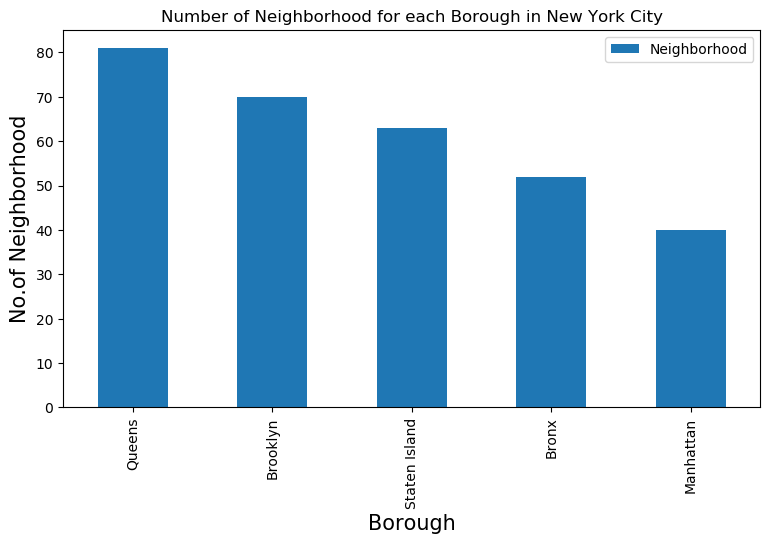

In [43]:
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('Number of Neighborhood for each Borough in New York City')
#On x-axis
plt.xlabel('Borough', fontsize = 15)
#On y-axis
plt.ylabel('No.of Neighborhood', fontsize=15)
#giving a bar plot
new_york_data.groupby('Borough')['Neighborhood'].count().nlargest(5).plot(kind='bar')
#legend
plt.legend()
#displays the plot
plt.show()

#### Restaurants 

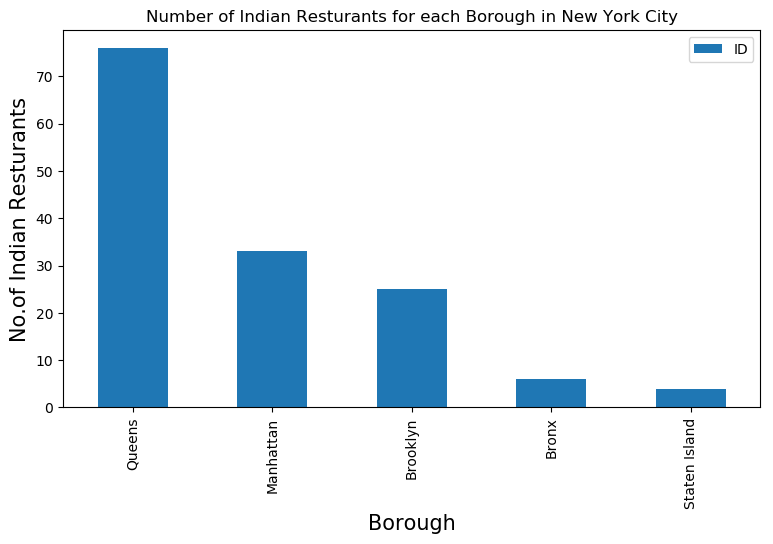

In [103]:
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('Number of Indian Resturants for each Borough in New York City')
#On x-axis
plt.xlabel('Borough', fontsize = 15)
#On y-axis
plt.ylabel('No.of Indian Resturants', fontsize=15)
#giving a bar plot
indian_rest_ny.groupby('Borough')['ID'].count().nlargest(5).plot(kind='bar')
#legend
plt.legend()
#displays the plot
plt.show()

Queens has the highest number of neighbourhoods and also the most number of Indian Restaurants

#### Population

In [116]:
nyc_data.groupby('Borough')['population'].mean()

Borough
Bronx            141169.098905
Brooklyn             48.725745
Manhattan            53.846000
Queens           154773.541246
Staten Island        24.012053
Name: population, dtype: float64

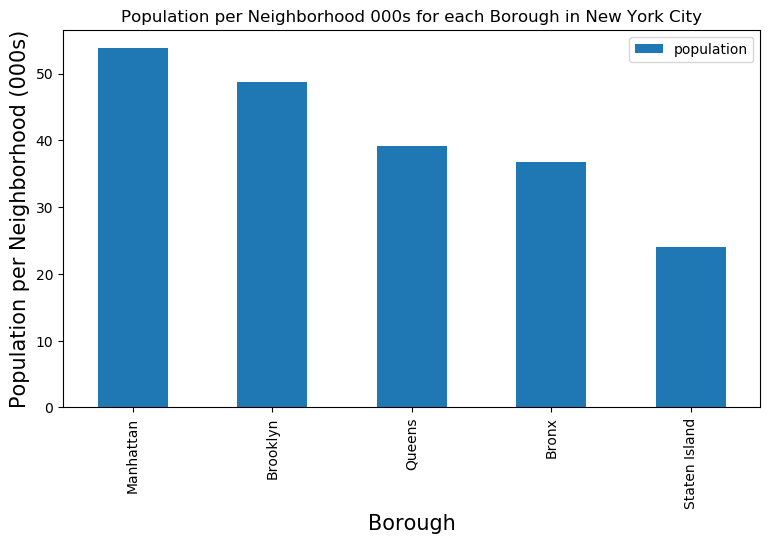

In [158]:
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('Population per Neighborhood 000s for each Borough in New York City')
#On x-axis
plt.xlabel('Borough', fontsize = 15)
#On y-axis
plt.ylabel('Population per Neighborhood (000s)', fontsize=15)
#giving a bar plot
nyc_data.groupby('Borough')['population'].mean().nlargest(5).plot(kind='bar')
#legend
plt.legend()
#displays the plot
plt.show()

There are potential in Manhantten and Brooklyn as its population is relatively much higher than other boroughs but the number of indian restaurants is much lower. Assuming that the demographic diversity within each borough is the same, there is potential to open more Indian Restaurants in Manhanttan and Brooklyn. A more detailed analysis with current data would be to find out the restaurant intensity. 

### Neighbourhood Level 

#### Restaurants

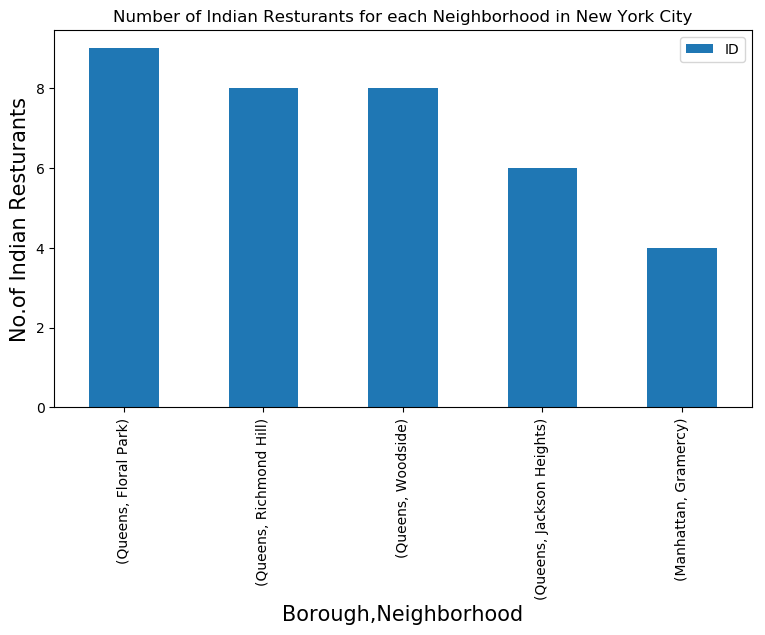

In [47]:
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('Number of Indian Resturants for each Neighborhood in New York City')
#On x-axis
plt.xlabel('Neighborhood', fontsize = 15)
#On y-axis
plt.ylabel('No.of Indian Resturants', fontsize=15)
#giving a bar plot
indian_rest_ny.groupby(['Borough', 'Neighborhood'])['ID'].count().nlargest(5).plot(kind='bar')
#legend
plt.legend()
#displays the plot
plt.show()

#### Population 

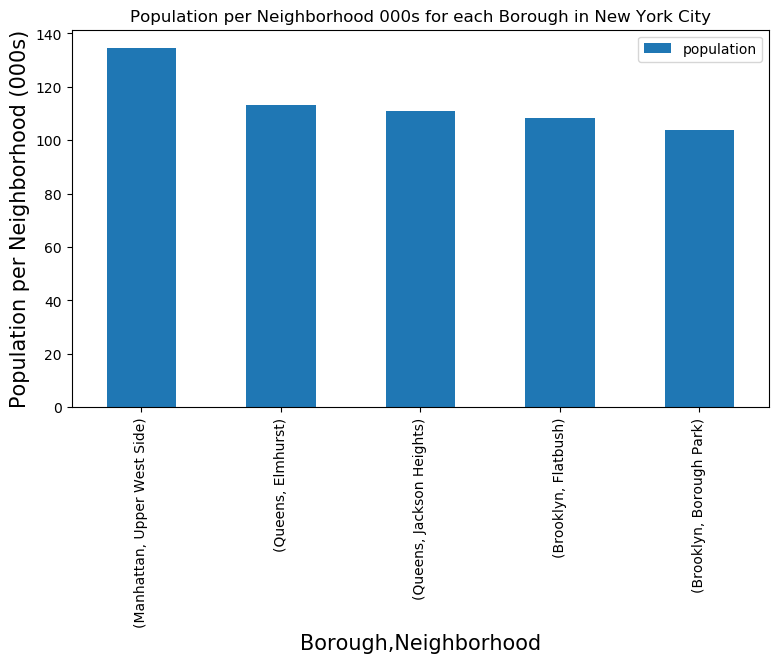

In [159]:
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('Population per Neighborhood 000s for each Borough in New York City')
#On x-axis
plt.xlabel('Borough', fontsize = 15)
#On y-axis
plt.ylabel('Population per Neighborhood (000s)', fontsize=15)
#giving a bar plot
nyc_data.groupby(['Borough', 'Neighborhood'])['population'].mean().nlargest(5).plot(kind='bar')
#legend
plt.legend()
#displays the plot
plt.show()

Upper West Side in Manhanttan, Flatbush and Borough Park from Brooklyn has high average residents from 2000 to 2010

### Map 

In [109]:
address = 'New York City, United States'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of New York City Canada are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of New York City Canada are 40.7127281, -74.0060152.


In [110]:
# create map of Toronto using latitude and longitude values, with neighborhoods superimposed
new_york_map = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, borough, neighborhood in zip(new_york_data['Latitude'], new_york_data['Longitude'], new_york_data['Borough'], new_york_data['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=6,
        popup=label,
        color='red',
        fill=True,
        fill_color='green',
        fill_opacity=0.5,
        parse_html=False).add_to(new_york_map)

new_york_map

### Map of Recommended Area (Manhattan, Brooklyn) 

In [111]:
new_york_data_focused = new_york_data[(new_york_data['Borough'] == 'Manhanttan') | (new_york_data['Borough'] == 'Brooklyn')]

In [113]:
# create map of Toronto using latitude and longitude values, with neighborhoods superimposed
new_york_map_focused = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, borough, neighborhood in zip(new_york_data_focused['Latitude'], new_york_data_focused['Longitude'], new_york_data_focused['Borough'], new_york_data_focused['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=6,
        popup=label,
        color='orange',
        fill=True,
        fill_color='yellow',
        fill_opacity=0.5,
        parse_html=False).add_to(new_york_map_focused)

new_york_map_focused

## Data Analytics

### Getting the density by Borough

In [145]:
nyc_data_with_rest = pd.merge(nyc_data, indian_rest_ny_count)
nyc_data_with_rest_borough = nyc_data_with_rest.groupby('Borough').agg({'population':'sum', 'num_rest':'mean'}).reset_index()
nyc_data_with_rest_borough['density'] = nyc_data_with_rest_borough['num_rest']/nyc_data_with_rest_borough['population']
nyc_data_with_rest_borough.sort_values(by='density')

,Borough,population,num_rest,density
0,Bronx,2717.758,7,0.002576
1,Brooklyn,4970.026,25,0.005030
4,Staten Island,912.458,7,0.007672
2,Manhattan,3123.068,33,0.010567
3,Queens,4460.101,75,0.016816


Hence,there are fewer Indian restaurants per capita and suggests more opportunities to open more Indian Restaurants for Manhanttan and Brooklyn. It is also likely these area has lower density of Indian Restaurants not owing to residents not liking Indian restaurants because there are already a significant number of Indian restaurants. 

### Getting the density by Neighborhood

In [146]:
nyc_data_with_rest_neigh = nyc_data_with_rest.groupby(['Borough', 'Neighborhood']).agg({'population':'sum', 'num_rest':'mean'}).reset_index()
nyc_data_with_rest_neigh['density'] = nyc_data_with_rest_neigh['num_rest']/nyc_data_with_rest_neigh['population']
nyc_data_with_rest_neigh.sort_values(by='density').head()

,Borough,Neighborhood,population,num_rest,density
49,Bronx,Soundview,175.210,7,0.039952
16,Bronx,East Concourse,121.245,7,0.057734
61,Bronx,Williamsbridge,118.741,7,0.058952
2,Bronx,Bedford Park,109.744,7,0.063785
53,Bronx,University Heights,108.523,7,0.064502


### Getting the Neighborhood in Manhattan and Brooklyn

In [147]:
nyc_data_with_rest_filter = nyc_data_with_rest_neigh[(nyc_data_with_rest['Borough'] == 'Manhattan') | (nyc_data_with_rest['Borough'] == 'Brooklyn')]
nyc_data_with_rest_filter.sort_values(by='density').head()

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if __name__ == '__main__':


,Borough,Neighborhood,population,num_rest,density
311,Staten Island,Great Kills,82.400,7,0.084951
101,Brooklyn,Flatbush,216.679,25,0.115378
191,Manhattan,Upper West Side,269.332,33,0.122525
289,Staten Island,Annadale,54.146,7,0.129280
290,Staten Island,Arden Heights,50.234,7,0.139348


From a density view, it seems that Brooklyn could offer more good Neighborhood locations that could welcome more Indian Restaurants

### Getting the population growth by Neighborhood

In [148]:
nyc_data_with_rest['pop_growth'] = nyc_data_with_rest.groupby('Borough')['population'].diff()
nyc_data_with_rest_neigh_growth = nyc_data_with_rest.groupby(['Borough', 'Neighborhood'])['pop_growth'].mean().reset_index().sort_values(by='pop_growth', ascending=False) 
nyc_data_with_rest_neigh_growth.head()

,Borough,Neighborhood,pop_growth
73,Brooklyn,Borough Park,38.2130
81,Brooklyn,Canarsie,35.1695
240,Queens,Jackson Heights,31.5265
276,Queens,South Ozone Park,27.2510
49,Bronx,Soundview,25.7275


Specific neighborhoods are seeing more residents growth from 2000 to 2010 especially in Brooklyn and for Bronx (Soundview and Van Cortlandt Village)

### Encoding the location by neighborhood

In [45]:
nyc_venues_grouped = nyc_onehot.groupby('Neighbourhood').mean().reset_index()
nyc_venues_grouped.head()

,Neighbourhood,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Amphitheater,Animal Shelter,Antique Shop,Aquarium,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Basketball Stadium,Bath House,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Border Crossing,Botanical Garden,Boutique,Bowling Alley,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Buffet,Building,Burger Joint,Burmese Restaurant,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Cambodian Restaurant,Camera Store,Campground,Candy Store,Cantonese Restaurant,Car Wash,Caribbean Restaurant,Caucasian Restaurant,Check Cashing Service,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Basketball Court,College Cafeteria,College Gym,College Stadium,College Theater,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cruise,Cuban Restaurant,Cultural Center,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dosa Place,Drugstore,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Egyptian Restaurant,Electronics Store,Elementary School,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Event Service,Event Space,Exhibit,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Film Studio,Financial or Legal Service,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,General Travel,German Restaurant,Gift Shop,Gluten-free Restaurant,Go Kart Track,Golf Course,Golf Driving Range,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Halal Restaurant,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Himalayan Restaurant,Historic Site,History Museum,Hobby Shop,Hockey Field,Hockey Rink,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Indoor Play Area,Insurance Office,Intersection,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Kofte Place,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Laundromat,Laundry Service,Lawyer,Lebanese Restaurant,Library,Lighthouse,Lingerie Store,Liquor Store,Locksmith,Lounge,Mac & Cheese Joint,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Medical Supply Store,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Middle School,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern G

In [48]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [49]:

# create columns according to number of top venues
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

columns = ['Neighbourhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighbourhood'] = nyc_venues_grouped['Neighbourhood']

for ind in np.arange(nyc_venues_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(nyc_venues_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.shape

(294, 11)

### Getting the top 10 venue for neighborhood

In [51]:
neighborhoods_venues_sorted.head()

,Neighbourhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Allerton,Pizza Place,Donut Shop,Fried Chicken Joint,Caribbean Restaurant,Fast Food Restaurant,Sandwich Place,Pharmacy,Convenience Store,Supermarket,Bus Station
1,Annadale,Restaurant,Trail,American Restaurant,Pizza Place,Pharmacy,Diner,Business Service,Sports Bar,Food,Train Station
2,Arden Heights,Park,Bank,Dog Run,Pizza Place,Sandwich Place,Liquor Store,Pharmacy,Spa,Coffee Shop,Trail
3,Arlington,Bus Stop,Boat or Ferry,Hardware Store,Nightlife Spot,Automotive Shop,Department Store,Discount Store,Donut Shop,Convenience Store,Comic Shop
4,Arrochar,Beach,Italian Restaurant,Baseball Field,Bus Stop,Polish Restaurant,Middle Eastern Restaurant,Supermarket,Mediterranean Restaurant,Bagel Shop,Historic Site


In [174]:
restaurant_freqs = list()

for i in range(len(neighborhoods_venues_sorted)):
    restaurant_freq = neighborhoods_venues_sorted.iloc[i].str.contains("Restaurant").sum()/10
    restaurant_freqs.append(restaurant_freq)
    
neighborhoods_venues_sorted['rest_freq'] = restaurant_freqs
neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,rest_freq
0,Allerton,Pizza Place,Donut Shop,Fried Chicken Joint,Caribbean Restaurant,Fast Food Restaurant,Sandwich Place,Pharmacy,Convenience Store,Supermarket,Bus Station,0.2
1,Annadale,Restaurant,Trail,American Restaurant,Pizza Place,Pharmacy,Diner,Business Service,Sports Bar,Food,Train Station,0.2
2,Arden Heights,Park,Bank,Dog Run,Pizza Place,Sandwich Place,Liquor Store,Pharmacy,Spa,Coffee Shop,Trail,0.0
3,Arlington,Bus Stop,Boat or Ferry,Hardware Store,Nightlife Spot,Automotive Shop,Department Store,Discount Store,Donut Shop,Convenience Store,Comic Shop,0.0
4,Arrochar,Beach,Italian Restaurant,Baseball Field,Bus Stop,Polish Restaurant,Middle Eastern Restaurant,Supermarket,Mediterranean Restaurant,Bagel Shop,Historic Site,0.4


In [175]:
neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,rest_freq
0,Allerton,Pizza Place,Donut Shop,Fried Chicken Joint,Caribbean Restaurant,Fast Food Restaurant,Sandwich Place,Pharmacy,Convenience Store,Supermarket,Bus Station,0.2
1,Annadale,Restaurant,Trail,American Restaurant,Pizza Place,Pharmacy,Diner,Business Service,Sports Bar,Food,Train Station,0.2
2,Arden Heights,Park,Bank,Dog Run,Pizza Place,Sandwich Place,Liquor Store,Pharmacy,Spa,Coffee Shop,Trail,0.0
3,Arlington,Bus Stop,Boat or Ferry,Hardware Store,Nightlife Spot,Automotive Shop,Department Store,Discount Store,Donut Shop,Convenience Store,Comic Shop,0.0
4,Arrochar,Beach,Italian Restaurant,Baseball Field,Bus Stop,Polish Restaurant,Middle Eastern Restaurant,Supermarket,Mediterranean Restaurant,Bagel Shop,Historic Site,0.4


In [101]:
neighborhoods_venues_sorted = neighborhoods_venues_sorted.rename(columns={'Neighbourhood':'Neighborhood'})
new_york_data_restaurant_pop = pd.merge(neighborhoods_venues_sorted, new_york_data, how='left', on='Neighborhood')
new_york_data_restaurant_pop = new_york_data_restaurant_pop.drop_duplicates(subset=['Neighborhood'])
print(new_york_data_restaurant_pop.shape)
new_york_data_restaurant_pop.head()

(294, 15)


,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,rest_freq,Borough,Latitude,Longitude
0,Allerton,Pizza Place,Donut Shop,Fried Chicken Joint,Caribbean Restaurant,Fast Food Restaurant,Sandwich Place,Pharmacy,Convenience Store,Supermarket,Bus Station,0.2,Bronx,40.865788,-73.859319
1,Annadale,Restaurant,Trail,American Restaurant,Pizza Place,Pharmacy,Diner,Business Service,Sports Bar,Food,Train Station,0.2,Staten Island,40.538114,-74.178549
2,Arden Heights,Park,Bank,Dog Run,Pizza Place,Sandwich Place,Liquor Store,Pharmacy,Spa,Coffee Shop,Trail,0.0,Staten Island,40.549286,-74.185887
3,Arlington,Bus Stop,Boat or Ferry,Hardware Store,Nightlife Spot,Automotive Shop,Department Store,Discount Store,Donut Shop,Convenience Store,Comic Shop,0.0,Staten Island,40.635325,-74.165104
4,Arrochar,Beach,Italian Restaurant,Baseball Field,Bus Stop,Polish Restaurant,Middle Eastern Restaurant,Supermarket,Mediterranean Restaurant,Bagel Shop,Historic Site,0.4,Staten Island,40.596313,-74.067124


# Results and Discussion <a name="results"></a>

## Scoring of Favorable Locations to open Indian Restaurant 

In [170]:
from sklearn.preprocessing import MinMaxScaler

nyc_final_recom = pd.merge(nyc_data_with_rest_borough, nyc_data_with_rest_neigh_growth)
nyc_final_recom = pd.merge(nyc_final_recom, new_york_data_restaurant_pop) 
nyc_final_recom_metrics = nyc_final_recom[['density', 'pop_growth', 'rest_freq']] 

scaler = MinMaxScaler()
scaler.fit(nyc_final_recom_metrics)

nyc_final_recom_metrics = pd.DataFrame(scaler.transform(nyc_final_recom_metrics), columns=['density', 'pop_growth', 'rest_freq'])

nyc_final_recom_metrics['density'] = 1 - nyc_final_recom_metrics['density'] 
nyc_final_recom[['density_transformed', 'pop_growth_transformed', 'rest_freq_transformed']] = nyc_final_recom_metrics
nyc_final_recom['overall_rating'] = nyc_final_recom[['density_transformed', 'pop_growth_transformed', 'rest_freq_transformed']].mean(axis=1)

nyc_final_recom.sort_values('overall_rating',ascending=False).head()

,Borough,population,num_rest,density,Neighborhood,pop_growth,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,rest_freq,Latitude,Longitude,Cluster Labels,density_transformed,pop_growth_transformed,rest_freq_transformed,overall_rating
26,Bronx,2717.758,7,0.002576,City Island,NaN,Harbor / Marina,Seafood Restaurant,Italian Restaurant,Deli / Bodega,Bar,American Restaurant,French Restaurant,Bank,Baseball Field,Thrift / Vintage Store,0.4,40.847247,-73.786488,1,1.000000,NaN,0.666667,0.833333
34,Bronx,2717.758,7,0.002576,Edgewater Park,NaN,Italian Restaurant,Pizza Place,Deli / Bodega,Bar,Donut Shop,Spa,Diner,Latin American Restaurant,Sushi Restaurant,Asian Restaurant,0.4,40.821986,-73.813885,2,1.000000,NaN,0.666667,0.833333
103,Brooklyn,4970.026,25,0.005030,Manhattan Beach,NaN,Italian Restaurant,Turkish Restaurant,Café,Eastern European Restaurant,Dessert Shop,Seafood Restaurant,Sandwich Place,Bar,Russian Restaurant,Bus Stop,0.5,40.577914,-73.943537,1,0.827635,NaN,0.833333,0.830484
96,Brooklyn,4970.026,25,0.005030,Ditmas Park,NaN,Caribbean Restaurant,Mexican Restaurant,Pizza Place,Coffee Shop,Grocery Store,Bar,Thai Restaurant,Indian Restaurant,Mobile Phone Shop,Latin American Restaurant,0.5,40.643675,-73.961013,1,0.827635,NaN,0.833333,0.830484
2,Bronx,2717.758,7,0.002576,Schuylerville,8.792,Pizza Place,Italian Restaurant,Diner,American Restaurant,Donut Shop,Pharmacy,Supermarket,Mexican Restaurant,Sandwich Place,Latin American Restaurant,0.4,40.826580,-73.826203,2,1.000000,0.620448,0.666667,0.762371


It can be seen that Brooklyn and Bronx are favorable locations on average scoring well on having high popularity of restaurant within these neighborhoods, high population growth and low number of restaurants per capita. 

## Recommending hot spots to open Indian Restaurants by Clustering

In [127]:
# import k-means from clustering stage
from sklearn.cluster import KMeans

Sum_of_squared_distances = []
K = range(1,10)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(nyc_venues_grouped_clustering)
    Sum_of_squared_distances.append(km.inertia_)

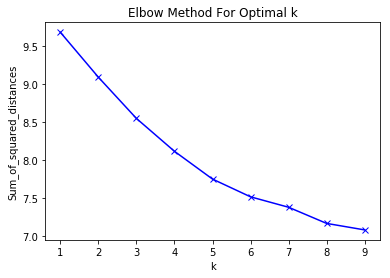

In [129]:
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

When k=5, there is a decline in the SSE. So the elbow is at k=5 and would be the clusters to use 

In [130]:
# Run k-means to cluster the neighborhood into 5 clusters  
# set number of clusters
kclusters = 5

nyc_venues_grouped_clustering = nyc_venues_grouped.drop('Neighbourhood', 1)
# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=1).fit(nyc_venues_grouped_clustering)

# check cluster labels generated for each row in the dataframe
print(kmeans.labels_[0:20])
print(len(kmeans.labels_))

[4 2 2 1 2 0 1 2 2 2 1 1 2 2 1 4 2 1 2 2]
294


In [131]:
new_york_data_restaurant_pop.shape

(294, 16)

In [132]:
# add clustering labels
new_york_data_restaurant_pop['Cluster Labels'] = kmeans.labels_

new_york_data_restaurant_pop.head() # check the last columns!

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,rest_freq,Borough,Latitude,Longitude,Cluster Labels
0,Allerton,Pizza Place,Donut Shop,Fried Chicken Joint,Caribbean Restaurant,Fast Food Restaurant,Sandwich Place,Pharmacy,Convenience Store,Supermarket,Bus Station,0.2,Bronx,40.865788,-73.859319,4
1,Annadale,Restaurant,Trail,American Restaurant,Pizza Place,Pharmacy,Diner,Business Service,Sports Bar,Food,Train Station,0.2,Staten Island,40.538114,-74.178549,2
2,Arden Heights,Park,Bank,Dog Run,Pizza Place,Sandwich Place,Liquor Store,Pharmacy,Spa,Coffee Shop,Trail,0.0,Staten Island,40.549286,-74.185887,2
3,Arlington,Bus Stop,Boat or Ferry,Hardware Store,Nightlife Spot,Automotive Shop,Department Store,Discount Store,Donut Shop,Convenience Store,Comic Shop,0.0,Staten Island,40.635325,-74.165104,1
4,Arrochar,Beach,Italian Restaurant,Baseball Field,Bus Stop,Polish Restaurant,Middle Eastern Restaurant,Supermarket,Mediterranean Restaurant,Bagel Shop,Historic Site,0.4,Staten Island,40.596313,-74.067124,2


In [176]:
# create map
clusters_map = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(new_york_data_restaurant_pop['Latitude'], new_york_data_restaurant_pop['Longitude'], new_york_data_restaurant_pop['Neighborhood'],kmeans.labels_):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.5).add_to(clusters_map)
       
clusters_map

In [172]:
nyc_final_recom.groupby('Cluster Labels')['overall_rating'].mean().sort_values(ascending=False)

Cluster Labels
3    0.571071
4    0.520260
1    0.505841
2    0.437170
0    0.255547
Name: overall_rating, dtype: float64

The top cluster number 3 is in the area of Manhattan and Brooklyn and a bit further up which is Bronx. This coincides with the conclusions derived from the visualizations

### Results and Discussion Summary 

Our analysis shows that although there is a great number of restaurants in New York City. There are pockets of low restaurant density in Manhattan and Brooklyn. The good locations are mainly centered around the Upper New York Bay Area. Neighborhoods within Brooklyn and Bronx has a high population growth while also having a low restaurant density. There is definitely a huge potential to open more Indian restaurant in these metropolitan Boroughs and Neighborhoods. Moreover, the restaurants analyzed are all within a 1km distance from the Borough center. The locations were also clustered to create zones of interest which contain greatest number of location candidates. The emphasis is that the clusters are pretty close to one another with cluster 3 and 4 more centered. 

Neighborhoods have all been ranked based on an overall rating that combines the critiera from restaurant density, population growth and restaurant popularity. This, of course, does not imply that those zones are actually optimal locations for a new restaurant! Purpose of this analysis was to only provide info on areas in New York City that are potentially great for opening a new Indian Restaurant but not crowded with existing restaurants (particularly Indian) - it is entirely possible that there is a very good reason for small number of restaurants in any of those areas, reasons which would make them unsuitable for a new restaurant regardless of lack of competition in the area. Recommended zones should therefore be considered only as a starting point for more detailed analysis which could eventually result in location which has not only no nearby competition but also other factors taken into account and all other relevant conditions met.

The analysis could be more extended to include more granular details of demographic variety in each Neighborhoods or the tourists that are visiting the neighborhoods to complement the location-based analysis that is conducted during this research. 

# Conclusion <a name="conclusion"></a>

Purpose of this project was to identify New York City areas close to center with low number of restaurants (particularly Indian restaurants) in order to aid businesses in narrowing down the search for optimal location for a new Indian restaurant. By calculating restaurant density distribution from Foursquare data we have first identified general boroughs and neighborhoods that justify further analysis, and then generated extensive collection of locations which satisfy some basic requirements regarding existing nearby restaurants. The analysis has shown that there are more potential to start an Indian Restaurant in Manhattan, Brooklyn and Bronx. These locations have high population growth and high concentration of Restaurants but low Indian Restaurant penetration.

Clustering of those locations was then performed in order to create major zones of interest (containing greatest number of potential locations) and addresses of those zone centers were created to be used as starting points for final exploration by stakeholders.  Out of the 5 clusters examined, cluster 3 and 4 are aligned with areas in Manhattan and Brookyln. Specifc Neighborhoods include Manhattan Beach and Schuylerville that have been ranked highly across the criteria. 

Final decission on optimal restaurant location will be made by bussinesses based on specific characteristics of neighborhoods and locations in every recommended zone, taking into consideration additional factors like attractiveness of each location (proximity to park or water), levels of noise / proximity to major roads, real estate availability, prices, social and economic dynamics of every neighborhood etc.